In [1]:
# Vizuelna podešavanja okruženja (samo razvuče notebook na širinu ekrana)
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
!pip install pymysql
import pandas as pd
import numpy as np

Defaulting to user installation because normal site-packages is not writeable


In [5]:


#ucitavanje podataka
file='nekretnineProjekat/Nekretnine/output.json'
df=pd.read_json(file)
#f.fillna(pymysql.NULL, inplace=True)
df.fillna(np.nan, inplace=True)
df2=df.dropna(subset=['Cena','Kvadratura'])
mask=df2['Cena']==''
df2=df2[~mask]
df=df2
df.replace(np.nan,None,inplace=True)

pd.set_option('display.max_rows', 20)

print(df)



      Tip_ponude Tip_nekretnine Broj soba Cena Cena_kvadrat  Kvadratura Sprat  \
0      Izdavanje        Stanovi      None  300         None        62.0     2   
1      Izdavanje        Stanovi      None  800         None        25.0  None   
2      Izdavanje        Stanovi      None  380         None        39.0     3   
3      Izdavanje        Stanovi      None  900         None        45.0     5   
4      Izdavanje        Stanovi      None  300         None        62.0     2   
...          ...            ...       ...  ...          ...         ...   ...   
11165  Izdavanje        Stanovi      None  700         None        72.0  None   
11166  Izdavanje        Stanovi      None  300         None        35.0     3   
11167  Izdavanje        Stanovi      None  350         None        44.0     1   
11168  Izdavanje        Stanovi      None  250         None        26.0     3   
11169  Izdavanje        Stanovi      None  600         None        40.0     2   

      Spratnost  Uknjizeno 

In [1]:
import pymysql
connection = pymysql.connect(
    host="localhost",
    user="root",
    password="",
    database="nekretnine",
     autocommit=True
)
cursor = connection.cursor()


for _, row in df.iterrows():
    column_names = ', '.join(f"`{column}`" for column in df.columns)
    values = tuple(row[column] for column in df.columns)
    values_str = ', '.join("'" + value.replace("'", "''") + "'" if isinstance(value,str) else str(value) if value is not
                           None else pymysql.NULL for value in values)
    
    query = f"INSERT INTO nekretnine ({column_names}) VALUES ({values_str})"
    print(query)
    cursor.execute(query)
    
    
    

OperationalError: (2003, "Can't connect to MySQL server on 'localhost' ([WinError 10061] No connection could be made because the target machine actively refused it)")

In [2]:
def insertDf(dataFrame,table):
   
  
    connection = pymysql.connect(
    host="localhost",
    user="root",
    password="",
    database="nekretnine",
    autocommit=True
    )
    cursor = connection.cursor()
    

    for _, row in dataFrame.iterrows():
        column_names = ', '.join(f"`{column}`" for column in dataFrame.columns)
        values = tuple(row[column] for column in dataFrame.columns)
        values_str = ', '.join("'" + value.replace("'", "''") + "'" if isinstance(value,str) else str(value) if value is not
                               None else pymysql.NULL for value in values)

        query = f"INSERT INTO {table} ({column_names}) VALUES ({values_str})"
        print(query)
        cursor.execute(query)
    
    

In [10]:
#ciscenje podataka
df2=executeUpdate('update  nekretnine set Grad=Trim(Grad)')
df2=executeUpdate('update  nekretnine set `Deo grada`=Trim(`Deo grada`)')
df2=executeQuery('select * from nekretnine')

df2.replace(np.nan,None,inplace=True)
dfStanovi=df2[df2['Tip_nekretnine']=='Stanovi']
dfStanovi.dropna(subset=['Sprat','Ukupan broj soba'],inplace=True)
sprat=dfStanovi['Sprat']==None
dfStanovi=dfStanovi[~sprat]
dfKuce=df2[df2['Tip_nekretnine']=='Kuće']
dfKuce['Ukupan broj soba'] = dfKuce['Broj soba']

dfKuce.drop('Broj soba',axis=1,inplace=True)
dfCist=dfStanovi.append(dfKuce)
dfCist.drop('Broj soba',axis=1,inplace=True)


nemaCene = dfCist['Cena'] == None
cena0=dfCist['Cena'] == 0
cena1=dfCist['Cena'] == 1
cena=nemaCene | cena0 | cena1
#sprat= dfCist['Sprat'] == None
#kombinovano=cena | sprat
dfCist = dfCist[~cena]



dfCist.drop('idnekretnine', axis=1, inplace=True)
dfCist['Ukupan broj soba'].replace({'Više od pet soba': 6}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Petoiposoban': 5.5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Petosoban': 5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Četvoroiposoban': 4.5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Četvorosoban': 4}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Troiposoban': 3.5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Trosoban': 3}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Dvoiposoban': 2.5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Dvosoban': 2}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Jednoiposoban': 1.5}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Jednosoban': 1}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Garsonjera': 1}, inplace=True)

dfCist['Ukupan broj soba'].replace({'Četiri sobe': 4}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Tri sobe': 3}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Dve sobe': 2}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Jedna soba': 4}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Pet i više soba': 6}, inplace=True)
dfCist['Ukupan broj soba'].replace({'Jedna soba': 1}, inplace=True)
dfCist['Ukupan broj soba'].replace({np.nan: 0}, inplace=True)

print(dfCist)

insertDf(dfCist,'nekretnineprecisceno')

C:\Users\stefa\AppData\Local\Temp\ipykernel_18556\1966891159.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfStanovi.dropna(subset=['Sprat','Ukupan broj soba'],inplace=True)
C:\Users\stefa\AppData\Local\Temp\ipykernel_18556\1966891159.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfKuce['Ukupan broj soba'] = dfKuce['Broj soba']
C:\Users\stefa\AppData\Local\Temp\ipykernel_18556\1966891159.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pa

     Tip_nekretnine Tip_ponude    Cena Cena_kvadrat  Kvadratura      Sprat  \
8671        Stanovi    Prodaja  155000        2.348          66          4   
8672        Stanovi    Prodaja  429000        3.698         116          1   
8673        Stanovi    Prodaja   72000          2.0          36          3   
8674        Stanovi    Prodaja  105000        2.234          47          2   
8675        Stanovi    Prodaja   99870          3.0          33  Prizemlje   
...             ...        ...     ...          ...         ...        ...   
8666           Kuće    Prodaja   29500        173.0         171   Prizemna   
8667           Kuće    Prodaja   69000        373.0         185       None   
8668           Kuće    Prodaja  159000        468.0         340       None   
8669           Kuće    Prodaja  310000        1.047         296       None   
8670           Kuće    Prodaja   95000        432.0         220       None   

     Spratnost  Uknjizeno   Grejanje  Ukupan broj soba  ... Bro

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 103000, 1.981, 52, 'Prizemlje', NULL, 1, 'Gas', 2.5, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep', NULL, 0, 0, 'https://sasomange.rs//p/134663732/novi-sad-telep-52-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 82400, 1.471, 56, '1', NULL, 1, NULL, 2.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 36050, 501.0, 72, 'Prizemlje', NULL, 1, 'Peć na čvrsto gorivo', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Futog', NULL, 1, 0, 'https://sasomange.rs//p/141864007/dvorisni-stan-povoljno-021-221')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 72000, 2.0, 36, '3', '4', 1, 'Etažno', 1.5, NULL, 1.0, 'Starogradnja', NULL, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 200000, 2.439, 82, '1', '4', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Bežanijska kosa 1', NULL, 0, 1, 'https://sasomange.rs//p/138551841/partizanske-avijacije-bezanijska-kosa-1')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 84460, 3.128, 27, '5', NULL, 1, 'Centralno', 1.0, NULL, NULL, NULL, NULL, 'Novi S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 175100, 1.824, 96, '5', '5', 1, 'Centralno', 4.5, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Liman 3', NULL, 0, 1, 'https://sasomange.rs//p/134658826/petosoban-duplex-na-limanu-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 90000, 1.385, 65, 'Prizemlje', '3', 1, 'Gas', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 31600, 1.374, 23, 'Suteren', NULL, 0, 'TA peć', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Batajnica', NULL, 0, 0, 'https://sasomange.rs//p/142029303/batajnica-garsonjera-povrsine-23m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 56550, 1.45, 39, 'Prizemlje', NULL, 0, 'Gas', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Kragujevac', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 240000, 3.429, 70, '4', '5', 1, NULL, 3.5, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Lekino brdo', NULL, 0, 1, 'https://sasomange.rs//p/138549244/lekino-brdo-70m2-iv-podno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 120000, 3.243, 37, '2', '4', 1, 'TA peć', 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 130000, 2.889, 45, 'Visoko prizemlje', '17', 1, 'Centralno', 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 62', NULL, 0, 1, 'https://sasomange.rs//p/137211352/izuzetna-lokacija-polozaj-raspored-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 110000, 2.973, 37, 'Visoko prizemlje', '17', 1, 'Centralno', 1.5, NULL, 1.0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 96426, 2.2, 44, '1', NULL, 0, NULL, 2.0, NULL, NULL, 'Novogradnja', NULL, 'Niš', 'Medijana', ' Bulevar Nemanjića', NULL, 1, 1, 'https://sasomange.rs//p/118600575/stan-s8-b-43-83m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 65000, 1.512, 43, '1', '2', 1, 'TA peć', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Kotež', NULL, 0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 152000, 2.576, 59, '5', '5', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Novi Sad', 'Opština Novi Sad', ' Bulevar Oslobođenja', NULL, 0, 1, 'https://sasomange.rs//p/138544165/novi-sad-bulevar-uknjizen-dvoiposoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 34000, 756.0, 45, '4', '4', 0, 'TA peć', 2.0, NULL, 1.0, NULL, N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 59000, 1.054, 56, '11', '13', 1, 'Centralno', 2.0, NULL, NULL, NULL, NULL, 'Zrenjanin', 'Lokacije u gradu', ' Bagljaš', NULL, 0, 1, 'https://sasomange.rs//p/120741153/dvosoban-stan-na-prodaju-junaka')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 90000, 1.233, 73, '4', '5', 1, 'Centralno', 3.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Zrenjan

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 371300, 3.201, 116, '5', NULL, 0, 'Gas', 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Salajka', NULL, 0, 1, 'https://sasomange.rs//p/118689906/stan-novi-sad-salajka')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 201000, 2.577, 78, '4', NULL, 1, 'Centralno', 3.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 118450, 2.575, 46, '5', '5', 1, NULL, 2.5, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Novo Naselje', NULL, 0, 0, 'https://sasomange.rs//p/141856899/za-sve-detalje-slobodno-pozovite')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 82400, 2.841, 29, 'Visoko prizemlje', '3', 1, NULL, 1.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 44000, 1.158, 38, '2', '3', 1, 'Etažno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Vrnjačka Banja', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140024646/stan-na-prodaju')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 276000, 2.464, 112, '5', NULL, 0, 'Centralno', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 278820, 2.998, 93, '2', '4', 0, 'Toplotne pumpe', 4.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/137197153/lux-4-0-soban-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 130000, 1.831, 71, '3', '3', 0, NULL, 3.0, NULL, NULL, 'Novogradnja', NULL, 'Pančevo', 'Lokacije u gradu', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 109850, 2.497, 44, '4', '4', 1, 'Gas', 2.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep', NULL, 0, 1, 'https://sasomange.rs//p/141856829/odlican-kvalitet-gradnje-pouzdanog-investitora')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 177100, 2.46, 72, '4', '5', 1, 'Gas', 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 63500, 858.0, 74, '5', NULL, 1, 'Centralno', 4.0, NULL, NULL, NULL, NULL, 'Niš', 'Pantelej', ' Pantelej', NULL, 0, 0, 'https://sasomange.rs//p/117730550/cetvorosoban-pantelej-povoljno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 65000, 942.0, 69, '9', NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Niš', 'Medijana', ' Bulevar Nemanjića', NULL, 0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 195700, 2.645, 74, '1', NULL, 1, 'Centralno', 3.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Nova Detelinara', NULL, 0, 0, 'https://sasomange.rs//p/126708389/novi-sad-nova-detelinara-74')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 83650, 1.945, 43, '2', NULL, 0, 'Gas', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 145230, 3.09, 47, '2', NULL, 1, 'Centralno', 2.5, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 0, 0, 'https://sasomange.rs//p/114971056/novi-sad-podbara-47-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 78300, 1.35, 58, '5', '5', 1, 'Gas', 2.5, NULL, NULL, 'Novogradnja', NULL, 'Stara Pazova', 'Lokacije u 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 101000, 2.349, 43, '2', NULL, 1, 'Centralno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Nova Detelinara', NULL, 0, 0, 'https://sasomange.rs//p/133440612/novi-sad-nova-detelinara-43')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 164990, 2.538, 65, '7', NULL, 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 85050, 2.06, 41, '2', NULL, 1, 'Gas', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 0, 'https://sasomange.rs//p/134630071/novi-sad-petrovaradin-41-28')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 46500, 1.75, 27, '2', NULL, 1, 'Etažno', 1.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 137000, 2.74, 50, '1', '9', 0, 'Centralno', 1.5, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 63', NULL, 0, 1, 'https://sasomange.rs//p/138519520/lep-jednoiposoban-stan-izuzetnog-rasporeda')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 115800, 2.517, 46, 'Prizemlje', '5', 1, 'Norveški radijatori', 2.5, NULL, NULL, 'Starogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 207000, 2.797, 74, '3', '5', 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Hadžipopovac', NULL, 0, 0, 'https://sasomange.rs//p/134633044/profesorska-kolonija-74m2-iii-ta')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 150000, 1.724, 87, '4', '4', 1, NULL, 3.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Kan

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92400, 2.369, 39, '4', NULL, 1, 'Centralno', 2.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Nova Detelinara', NULL, 0, 1, 'https://sasomange.rs//p/140102070/nova-detelinara-39-m-92')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 108150, 2.575, 42, '4', NULL, 1, 'Centralno', 2.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Opština Novi Sad'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 325000, 2.462, 132, '3', '4', 1, 'Etažno', 4.0, NULL, 2.0, 'Starogradnja', 'Lux', 'Beograd', 'Palilula', ' Profesorska kolonija', NULL, 0, 0, 'https://sasomange.rs//p/121698562/profesorska-kolonija-cvijiceva-deljiv-salonac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 150000, 1.923, 78, '11', NULL, 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 64290, 1.55, 41, '2', NULL, 0, 'Norveški radijatori', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Zlatibor', 'Planina', ' Obudojevica', NULL, 1, 1, 'https://sasomange.rs//p/129225319/zlatibor-ulica-narcisa-obudojevica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 65800, 1.548, 43, 'Visoko prizemlje', NULL, 0, 'Norveški radijatori', 2.5, NULL, 1.0, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 77760, 1.8, 43, '2', NULL, 1, 'Etažno', 1.5, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Niš', 'Medijana', ' Duvanište', NULL, 1, 1, 'https://sasomange.rs//p/129040526/prodajem-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 114702, 1.991, 58, '2', NULL, 0, NULL, 2.5, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep', NULL, 0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 189000, 2.277, 83, '3', NULL, 0, 'Centralno', 3.5, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 62', NULL, 1, 1, 'https://sasomange.rs//p/130907471/blok-62')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 326888, 4.245, 77, '1', '15', 0, 'Centralno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 204000, 4.0, 51, '2', '4', 0, 'Centralno', 2.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/135096635/vracar-kalenic-pijaca-nevesinjska-51m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 115500, 2.625, 44, '2', NULL, 1, 'Centralno', 1.5, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 175000, 2.333, 75, 'Prizemlje', '5', 0, 'Centralno', 4.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Braće Jerković', NULL, 0, 1, 'https://sasomange.rs//p/133038398/vozdovac-brace-jerkovic-dragice-koncar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 180000, 3.529, 51, '3', '5', 0, 'Centralno', 2.0, NULL, NULL, NULL, NULL, 'Beograd', 'Čukar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 284500, 3.601, 79, '3', '3', 0, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140088255/safarikova-ulica-retko-u-ponudi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 370000, 4.512, 82, '1', '4', 0, 'Centralno', 3.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Kale

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 50700, 1.5, 34, 'Prizemlje', NULL, 0, NULL, 1.5, NULL, NULL, 'Novogradnja', NULL, 'Sokobanja', 'Lokacije u gradu', ' Banjica', NULL, 0, 0, 'https://sasomange.rs//p/137031546/ulaz-1-stan-3-jednoiposoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 90000, 1.636, 55, 'Prizemlje', '7', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 103670, 1.7, 61, '1', NULL, 0, 'Gas', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa', NULL, 0, 0, 'https://sasomange.rs//p/139845015/odlican-stan-na-klisi-mali')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 108150, 2.351, 46, '2', NULL, 1, NULL, 1.5, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Liman 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 207000, 2.797, 74, '3', '5', 1, 'TA peć', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Hadžipopovac', NULL, 1, 0, 'https://sasomange.rs//p/140081000/centar-zdravka-celara-74m2-plus')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 138600, 2.1, 66, '4', '7', 1, 'Centralno', 2.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždova

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 2950, 27.0, 108, 'Prizemlje', '4', 1, 'Centralno', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Južni bulevar', NULL, 1, 1, 'https://sasomange.rs//p/137164312/vracar-juzni-bulevar-lux-novogradnja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 2700, 27.0, 100, '3', NULL, 1, NULL, 3.0, NULL, NULL, 'Novogradnja', 'Lux', 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270000, 2.432, 111, '4', '5', 1, NULL, 3.5, NULL, NULL, NULL, NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/123588263/troiposoban-stan-na-prodaju-kajmakcalanska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 300000, 1.554, 193, '7', '7', 1, 'Centralno', 4.0, NULL, NULL, NULL, NULL, 'Beograd', 'Palilula', ' Bogos

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 217800, 2.2, 99, '3', '5', 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 0, 0, 'https://sasomange.rs//p/141857101/cetvorosoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 138000, 2.0, 69, '1', '2', 1, 'Gas', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Adamovićevo Naselje', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 82400, 2.943, 28, '3', NULL, 1, 'Etažno', 1.0, NULL, NULL, NULL, NULL, 'Čajetina', 'Lokacije u gradu', NULL, NULL, 0, 1, 'https://sasomange.rs//p/137899282/stan-zlatibor-zlatibor')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 152000, 1.9, 80, '5', '5', 1, 'Norveški radijatori', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Čajetina', 'Lokacije u gradu'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 55000, 1.447, 38, '2', '4', 1, 'Centralno', 1.0, NULL, 1.0, NULL, NULL, 'Smederevo', 'Lokacije u gradu', ' Centar', NULL, 0, 1, 'https://sasomange.rs//p/135892168/prodajem-garsonjeru-u-centru-smedereva')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 112200, 1.1, 102, '3', '3', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Stara Pazova', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 99900, 1.448, 69, '4', '6', 1, 'Gas', 2.0, NULL, NULL, 'Starogradnja', NULL, 'Stara Pazova', 'Okolna mesta', ' Nova Pazova', NULL, 0, 0, 'https://sasomange.rs//p/138920337/nova-pazova-centar-cara-dusana')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 59400, 1.1, 54, '1', '2', 1, 'Gas', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Stara Pazova', 'Lokaci

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 84000, 750.0, 112, '1', NULL, 1, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Surčin', ' Jakovo', NULL, 1, 0, 'https://sasomange.rs//p/137547711/jakovo-id-1359')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 94763, 1.692, 56, '3', '3', 0, 'Etažno', 2.5, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Surčin', ' Surčin (mes

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 88000, 2.095, 42, '4', '5', 1, NULL, 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Kanarevo brdo', NULL, 0, 0, 'https://sasomange.rs//p/136895508/rakovica-kanarevo-brdo-42m2-t?ref=SuperSasoAdBasePromotion')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 122000, 2.711, 45, '3', '7', 1, 'Centralno', 1.5, NULL, 1.0, 'Novogradnja', 'R

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 300000, 5.357, 56, '8', '17', 0, 'Centralno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/133550189/savski-venac-beograd-na-vodi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 43500, 1.012, 43, 'Polusuteren', '4', 1, 'Norveški radijatori', 1.5, NULL, 1.0, 'Novogradnja'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 128750, 2.575, 50, '2', '4', 1, 'Podno', 2.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', NULL, 0, 1, 'https://sasomange.rs//p/125080307/nov-dvosoban-stan-u-sremskoj')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 185000, 4.111, 45, '1', '2', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', NULL, 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 120000, 2.182, 55, '1', '4', 1, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Kanarevo brdo', NULL, 0, 0, 'https://sasomange.rs//p/135417973/dvosoban-stan-sa-garazom-kanarevo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 288000, 2.25, 128, '2', NULL, 1, 'Gas', 5.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 149600, 2.2, 68, '1', '4', 1, 'Etažno', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Kluz', NULL, 1, 1, 'https://sasomange.rs//p/141771233/prodaja-zvezdara-kluz-68m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 88250, 1.751, 50, '1', NULL, 1, NULL, 3.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrova

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 1400, 9.0, 149, '1', NULL, 1, 'Podno', 5.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Mišeluk', NULL, 0, 1, 'https://sasomange.rs//p/116597310/5-soban-stan-stambene-jedinice')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 97000, 2.425, 40, '2', NULL, 0, 'Gas', 2.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 129220, 1.846, 70, 'Prizemlje', NULL, 1, NULL, 4.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 0, 'https://sasomange.rs//p/141310420/novogradnja-petrovaradin')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 210000, 1.75, 120, 'Visoko prizemlje', NULL, 0, 'Centralno', 3.0, NULL, NULL, 'Starogradnja', NULL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 110000, 2.2, 50, 'Visoko prizemlje', '5', 1, 'Gas', 2.5, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/114970830/mirijevo-50m2-plus-26m2-terasa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 246500, 1.7, 145, 'Prizemlje', '2', 1, 'Etažno', 3.5, NULL, 1.0, 'Starogradnja', NULL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 360000, 3.273, 110, '4', '7', 1, NULL, 4.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 0, 'https://sasomange.rs//p/117248951/bez-provizije-za-kupca-cetvorosoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 87970, 2.317, 38, '1', '4', 0, 'Gas', 1.5, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 190000, 2.714, 70, 'Visoko prizemlje', '6', 1, 'Centralno', 2.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Zvezdara', ' Cvetkova pijaca', NULL, 0, 1, 'https://sasomange.rs//p/141310401/zvezdara-cvetkova-pijaca-koste-abrasevica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 239900, 2.999, 80, '3', '4', 0, 'Centralno', 3.0, NULL, NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 146000, 2.0, 73, '17', '27', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Rudo', NULL, 0, 1, 'https://sasomange.rs//p/141028933/svetao-dvoiposoban-stan-sa-prelepim')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 186000, 3.153, 59, '13', '15', 1, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 164888, 5.154, 32, '3', '15', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/139213669/bw-thalia-31-99m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 166888, 5.217, 32, '5', '20', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savsk

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 99000, 2.538, 39, 'Prizemlje', '1', 1, 'TA peć', 2.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Savski venac', ' Palata pravde', NULL, 0, 0, 'https://sasomange.rs//p/135096954/savski-trg-dr-aleksandra-kostica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 170000, 4.857, 35, '3', '9', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 178888, 5.326, 34, '3', '8', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/133758023/bw-queens-park-33-59m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 177888, 5.296, 34, '2', '8', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Savski 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 180000, 2.5, 72, '3', '3', 1, 'TA peć', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Savski trg', NULL, 0, 0, 'https://sasomange.rs//p/138769477/renoviran-stan-na-trecem-spratu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 750000, 6.881, 109, '14', '17', 0, 'Centralno', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Sav

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 566888, 3.277, 173, '8', '8', 0, 'Centralno', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/126864376/savski-venac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 393888, 3.425, 115, '8', '8', 0, 'Centralno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 62700, 1.742, 36, '1', '2', 0, 'Podno', 1.5, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 1, 0, 'https://sasomange.rs//p/131091348/petrovaradin-mirna-lokacija-1-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 97850, 2.106, 46, '3', '5', 1, 'Gas', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Petrovarad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92700, 1.306, 71, 'Prizemlje', '3', 0, 'Centralno', 3.5, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', NULL, 0, 0, 'https://sasomange.rs//p/136093995/sremska-kamenica-useljiv-troiposoban-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92700, 1.288, 72, 'Prizemlje', '3', 0, 'Centralno', 3.5, NULL, 1.0, 'Novo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 115400, 1.803, 64, 'Visoko prizemlje', NULL, 1, 'Gas', 2.5, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 0, 'https://sasomange.rs//p/125491863/petrovaradin-64-m-115-400')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 177700, 1.545, 115, '1', NULL, 1, 'Gas', 4.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 131850, 3.47, 38, '1', NULL, 1, 'Gas', 1.5, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 1, 'https://sasomange.rs//p/140460563/petrovaradin-38-m-131-850')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 131840, 1.648, 80, '1', '1', 1, 'Gas', 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovara

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 124960, 1.76, 71, '3', '3', 0, 'Gas', 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 1, 'https://sasomange.rs//p/126848447/urbana-vila-holiwood-hil-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 74270, 1.727, 43, '5', '5', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Petrovar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 97850, 2.127, 46, '3', '5', 1, 'Gas', 2.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Stari Majur', NULL, 1, 1, 'https://sasomange.rs//p/134456191/petrovaradin-dvosoban-46m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 132000, 2.095, 63, '2', '4', 1, 'Gas', 3.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Stari Majur', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 368880, 2.9, 127, '1', '3', 0, 'Centralno', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', NULL, NULL, 0, 0, 'https://sasomange.rs//p/140949828/4-0-savski-venac-prilepska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 138220, 2.9, 48, '1', '3', 0, 'Centralno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 99500, 2.163, 46, 'Visoko prizemlje', '2', 1, 'Gas', 2.5, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Stari Majur', NULL, 0, 1, 'https://sasomange.rs//p/135561863/namesten-noviji-dvoiposoban-stan-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 250000, 4.717, 53, '7', '23', 1, 'Etažno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 456000, 2.815, 162, '3', '4', 1, 'Etažno', 6.0, NULL, 3.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Lion', NULL, 1, 0, 'https://sasomange.rs//p/114162789/6-0-na-lionu-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 133000, 2.015, 66, '1', '3', 1, 'Etažno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 112000, 2.0, 56, 'Visoko prizemlje', '4', 1, 'Etažno', 2.5, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/134111685/mirijevo-jovanke-radakovic-2-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 95500, 1.736, 55, '1', '1', 1, 'Etažno', 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Z

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 120000, 2.222, 54, 'Prizemlje', NULL, 1, 'Centralno', 2.0, NULL, NULL, NULL, NULL, 'Beograd', 'Zvezdara', ' Bulevar kralja Aleksandra', NULL, 0, 0, 'https://sasomange.rs//p/131640770/zvezdara-bulevar-kralja-aleksandra-bulevar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 300000, 2.5, 120, '5', '5', 1, 'Etažno', 3.0, NULL, NULL, NULL, NULL, 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 87023, 1.7, 51, 'Prizemlje', '4', 0, NULL, 2.5, NULL, NULL, NULL, NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 1, 'https://sasomange.rs//p/124296144/ekskluzivna-novogradnja-sa-bazenom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 130611, 1.7, 77, '3', '4', 0, NULL, 3.5, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 195000, 2.566, 76, '3', '5', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Bulevar kralja Aleksandra', NULL, 1, 1, 'https://sasomange.rs//p/137383072/bulevar-kralja-aleksandra-76-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 93897, 1.677, 56, '1', '3', 1, 'Norveški radijatori', 3.0, NULL, 1.0, 'Novogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 179000, 2.295, 78, 'Prizemlje', '2', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Učiteljsko naselje', NULL, 1, 0, 'https://sasomange.rs//p/139044205/zvezdara-uciteljsko-naselje-78m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 220000, 2.716, 81, 'Prizemlje', '5', 0, NULL, 2.5, NULL, 1.0, 'Novogradnja', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 50000, 1.351, 37, 'Visoko prizemlje', NULL, 1, 'TA peć', 1.5, NULL, NULL, NULL, NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/137655110/zvezdara-mirijevo-carobne-frule-1')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 59500, 1.803, 33, 'Visoko prizemlje', NULL, 0, 'Etažno', 1.0, NULL, NULL, 'Starogradnja', NULL, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 115000, 2.13, 54, 'Visoko prizemlje', '8', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 1, 'https://sasomange.rs//p/132552627/zvezdara-mirijevo-vladislava-bajcevica-54m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 175000, 2.734, 64, '2', '4', 1, 'Centralno', 2.0, NULL, 1.0, 'St

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 117400, 2.609, 45, 'Prizemlje', '4', 0, NULL, 1.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Učiteljsko naselje', NULL, 0, 1, 'https://sasomange.rs//p/137537926/lux-novogradnja-45m2-1-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 191636, 2.738, 70, '2', '4', 0, NULL, 3.5, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 325000, 2.579, 126, '1', '2', 1, 'Etažno', 4.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Zvezdarska šuma', NULL, 0, 0, 'https://sasomange.rs//p/127021493/moderabn-duplex-zvezdarska-suma-cetvorosoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 199900, 1.922, 104, '3', '7', 1, NULL, 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 240000, 2.759, 87, '3', '3', 1, 'Etažno', 3.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Lion', NULL, 0, 0, 'https://sasomange.rs//p/132484438/radoja-domanovica-lion-zvezdara-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 95000, 1.863, 51, '2', '4', 1, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 169000, 2.641, 64, 'Visoko prizemlje', '5', 1, NULL, 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 0, 'https://sasomange.rs//p/140345536/zvezdara-vukov-spomenik-64m2-l')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 78000, 2.0, 39, 'Prizemlje', '5', 0, NULL, 2.5, NULL, NULL, 'Starogradnja', NULL, 'Beogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270000, 3.699, 73, '1', '6', 1, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 0, 'https://sasomange.rs//p/132390795/kraljice-marije-vukov-spomenik-zvezdara')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 280000, 2.5, 112, '1', '3', 1, 'TA peć', 5.0, NULL, 3.0, 'Starogradnja', 'Izvorno stanje', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 96900, 1.7, 57, '1', '3', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Olimp', NULL, 0, 0, 'https://sasomange.rs//p/130972418/prodaja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 114000, 1.5, 76, '3', '3', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Olimp', NULL, 0, 0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 129000, 2.345, 55, '3', '5', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Zvezdara', ' Severni bulevar', NULL, 0, 0, 'https://sasomange.rs//p/132867201/severni-bulevar-55m2-iii-cg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 140000, 1.333, 105, '2', '2', 1, 'Norveški radijatori', 3.5, NULL, NULL, 'Novogradnja',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 131400, 1.8, 73, '2', '2', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/141285530/mirijevo-kapetana-milosa-zunjica-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 419000, 2.354, 178, '3', '4', 1, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Zve

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 435888, 6.227, 70, '23', '25', 1, 'Centralno', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/130446599/premium-building-bw-perla-great')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 399000, 4.071, 98, '2', '3', 1, 'Gas', 4.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 206000, 2.543, 81, '1', '2', 1, 'Gas', 3.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Novi Sad', 'Petrovaradin', ' Gradić', NULL, 0, 0, 'https://sasomange.rs//p/120390076/petrovaradin-gradic-uknjizen-trosoban-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 130810, 2.468, 53, 'Visoko prizemlje', '5', 0, 'Gas', 3.0, NULL, NULL, 'Starogradn

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 72100, 2.486, 29, '1', NULL, 1, 'Klima', 1.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 0, 'https://sasomange.rs//p/125955573/petrovaradin-29-m-72-100')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 134100, 1.596, 84, '1', '3', 0, NULL, 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovara

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 240000, 1.5, 160, '4', '5', 1, 'Gas', 5.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Kluz', NULL, 0, 1, 'https://sasomange.rs//p/113831872/voje-veljkovica-kluz-id-41366')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 86700, 2.168, 40, '3', '8', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 296888, 3.336, 89, '1', '8', 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 1, 0, 'https://sasomange.rs//p/119468750/savski-venac-beograd-na-vodi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 245000, 3.182, 77, '2', '5', 0, 'Centralno', 3.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Savsk

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 642888, 8.754, 73, '26', '42', 1, 'Centralno', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 1, 1, 'https://sasomange.rs//p/116424914/bw-kula-bez-provizije-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 179000, 3.255, 55, '3', '3', 1, 'TA peć', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Sav

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270888, 3.564, 76, '5', '9', 1, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 1, 0, 'https://sasomange.rs//p/114462846/savski-venac-beograd-na-vodi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 185980, 2.163, 86, '4', NULL, 1, NULL, 3.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Sta

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 83250, 1.85, 45, '1', '4', 0, 'Etažno', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 1, 'https://sasomange.rs//p/118213591/novogradnja-novo-mirijevo-45-m')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 107300, 1.85, 58, '1', '4', 0, 'Etažno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Miri

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 343000, 3.5, 98, '1', '3', 0, 'Etažno', 4.0, NULL, NULL, NULL, NULL, 'Beograd', 'Savski venac', ' Dedinje', NULL, 0, 0, 'https://sasomange.rs//p/112597236/savski-venac-dedinje-omladinska-4')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 370000, 2.782, 133, '2', '3', 1, 'Gas', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Dedi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 423888, 3.671, 115, '6', '8', 1, 'Centralno', 4.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 1, 1, 'https://sasomange.rs//p/112542799/bw-eterna-novembar-2024-bez')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 350000, 2.991, 117, '1', '3', 1, 'Centralno', 4.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 375000, 3.75, 100, '4', '6', 1, 'TA peć', 3.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Beograđanka', NULL, 0, 0, 'https://sasomange.rs//p/139689503/salonski-stan-u-centru-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 399000, 4.071, 98, '2', '4', 0, 'Gas', 4.0, NULL, NULL, NULL, NULL, 'Beograd', 'Savski venac', ' Dedinje

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 129600, 4.985, 26, '5', '6', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Cvetkova pijaca', NULL, 0, 0, 'https://sasomange.rs//p/141678313/zvezdara-stan-u-izgradnji-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 116000, 4.143, 28, '5', '6', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 365000, 3.65, 100, '4', '6', 0, 'TA peć', 3.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Beograđanka', NULL, 0, 0, 'https://sasomange.rs//p/138217072/salonac-beogradjanka-resavska-100-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 400000, 3.252, 123, '4', '6', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92000, 2.044, 45, 'Suteren', '5', 0, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/136995280/zvezdana-sf-15146')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 240000, 2.4, 100, '3', '4', 0, NULL, 3.5, NULL, NULL, NULL, NULL, 'Beograd', 'Zvezdara', ' Lion', NULL, 0, 1, 'https:/

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 660000, 2.64, 250, '1', '3', 1, 'Etažno', 5.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Dedinje', NULL, 1, 0, 'https://sasomange.rs//p/128792717/prodaje-se-5-0-duplex')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 295000, 1.891, 156, '1', '2', 1, 'Etažno', 4.0, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Sen

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 95000, 2.1, 45, '1', '2', 1, 'Centralno', 2.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Rakovica', ' Labudovo brdo', NULL, 1, 0, 'https://sasomange.rs//p/140952091/labudovo-brdo-sretena-mladenovica-mike')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 271400, 2.3, 118, '7', '7', 0, 'Gas', 4.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Rako

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 73800, 1.978, 37, 'Visoko prizemlje', '2', 1, 'Etažno', 1.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Rakovica', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/132686149/rakovica-novogradnja-sa-gradjevinskom-dozvolom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 82200, 1.98, 42, '2', '2', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 80000, 1.667, 48, 'Prizemlje', '5', 1, 'Centralno', 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Miljakovac', NULL, 0, 0, 'https://sasomange.rs//p/124091773/velizara-stankovica-miljakovac-id-42075')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 139000, 1.376, 101, '3', '6', 1, 'Etažno', 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Beog

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 71900, 1.997, 36, '1', '5', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Miljakovac', NULL, 0, 0, 'https://sasomange.rs//p/140384910/miljakovac-id-3796')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 155000, 1.685, 92, '10', '12', 1, 'Centralno', 3.5, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Rakov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 91000, 1.896, 48, '1', '4', 1, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Vidikovac', NULL, 0, 0, 'https://sasomange.rs//p/137273644/vidikovac-48m2-i-ta-uknj')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 230000, 1.769, 130, '7', '8', 1, NULL, 5.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Vidikovac', NU

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 95000, 2.639, 36, '5', '7', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Rakovica', ' Vidikovac', NULL, 0, 0, 'https://sasomange.rs//p/136493264/prostrana-garsonjera-na-odlicnoj-lokaciji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 142000, 1.092, 130, 'Prizemlje', '1', 0, 'Gas', 4.0, NULL, NULL, 'Starogradnja', NULL, 'Beogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 159600, 2.8, 57, '3', '4', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Cvetkova pijaca', NULL, 1, 1, 'https://sasomange.rs//p/139896954/prodaje-se-stan-zvezdara-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 179000, 2.295, 78, 'Visoko prizemlje', '2', 1, 'Centralno', 3.0, NULL, 1.0, 'Novogradnja', 'Izvorno stan

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 93897, 1.677, 56, '3', '3', 1, 'Norveški radijatori', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/123570112/mirijevo-novogr-dragoslava-srejovica-1690evra')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 75000, 1.875, 40, 'Prizemlje', '3', 0, 'Centralno', 1.0, NULL, 1.0, NULL, NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 100000, 370.0, 270, 'Suteren', '1', 0, NULL, 6.0, NULL, 2.0, NULL, NULL, 'Beograd', 'Zvezdara', ' Zvezdarska padina', NULL, 0, 0, 'https://sasomange.rs//p/141852442/zvezdara-sf-15865')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 300000, 3.297, 91, '3', '3', 1, NULL, 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje', NU

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 133600, 2.155, 62, '2', '3', 1, 'Gas', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Veliki Mokri Lug', NULL, 1, 0, 'https://sasomange.rs//p/135734420/prodaja-3-0-stan-ul')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 124000, 2.0, 62, '2', '3', 1, 'Etažno', 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 404250, 3.85, 105, '4', '7', 0, 'Centralno', 4.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 1, 'https://sasomange.rs//p/115266072/zvezdara-vukov-spomenik-celopecka-105')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 111000, 1.881, 59, '4', '8', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Izvorno stanj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 70000, 2.0, 35, 'Suteren', '3', 1, 'Centralno', 1.5, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Zvezdara', ' Cvetkova pijaca', NULL, 0, 0, 'https://sasomange.rs//p/121741114/prodaja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 259000, 3.597, 72, '4', '8', 1, 'Centralno', 3.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski ven

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 58280, 2.534, 23, '2', '5', 0, 'Gas', 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 1, 'https://sasomange.rs//p/137074239/garsonjera-u-izgradnji-na-fantasticnoj')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 136740, 2.137, 64, '1', '5', 0, 'Gas', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 100150, 1.855, 54, 'Prizemlje', NULL, 0, 'Toplotne pumpe', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Stari Majur', NULL, 0, 1, 'https://sasomange.rs//p/123474303/novogradnja-na-petrovaradinu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 154500, 2.239, 69, 'Visoko prizemlje', '4', 1, 'Gas', 3.0, NULL, NULL, NULL, NULL, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 220000, 1.76, 125, '4', '4', 1, 'Centralno', 3.5, NULL, 2.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Savski venac', ' Gavrila Principa', NULL, 1, 0, 'https://sasomange.rs//p/123158115/troiposoban-stan-na-prodaju-gavrila')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 199000, 2.618, 76, '8', '9', 1, 'Centralno', 2.5, NULL, NULL, 'Starogradnja', NU

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 82500, 1.875, 44, '6', NULL, 1, 'Centralno', 1.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Blok 8', NULL, 0, 1, 'https://sasomange.rs//p/138439799/stan-petrovaradin-novi-majur')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 80550, 1.918, 42, '1', NULL, 0, 'Toplotne pumpe', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovarad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 102000, 1.522, 67, '9', '9', 1, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/141834974/rakovica-vidikovac-67m2-102000e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 163000, 2.063, 79, '1', '4', 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Miljakovac

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 54530, 1.01, 54, '2', '6', 0, NULL, 2.0, NULL, 1.0, NULL, NULL, 'Paraćin', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/124074399/stan-u-izgradnji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 49115, 1.045, 47, '6', '6', 0, NULL, 2.0, NULL, 1.0, NULL, NULL, 'Paraćin', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 205000, 2.44, 84, '4', '4', 1, 'Etažno', 4.0, NULL, 2.0, 'Starogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Cvetanova ćuprija', NULL, 0, 1, 'https://sasomange.rs//p/131582232/naselje-veljko-vlahovic-duplex-mereno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 120000, 2.222, 54, '3', '8', 0, 'Centralno', 2.5, NULL, 1.0, NULL, NULL, 'Beograd', 'Zvezd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 52000, 897.0, 58, '2', NULL, 0, NULL, 2.0, NULL, NULL, NULL, NULL, 'Sombor', NULL, NULL, NULL, 0, 0, 'https://sasomange.rs//p/141135204/stan-staparski')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 27000, 964.0, 28, '4', '4', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Sombor', 'Lokacije u gradu', ' Selenča', NULL, 1, 0, 'h

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 55000, 1.0, 55, '2', '3', 0, 'TA peć', 2.5, NULL, 1.0, NULL, NULL, 'Sombor', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140850675/funkcionalni-2-5-stan-ii')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 40300, 1.3, 31, '2', '3', 0, NULL, 1.0, NULL, 1.0, 'Novogradnja', NULL, 'Sombor', 'Lokacije u gradu', ' Gornja Varoš', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 130400, 2.508, 52, '2', NULL, 0, 'Etažno', 2.5, NULL, 1.0, NULL, NULL, 'Beograd', 'Zvezdara', ' Učiteljsko naselje', NULL, 0, 1, 'https://sasomange.rs//p/142076765/uciteljsko-naselje-2-5s-52')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 220000, 2.75, 80, '1', '2', 1, 'Etažno', 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92000, 2.244, 41, '5', '5', 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Voždovac', ' Vojvode Vlahovića', NULL, 1, 1, 'https://sasomange.rs//p/141932029/prodaje-se-stan-vojvode-vlahovica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 245000, 2.333, 105, '1', '2', 1, 'Centralno', 4.5, NULL, 1.0, 'Novogradnja', 'Izvorno sta

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 109000, 1.038, 105, '3', '4', 1, 'Gas', 4.5, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Mladenovac', ' Mladenovac (mesto)', NULL, 1, 0, 'https://sasomange.rs//p/140312110/novogradnja-duplex-nadomak-centra-mladenovca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 66000, 1.2, 55, '2', NULL, 1, 'Gas', 2.5, NULL, 1.0, NULL, NULL, 'Beograd', 'Mlade

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 234900, 2.7, 87, '7', '7', 0, 'Gas', 3.0, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Banjica', NULL, 0, 1, 'https://sasomange.rs//p/141859895/novogradnja-87m2-direktno-od-investitora')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 320000, 2.286, 140, '2', '3', 0, NULL, 4.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' FON', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 175000, 2.431, 72, '6', '8', 0, 'Centralno', 3.0, NULL, 2.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Dušanovac', NULL, 0, 1, 'https://sasomange.rs//p/141810443/odlican-trosoban-stan-na-dusanovcu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 135000, 2.077, 65, '2', '10', 1, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 220000, 2.588, 85, '2', '6', 1, 'Centralno', 3.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Voždovac', ' Autokomanda', NULL, 1, 1, 'https://sasomange.rs//p/141773633/autokomanda-trosoban-85m2-id-7470')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 230000, 2.17, 106, '1', NULL, 1, 'Gas', 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 155000, 2.541, 61, '4', '4', 1, 'Centralno', 2.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Dušanovac', NULL, 1, 1, 'https://sasomange.rs//p/141717372/singedunum-2-5-stan-sa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 114900, 2.168, 53, '1', '5', 1, 'Etažno', 2.0, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Voždovac', ' Braće

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 164900, 2.795, 59, '7', '7', 1, 'Centralno', 2.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Autokomanda', NULL, 0, 1, 'https://sasomange.rs//p/138218928/uknjizen-nov-stan-vojvode-stepe')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 360000, 2.535, 142, '7', '7', 1, 'Toplotne pumpe', 3.5, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 93000, 2.114, 44, 'Visoko prizemlje', '6', 1, 'Centralno', 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Medaković 2', NULL, 1, 0, 'https://sasomange.rs//p/138164948/uknjizen-1-5-stan-medakovic')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270000, 2.596, 104, '1', '3', 1, 'Etažno', 3.0, NULL, NULL, NULL, NULL, 'Beograd', 'Voždo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 300000, 4.412, 68, '2', '4', 0, 'Centralno', 2.5, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' FON', NULL, 1, 0, 'https://sasomange.rs//p/112331162/vozdovac-bilecka-68-kvm')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 316000, 3.129, 101, '4', '5', 0, 'Gas', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' FON', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 139650, 2.85, 49, '1', '4', 1, 'Etažno', 1.5, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Lekino brdo', NULL, 1, 1, 'https://sasomange.rs//p/119469160/1-5-stan-na-lekinom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 132000, 2.031, 65, '7', '8', 1, 'Centralno', 3.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Braće Jerković', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 385000, 4.185, 92, '1', '9', 0, 'Centralno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' FON', NULL, 1, 1, 'https://sasomange.rs//p/139552482/vozdove-kapije')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 162000, 2.051, 79, '2', '6', 0, 'Centralno', 3.0, NULL, 2.0, NULL, NULL, 'Beograd', 'Voždovac', ' Banjica', NULL, 0, 0, 'htt

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 287100, 3.3, 87, '3', '4', 1, 'Toplotne pumpe', 3.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Jove Ilića', NULL, 0, 1, 'https://sasomange.rs//p/131688603/vozdovac-jove-ilica-luks-novogradnja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 155000, 1.722, 90, '1', '6', 0, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 184900, 2.68, 69, '2', '6', 0, 'Centralno', 2.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Centar', NULL, 0, 1, 'https://sasomange.rs//p/126048331/dvoiposoban-vozdovac-vozdovac-lokacija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 139650, 2.909, 48, '1', '4', 0, NULL, 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 65000, 1.226, 53, 'Prizemlje', '2', 1, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Jajinci', NULL, 0, 0, 'https://sasomange.rs//p/130296183/3-0-stan-u-kuci')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 125000, 2.841, 44, '2', '4', 0, 'TA peć', 2.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Dušanovac', NULL, 0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 165000, 1.422, 116, '3', '3', 1, NULL, 5.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Braće Jerković', NULL, 1, 0, 'https://sasomange.rs//p/134057635/brace-jerkovic-116m2-iii-eg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 209300, 2.616, 80, '5', '7', 1, NULL, 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Trošar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 179999, 2.222, 81, '1', '2', 1, 'TA peć', 3.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Autokomanda', NULL, 0, 0, 'https://sasomange.rs//p/135224378/autokomanda-vozdovacka-crkva-vojvode-stepe')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 93000, 2.067, 45, '1', '2', 1, NULL, 2.0, NULL, NULL, NULL, NULL, 'Beograd', 'Voždovac', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 385000, 2.674, 144, '2', '2', 1, 'Centralno', 4.0, NULL, 2.0, 'Starogradnja', 'Lux', 'Beograd', 'Voždovac', ' Trošarina', NULL, 0, 0, 'https://sasomange.rs//p/131577928/pazinska-trosarina-vozdovac-id-3193')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 120000, 1.101, 109, '4', '4', 1, NULL, 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 69657, 2.111, 33, 'Prizemlje', '3', 1, 'Etažno', 1.5, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Trošarina', NULL, 0, 1, 'https://sasomange.rs//p/132949375/kod-paunovog-brega-banjica-pr')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 125381, 1.791, 70, '3', '3', 1, 'Etažno', 3.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždova

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 160000, 2.462, 65, '1', '6', 1, NULL, 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Šumice', NULL, 0, 0, 'https://sasomange.rs//p/139056342/vozdovac-sumice-65m2-2l-160000e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 117000, 2.089, 56, '4', '7', 1, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Vožd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 375000, 5.0, 75, 'Visoko prizemlje', '6', 0, 'Centralno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Dušanovac', NULL, 0, 1, 'https://sasomange.rs//p/136314717/vozdovac-dusanovac-vojislava-nanovica-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 122000, 1.937, 63, 'Prizemlje', '4', 1, 'Gas', 3.0, NULL, NULL, 'Novogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 210000, 2.8, 75, '2', '3', 1, 'Etažno', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Bioskop Voždovac', NULL, 0, 1, 'https://sasomange.rs//p/140726111/extra-lux-stanovi-na-vozdovcu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 139000, 2.482, 56, '7', '7', 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 125000, 2.155, 58, 'Visoko prizemlje', '1', 1, 'TA peć', 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Bioskop Voždovac', NULL, 0, 0, 'https://sasomange.rs//p/118839587/povoljan-stan-kod-bioskopa-vozdovac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 149000, 1.935, 77, '1', '4', 0, 'Centralno', 2.5, NULL, NULL, NULL, NULL, 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 140000, 2.188, 64, '1', '3', 1, NULL, 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Medaković padina', NULL, 1, 0, 'https://sasomange.rs//p/133714335/veljko-vlahovic-64m2-i-eg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 385000, 2.873, 134, '3', '4', 1, NULL, 5.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Centar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 235000, 2.901, 81, '1', '4', 1, NULL, 3.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Šumice', NULL, 1, 0, 'https://sasomange.rs//p/125458488/odlican-stan-gospodara-vucica-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 199000, 2.314, 86, '2', '2', 1, 'Etažno', 4.0, NULL, 2.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Voždovačka crkva

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 185000, 2.643, 70, '6', '7', 1, 'Centralno', 2.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Vojvode Stepe', NULL, 1, 1, 'https://sasomange.rs//p/140404248/prodaje-se-stan-vozdovac-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 200000, 2.083, 96, '19', '20', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vožd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 225000, 2.446, 92, '7', '12', 1, 'Centralno', 4.0, NULL, 2.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Vojvode Stepe', NULL, 0, 1, 'https://sasomange.rs//p/140314341/fon-vojvode-stepe-92m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 185000, 2.643, 70, '6', '7', 0, 'Centralno', 2.0, NULL, NULL, NULL, NULL, 'Beograd', 'Voždovac', ' Vož

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 199000, 2.314, 86, '2', '2', 1, NULL, 4.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Autokomanda', NULL, 0, 0, 'https://sasomange.rs//p/120823074/vozdovac-vozdovac-86m2-t-plus')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 236000, 2.452, 96, '1', '7', 1, NULL, 4.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Trošarin

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 310000, 2.583, 120, '7', '7', 0, 'Centralno', 3.0, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' FON', NULL, 0, 1, 'https://sasomange.rs//p/135186383/penthouse-172m2-s-terasama')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 140000, 2.692, 52, '1', '4', 0, NULL, 2.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Lekino brd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 193000, 1.191, 162, '5', '5', 0, 'Centralno', 4.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Konjarnik', NULL, 0, 0, 'https://sasomange.rs//p/123164888/beograd-zvezdara')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 185000, 1.85, 100, '3', '5', 1, 'TA peć', 4.0, NULL, NULL, NULL, 'Izvorno stanje', 'Beograd', 'Voždovac', ' Lekino

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 51285, 1.3, 39, '3', NULL, 0, NULL, 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Mladenovac', ' Mladenovac (mesto)', NULL, 0, 0, 'https://sasomange.rs//p/133797124/magdalena-koncept-mladenovac-stan-19b')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 92556, 1.2, 77, '3', NULL, 0, NULL, 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Mladeno

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 59735, 1.3, 46, '4', NULL, 0, NULL, 2.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Mladenovac', ' Mladenovac (mesto)', NULL, 0, 0, 'https://sasomange.rs//p/133797117/stanovi-br-16-22-28')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 53148, 1.2, 44, 'Prizemlje', '3', 1, 'Gas', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Mladenovac', ' Mla

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 77500, 1.123, 69, '2', '4', 0, NULL, 3.0, NULL, 1.0, NULL, NULL, 'Sombor', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/139899749/retko-u-ponudi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 52500, 890.0, 59, '3', NULL, 0, NULL, 2.0, NULL, NULL, NULL, NULL, 'Sombor', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sas

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 288000, 3.032, 95, 'Prizemlje', NULL, 0, 'Norveški radijatori', 4.0, NULL, 2.0, NULL, NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/142076719/vracar-4-0s-96m2-bez')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 800, 13.0, 61, '4', NULL, 0, 'Norveški radijatori', 3.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Vračar', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 285000, 4.75, 60, '1', '6', 1, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Stari grad', ' Terazije', NULL, 1, 1, 'https://sasomange.rs//p/137040706/balkanska-salonac-60m2-id-4856')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 245000, 2.333, 105, '4', '4', 1, 'Etažno', 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'St

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 220000, 3.235, 68, '4', '10', 1, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Stari grad', ' Dorćol', NULL, 0, 1, 'https://sasomange.rs//p/138215303/dorcol-solunska-funkcionalan-cetvorosoban-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 400000, 4.0, 100, 'Prizemlje', NULL, 1, 'Centralno', 6.0, NULL, 2.0, 'Star

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 245000, 3.182, 77, '3', '3', 1, 'Centralno', 2.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Knez Mihailova', NULL, 0, 1, 'https://sasomange.rs//p/112597559/stari-grad-knez-mihailova-rajiceva')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 350000, 4.43, 79, '2', '5', 1, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 160000, 2.667, 60, '4', '4', 0, 'Centralno', 2.5, NULL, NULL, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/139898837/vracar-kalenic-milesevska-60m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 250000, 2.404, 104, 'Visoko prizemlje', '4', 1, NULL, 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vrač

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 369000, 4.5, 82, '7', '7', 1, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Vračar', ' Slavija', NULL, 0, 1, 'https://sasomange.rs//p/141699346/savski-venac-slavija-2-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 385000, 3.008, 128, '3', '3', 1, 'Centralno', 4.0, NULL, 1.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Vračar', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270000, 3.0, 90, '4', NULL, 1, 'Centralno', 4.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 1, 'https://sasomange.rs//p/138177014/vracar-hadzi-ruvimova-4-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 264000, 3.0, 88, '4', '5', 0, 'Centralno sa kalorimetrom', 3.0, NULL, 1.0, 'Novogradnja', 'Iz

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 546402, 3.8, 144, '1', NULL, 1, 'Centralno', 4.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Krunska', NULL, 0, 1, 'https://sasomange.rs//p/116696741/4-soban-stan-stambene-jedinice')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 371260, 3.8, 98, '2', NULL, 1, 'Centralno', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' K

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 700000, 4.167, 168, '4', '5', 1, 'Centralno', 4.0, NULL, 2.0, NULL, 'Lux', 'Beograd', 'Vračar', ' Krunska', NULL, 0, 0, 'https://sasomange.rs//p/141546342/lux-stan-vracar-168m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 299000, 3.082, 97, '1', '3', 1, 'Etažno', 5.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Vračar', ' Kalenić pijac

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 204000, 3.517, 58, '2', '3', 0, 'Centralno', 2.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/141392145/prodaja-stan-mutapova-58m2-id562')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 275000, 5.189, 53, '2', '5', 1, 'Etažno', 2.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Vračar',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 110000, 3.333, 33, 'Prizemlje', '4', 1, NULL, 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/141164376/vracar-kalenic-33m2-110000e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 348000, 3.663, 95, '3', '4', 1, 'Podno', 3.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić p

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 270000, 3.375, 80, '5', NULL, 1, NULL, 3.0, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 1, 'https://sasomange.rs//p/121201124/prodaja-stana-vracar-odlican')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 84000, 3.36, 25, '3', '6', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Crve

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 237000, 3.203, 74, '3', '3', 1, 'Centralno', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Južni bulevar', NULL, 0, 0, 'https://sasomange.rs//p/139135826/vracar-3-0-74m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 216300, 3.0, 72, '1', '7', 1, 'Centralno', 3.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Crveni k

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 93540, 3.017, 31, 'Prizemlje', '4', 1, 'Centralno', 1.0, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Južni bulevar', NULL, 1, 1, 'https://sasomange.rs//p/140787598/vracar-juzni-bulevar-31m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 202160, 2.93, 69, 'Prizemlje', '4', 1, 'Centralno', 3.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 195000, 3.362, 58, '3', '4', 1, 'Etažno', 2.0, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 0, 'https://sasomange.rs//p/137592638/hram-kataniceva-58m2-75m2-sa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 360000, 3.789, 95, '4', '6', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 164999, 3.113, 53, '6', '6', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Neimar', NULL, 0, 1, 'https://sasomange.rs//p/120214059/vracar-hadzi-melentijeva-id-4477')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 97000, 2.487, 39, 'Suteren', '5', 1, 'Centralno', 1.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Vrač

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 525000, 3.454, 152, '6', '6', 1, 'Podno', 5.0, NULL, 2.0, NULL, 'Lux', 'Beograd', 'Vračar', ' Krunska', NULL, 0, 1, 'https://sasomange.rs//p/132145623/vracar-svetozara-markovica-smart-home')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 375000, 3.099, 121, '7', '7', 1, 'Centralno', 4.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Vrač

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 90000, 1.8, 50, 'Prizemlje', '4', 1, NULL, 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Čubura', NULL, 0, 0, 'https://sasomange.rs//p/116412356/vracar-vracar-cubura-50m2-l8')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 205000, 3.361, 61, '4', '6', 1, 'Centralno', 2.5, NULL, 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Kalen

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 349000, 2.748, 127, '4', NULL, 1, NULL, 3.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', NULL, NULL, 0, 0, 'https://sasomange.rs//p/120882254/vracar-centar-127m2-3t-349000e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 175000, 3.977, 44, 'Visoko prizemlje', '4', 1, 'Etažno', 1.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 597240, 3.955, 151, '4', '4', 1, NULL, 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 0, 'https://sasomange.rs//p/131629876/vracar-hram-svetog-save-151m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 297412, 3.672, 81, '3', '4', 1, NULL, 3.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Hram sv

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 400000, 3.636, 110, '2', '4', 1, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Skupština', NULL, 0, 1, 'https://sasomange.rs//p/131731670/stari-grad-skupstina-vlajkoviceva-4')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 400000, 4.0, 100, '3', '5', 1, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 200000, 3.125, 64, '4', '4', 1, 'Etažno', 2.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/139376138/centar-bulevar-despota-stefana-64m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 650000, 4.063, 160, 'Visoko prizemlje', '3', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 390000, 3.545, 110, '4', '4', 1, NULL, 4.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Zeleni venac', NULL, 0, 0, 'https://sasomange.rs//p/124317125/stari-grad-zeleni-venac-110m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 140000, 3.333, 42, 'Prizemlje', '4', 1, 'Etažno', 1.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 440000, 3.212, 137, '2', '4', 1, 'Centralno', 4.5, NULL, 2.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/124360330/top-lokacija-salonac-centar-137m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 643000, 4.497, 143, '2', '3', 1, 'Centralno', 4.0, NULL, 2.0, 'Starogradnja', 'Lux', 'Beograd', 'St

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 209000, 2.613, 80, '3', '3', 1, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Gundulićev venac', NULL, 0, 0, 'https://sasomange.rs//p/140328212/gundulicev-venac-budimska-80m2-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 205000, 2.33, 88, '2', '2', 1, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 160000, 5.333, 30, 'Suteren', NULL, 1, 'Norveški radijatori', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Kosančićev venac', NULL, 0, 0, 'https://sasomange.rs//p/137815234/fruskogorska-kosancicev-venac-stari-grad')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 215000, 2.287, 94, '5', '6', 1, 'Etažno', 3.5, NULL, NULL, 'Starog

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 112000, 3.2, 35, 'Prizemlje', '6', 1, 'Centralno', 1.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 1, 'https://sasomange.rs//p/131503097/hram-svetog-save-izuzetna-investicija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Prodaja', 250000, 2.049, 122, '3', '3', 1, NULL, 5.0, NULL, 1.0, 'Starogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 60, '3', NULL, 0, NULL, 2.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Botanička bašta', NULL, 0, 1, 'https://sasomange.rs//p/134614118/stari-grad-sf-1619')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 52, '5', '8', 0, 'Klima', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'P

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 96, '4', NULL, 0, 'Centralno', 3.5, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Palilula', ' Palilulska pijaca', NULL, 0, 1, 'https://sasomange.rs//p/112372494/izdavanje-lux-stana-u-novogradnji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 55, '9', '11', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 150, '1', NULL, 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Hadžipopovac', NULL, 0, 0, 'https://sasomange.rs//p/123408234/izdavanje-cetvorosobnog-stana-centar-palilula')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 65, '3', NULL, 0, 'Centralno', 2.5, 'Namešteno', 1.0, 'Novogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 52, '1', '8', 0, 'Centralno', 1.5, 'Polunamešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Hadžipopovac', NULL, 0, 1, 'https://sasomange.rs//p/115956473/izdavanje-stan-1-5-tc')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 75, 'Visoko prizemlje', NULL, 0, 'TA peć', 2.0, 'Namešteno', 1.0, 'Starogradnja', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 55, 'Prizemlje', '1', 0, 'TA peć', 2.5, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Palilula', ' Kotež', NULL, 0, 0, 'https://sasomange.rs//p/122768657/palilula-kotez-id-4757')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 42, '1', '4', 0, 'TA peć', 1.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 47, 'Visoko prizemlje', '4', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Palilula', ' Tašmajdan', NULL, 0, 0, 'https://sasomange.rs//p/140814752/tasmajdan-47m2-dvosoban-id-42730')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 30, '1', '6', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Novogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 950, NULL, 50, '6', '11', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Palilula', ' Hala Pionir', NULL, 0, 1, 'https://sasomange.rs//p/129693439/plus-palilula-vn-1092')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 380, NULL, 50, '2', '3', 0, 'TA peć', 2.5, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 65, 'Visoko prizemlje', NULL, 0, 'Centralno', 2.5, 'Polunamešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Tašmajdan', NULL, 0, 0, 'https://sasomange.rs//p/135943231/2-5-dalmatinska-ulica-kod')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 35, '7', NULL, 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Novogradnja'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 170, NULL, 40, '5', '5', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Vranje', 'Lokacije u gradu', ' Donje Vranje', NULL, 0, 0, 'https://sasomange.rs//p/136604992/jednoiposoban-stan-za-izdavanje-partizanski')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 230, NULL, 40, '4', '5', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Nov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 65, '2', '6', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Rakovica', ' Kanarevo brdo', NULL, 0, 1, 'https://sasomange.rs//p/136768591/siri-centar-kanarevo-brdo-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 77, '4', '6', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 39, '3', '4', 0, NULL, 1.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Rakovica', ' Kneževac', NULL, 0, 0, 'https://sasomange.rs//p/134775851/plus-rakovica-vn-241')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 380, NULL, 40, '1', '4', 0, NULL, 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Rakovica', ' Vidikovačka

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2495, NULL, 91, '7', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/135738766/lux-stan-beograd-na-vodi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 102, 'Prizemlje', NULL, 0, 'Centralno', 4.0, NULL, NULL, NULL, NULL, 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1700, NULL, 98, '2', '6', 0, 'Centralno', 4.0, 'Namešteno', NULL, NULL, 'Lux', 'Beograd', 'Savski venac', ' Kneza Miloša', NULL, 0, 0, 'https://sasomange.rs//p/135693252/centar-kneza-milosa-luks-4')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 65, '2', '5', 0, NULL, 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1900, NULL, 87, '3', '17', 0, NULL, 3.0, 'Polunamešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 0, 'https://sasomange.rs//p/141787519/savski-venac-beograd-na-vodi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2800, NULL, 121, '11', '23', 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 61, '1', '1', 0, 'Norveški radijatori', 2.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Savski venac', ' Savski trg', NULL, 0, 0, 'https://sasomange.rs//p/119661259/centar-brace-krsmanovic-61m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 250, 'Visoko prizemlje', '4', 0, NULL, 4.5, 'Namešteno', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 125, '2', '2', 0, 'Centralno', 4.0, 'Polunamešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje', NULL, 0, 0, 'https://sasomange.rs//p/130583189/izdaje-se-polunamesten-duplex-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2300, NULL, 88, '12', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2800, NULL, 121, '11', '23', 0, 'Centralno', 4.0, NULL, NULL, NULL, NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/119283289/bw-arcadia-3-garazna-mesta')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 31, '3', '6', 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Sa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 148, '1', '2', 0, 'Gas', 4.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje', NULL, 0, 0, 'https://sasomange.rs//p/138073503/stan-se-nalazi-u-zgradi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 60, 'Prizemlje', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 55, 'Prizemlje', '2', 0, 'TA peć', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Višegradska', NULL, 0, 0, 'https://sasomange.rs//p/135405563/beograd-opstina-savski-venac-visegradska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1900, NULL, 80, '10', '23', 0, 'Centralno sa kalorimetrom', 3.0, 'Namešte

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1350, NULL, 66, '3', '23', 0, 'Centralno', 2.5, 'Polunamešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/136634123/plus-savski-venac-sf-15073')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1550, NULL, 92, '2', '6', 0, 'Centralno', 5.0, 'Polunamešteno', 2.0, 'Novogradnja', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 49, NULL, 24, '2', '5', 0, 'Norveški radijatori', 1.0, 'Namešteno', 1.0, NULL, 'Renoviran', 'Beograd', 'Savski venac', ' Klinički centar', NULL, 1, 1, 'https://sasomange.rs//p/127189173/stan-na-dan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 80, '1', '1', 0, 'Centralno', 3.0, 'Namešteno', 2.0, NULL, NULL, 'Beograd', 'Savski ve

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 55, '4', '7', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/139084049/2-0-centar-savska-ulica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1950, NULL, 79, '3', '7', 0, 'Centralno', 3.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 98, '2', '6', 0, 'Centralno', 4.0, 'Polunamešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/135135131/nov-neuseljavan-4-0-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 120, '3', NULL, 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 89, '18', NULL, 0, 'Centralno sa kalorimetrom', 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/140725126/stan-sa-prelepim-pogledom-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 68, '20', '23', 0, 'Centralno', 3.0, 'Namešteno', NULL, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 150, '2', NULL, 0, NULL, 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Kneza Miloša', NULL, 1, 0, 'https://sasomange.rs//p/121020409/savski-venac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 108, '3', '4', 0, 'Podno', 4.0, 'Polunamešteno', 3.0, 'Novogradnja', NULL, 'Beograd', 'Savski ven

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 55, '14', '23', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/140378415/bw-parkview-2-0-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2400, NULL, 80, '17', '13', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 64, 'Visoko prizemlje', '6', 0, 'Centralno', 2.5, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Ekonomski fakultet', NULL, 0, 1, 'https://sasomange.rs//p/114639929/licka-gavrila-principa-id-41481')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 28, '1', '1', 0, 'Norveški radijatori', 1.0, 'Namešteno', 1.0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 51, '8', '17', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Savski venac', ' Beograd na vodi', NULL, 0, 1, 'https://sasomange.rs//p/133100372/plus-savski-venac-vn-79')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 65, 'Prizemlje', '1', 0, 'Centralno', 2.5, 'Polunamešteno', NULL, 'Starogradnja

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 40, '1', NULL, 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Sarajevska', NULL, 0, 1, 'https://sasomange.rs//p/137168861/jednoiposoban-stan-za-izdavanje-sarajevska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 180, '1', '2', 0, 'Etažno', 6.0, 'Namešteno', 1.0, 'Starogradnja

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 65, 'Prizemlje', NULL, 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Senjak', NULL, 0, 0, 'https://sasomange.rs//p/134650510/izdaje-se-stan-od-65')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1250, NULL, 116, '1', NULL, 0, 'Centralno', 4.0, 'Polunamešteno', 2.0, 'Starogradnja', NULL, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 72, 'Visoko prizemlje', '11', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Južni bulevar', NULL, 0, 1, 'https://sasomange.rs//p/140087194/vracar-lux-juzni-bulevar-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 46, '13', '22', 0, 'Centralno', 1.5, 'Namešteno', NULL, 'Novogradnja'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 46, '1', '4', 0, NULL, 1.5, 'Prazno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' SC Vračar', NULL, 0, 0, 'https://sasomange.rs//p/140033791/kneza-od-semberije-1-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 60, '2', '6', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Južni 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 75, '5', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Stari grad', ' Kalemegdan', NULL, 0, 0, 'https://sasomange.rs//p/139851682/k-district-trosoban-stan-za')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 128, '1', '4', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 106, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 1, 'https://sasomange.rs//p/141801076/hram-svetog-save-useljiv-trosoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 84, '3', '4', 0, 'Centralno sa kalorimetrom', 3.0, 'Namešteno', 2.0, 'Novogradnja

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 83, '4', NULL, 0, 'Centralno sa kalorimetrom', 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Stari grad', ' Dorćol', NULL, 0, 1, 'https://sasomange.rs//p/132942176/izdavanje-lux-stana-u-novogradnji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 85, '4', '4', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 121, '3', '5', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 1, 'https://sasomange.rs//p/139793914/hram-luks-3-0-2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 65, 'Visoko prizemlje', '6', 0, 'Centralno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 3500, NULL, 164, '2', '5', 0, 'Toplotne pumpe', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 1, 'https://sasomange.rs//p/130483363/izdavanje-stanova-vracar-cetvorosoban-stan')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 3000, NULL, 130, '3', NULL, 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novog

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 46, '3', '3', 0, 'Centralno', 2.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/135494258/plus-vracar-vn-305')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1350, NULL, 70, '1', '3', 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Južni bulevar', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 45, '2', '5', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/141479290/vracar-sf-248')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 100, 'Prizemlje', '1', 0, NULL, 4.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' C

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 130, '1', '2', 0, NULL, 5.0, 'Prazno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 0, 'https://sasomange.rs//p/133015941/vracar-kalenic-130m2-1500e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 157, '3', '5', 0, 'Centralno', 5.0, 'Namešteno', 2.0, NULL, 'Lux', 'Beograd', 'Vračar', ' Ka

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 56, '3', '4', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Slavija', NULL, 0, 0, 'https://sasomange.rs//p/137903246/slavija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 850, NULL, 75, 'Prizemlje', '2', 0, 'Centralno', 2.5, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Vračar',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 35, '1', '5', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/137855766/crveni-krst-1-5-namesten')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1700, NULL, 114, '7', NULL, 0, NULL, 4.0, NULL, NULL, 'Novogradnja', 'Renoviran', 'Beograd', 'Vračar'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 65, '1', '4', 0, NULL, 3.0, NULL, NULL, NULL, NULL, 'Beograd', 'Vračar', ' Neimar', NULL, 0, 1, 'https://sasomange.rs//p/134019142/vracar-neimar-3-0-65m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 138, '3', '6', 0, 'Centralno', 4.0, 'Polunamešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Hram svetog Sav

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 250, '5', '6', 0, 'Centralno', 4.5, 'Namešteno', 3.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Čubura', NULL, 0, 1, 'https://sasomange.rs//p/140786649/izdaje-se-luksuzan-stan-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1600, NULL, 75, 'Visoko prizemlje', '1', 0, 'Etažno', 3.0, 'Namešteno', 1.0, 'Starogradnja', 'Renovira

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 125, '4', '7', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Bulevar kralja Aleksandra', NULL, 0, 1, 'https://sasomange.rs//p/134973506/luksuzan-125m2-stan-vracar-skupstina')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 75, '2', '4', 0, 'Etažno', 3.0, 'Polunamešteno', 1.0, 'Starogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 102, '1', '5', 0, 'Centralno', 4.0, 'Polunamešteno', 2.0, NULL, NULL, 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 0, 1, 'https://sasomange.rs//p/120747133/plus-vracar-vn-673')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 36, '1', '4', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 123, '1', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Vračar', NULL, NULL, 0, 1, 'https://sasomange.rs//p/122227464/novogradnja-sa-dva-garazna-mesta')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 35, '6', '6', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Vrač

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 80, '4', '6', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/137471815/lep-dvoiposoban-stan-na-crvenom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 53, '3', NULL, 0, 'TA peć', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 56, '2', '6', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 1, 'https://sasomange.rs//p/123952799/plus-vracar-vn-804')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 60, '2', '4', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 90, '3', NULL, 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Kalenić pijaca', NULL, 1, 1, 'https://sasomange.rs//p/123671157/izdavanje-luksuznih-stanova-na-vracaru')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 68, '1', '4', 0, 'Norveški radijatori', 3.0, 'Namešteno', 1.0, 'Novogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 75, '3', '6', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 1, 'https://sasomange.rs//p/140250432/luksuzan-2-5-stan-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 3500, NULL, 164, '2', '5', 0, NULL, 5.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Vračar',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 850, NULL, 53, '3', '4', 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 0, 'https://sasomange.rs//p/123729853/plus-vracar-vn-861')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 54, '7', '7', 0, 'Centralno', 2.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 45, '3', '6', 0, NULL, 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vračar', ' Južni bulevar', NULL, 0, 1, 'https://sasomange.rs//p/115638373/plus-vracar-vn-379')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 950, NULL, 69, '3', '3', 0, 'Norveški radijatori', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Crve

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 20, '1', '4', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Hram svetog Save', NULL, 0, 0, 'https://sasomange.rs//p/118307382/1-0-stan-kod-hrama')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 50, '2', '5', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Vrača

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 71, '2', '3', 0, 'Norveški radijatori', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/126059458/plus-stari-grad-vn-969')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 690, NULL, 64, '4', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Stari grad', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2500, NULL, 115, '2', '4', 0, NULL, 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Zeleni venac', NULL, 0, 1, 'https://sasomange.rs//p/132866867/luksuzan-stan-u-centru-beograda')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1250, NULL, 65, '2', '4', 0, 'Norveški radijatori', 2.0, 'Namešteno', NULL, 'Starogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 53, '3', '4', 0, NULL, 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/136188426/plus-stari-grad-sf-14973')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 98, '4', '5', 0, 'Centralno', 4.0, 'Prazno', 2.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2200, NULL, 120, '5', '6', 0, NULL, 3.0, 'Prazno', NULL, NULL, NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140772618/stari-grad-120m2-3-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 30, '5', '5', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Dunavski kej'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 76, '1', '4', 0, 'TA peć', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/138857187/stari-grad-centar-dobracina')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 96, '3', '4', 0, 'Klima', 4.0, 'Polunamešteno', 2.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Stari 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 22, '6', '7', 0, 'Centralno', 1.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 1, 'https://sasomange.rs//p/138767256/stari-grad-sf-15470')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 3200, NULL, 98, '1', NULL, 0, 'Etažno', 3.0, 'Namešteno', 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Stari grad', ' Tera

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 890, NULL, 31, 'Visoko prizemlje', '4', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Stari grad', ' Kalemegdan', NULL, 0, 1, 'https://sasomange.rs//p/133548266/centar-gospodar-jevremova-31m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 123, '4', '8', 0, 'Centralno', 4.0, 'Prazno', NULL, 'No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 50, '1', '6', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Dorćol', NULL, 0, 1, 'https://sasomange.rs//p/137547106/izdaje-se-stan-u-pesackoj')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 60, '5', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 102, '1', '5', 0, 'Centralno', 4.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Vračar', ' Krunska', NULL, 1, 1, 'https://sasomange.rs//p/138257434/vracar-srce-vracara-odlican-4s')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 110, 'Visoko prizemlje', NULL, 0, 'Centralno', 4.0, 'Prazno', NULL, 'Starogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 90, '1', '3', 0, NULL, 3.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Savamala', NULL, 0, 0, 'https://sasomange.rs//p/130057653/trosoban-stan-savamala')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 55, '5', '7', 0, 'Centralno', 2.5, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Stari grad', ' Tr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 120, '3', 'Prizemlje', 0, NULL, 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Stari grad', ' Studentski trg', NULL, 0, 1, 'https://sasomange.rs//p/126399134/izdavanje-stana-studentski-trg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 34, '2', '5', 0, 'TA peć', 1.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 110, '1', '4', 0, 'Centralno', 4.0, 'Polunamešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Neimar', NULL, 0, 1, 'https://sasomange.rs//p/135734586/neimar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1520, NULL, 86, '1', '4', 0, 'Centralno', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Južni bulevar', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 90, 'Prizemlje', NULL, 0, 'Etažno', 3.0, 'Prazno', 2.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/133374139/izdavanje-trosobnog-stana-centar-stari')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 54, '11', '14', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 18, 'Prizemlje', '4', 0, 'Norveški radijatori', 1.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Kalemegdan', NULL, 0, 0, 'https://sasomange.rs//p/141882678/sa-dvoristem-na-2-min')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 730, NULL, 62, '5', '7', 0, NULL, 2.5, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 70, '11', '13', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad', ' Dorćol', NULL, 0, 0, 'https://sasomange.rs//p/133415851/dorcol-3-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 150, '5', '5', 0, 'Centralno', 4.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Stari grad'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 100, '8', NULL, 0, 'Centralno', 4.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Kineski tržni centar (Blok 70)', NULL, 1, 1, 'https://sasomange.rs//p/137211914/blok-70')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 69, '3', NULL, 0, 'Gas', 2.0, 'Namešteno', 1.0, NULL, NULL, 'Subotica', 'Lokac

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 71, '4', '5', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 23', NULL, 0, 1, 'https://sasomange.rs//p/141979897/novi-beograd-blok-23-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 42, '2', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 3000, NULL, 96, '34', '40', 0, 'Centralno', 3.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' Blok 65', NULL, 0, 1, 'https://sasomange.rs//p/134575751/west-65-tower-96m2-xxxiv')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 81, '5', '7', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1450, NULL, 82, '3', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Novi Beograd', ' Novi Merkator', NULL, 0, 1, 'https://sasomange.rs//p/123497389/novi-merkator-useljiv-3-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 102, '11', NULL, 0, 'Centralno', 3.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 130, '5', NULL, 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' Arena', NULL, 0, 1, 'https://sasomange.rs//p/141665887/izdavanje-cetvorosoban-lux-stan-duplex')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 70, '9', '9', 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogradnja', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 41, '12', '13', 0, 'Centralno', 2.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Novi Beograd', ' Stari Merkator', NULL, 0, 1, 'https://sasomange.rs//p/141789735/novi-beograd-stari-merkator-bulevar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 70, '12', '14', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 50, '9', '10', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', ' Belvil (Blok 67)', NULL, 0, 1, 'https://sasomange.rs//p/122043857/plus-novi-beograd-vn-762')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 91, '2', '5', 0, 'Centralno', 4.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Be

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 690, NULL, 75, '2', '7', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 29', NULL, 0, 1, 'https://sasomange.rs//p/132022326/novi-beograd-sf-14123')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 63, '3', NULL, 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 45, '3', '9', 0, 'Centralno', 1.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Novi Beograd', ' Blok 63', NULL, 0, 1, 'https://sasomange.rs//p/138211695/novi-beograd-sf-15388')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 51, '10', '13', 0, 'Centralno', 1.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Novi Beograd', ' Blok 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 80, '1', '3', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 61', NULL, 0, 1, 'https://sasomange.rs//p/124495101/plus-novi-beograd-vn-892')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 60, '7', '8', 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 77, '4', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 62', NULL, 1, 1, 'https://sasomange.rs//p/141547868/blok-62-3-0-namesten')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 60, '2', '4', 0, 'Centralno', 2.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 97, '6', '6', 0, 'Centralno', 4.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 22', NULL, 0, 1, 'https://sasomange.rs//p/141488972/bulevar-zorana-djindjica-blok-22')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 103, '2', '10', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja', NULL, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 42, '6', '8', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' Blok 65', NULL, 0, 1, 'https://sasomange.rs//p/141371905/exing-home-65-2-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 75, '14', NULL, 0, 'Centralno', 3.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 85, '6', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' YUBC', NULL, 0, 1, 'https://sasomange.rs//p/141273706/yubc-3-0-lux-namesten')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 370, NULL, 90, '1', NULL, 0, NULL, 3.0, 'Prazno', NULL, 'Novogradnja', 'Renoviran', 'Beograd', 'Novi Be

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 53, '4', '5', 0, 'Centralno', 2.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Fontana', NULL, 0, 0, 'https://sasomange.rs//p/141164849/dvosoban-povoljno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 45, '1', '5', 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 33, '3', '5', 0, 'Centralno', 1.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Novi Beograd', ' Opština', NULL, 0, 1, 'https://sasomange.rs//p/136561080/novi-beograd-opstina-dzona-kenedija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 40, '1', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 53, '3', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Novi Beograd', ' Carina - Studentski grad (Blok 34)', NULL, 0, 1, 'https://sasomange.rs//p/141025431/izdavanje-stana')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 68, '2', '7', 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 75, '3', '6', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Novi Beograd', ' Blok 19a', NULL, 1, 1, 'https://sasomange.rs//p/135178056/renoviran-opremljen-stan-id-300072')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 900, NULL, 42, '3', '7', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 85, '6', '7', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Stari Merkator', NULL, 0, 1, 'https://sasomange.rs//p/133962393/stari-merkator-3-0-namesten')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1980, NULL, 174, '5', '5', 0, 'Centralno', 6.0, 'Namešteno', NULL, 'Starogradnja', NULL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 66, '5', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 61', NULL, 0, 1, 'https://sasomange.rs//p/140850801/blok-61-2-0-namesten')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 96, '1', '4', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Renoviran', 'Beograd', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 130, '4', '6', 0, 'Centralno', 5.0, 'Namešteno', 2.0, NULL, NULL, 'Beograd', 'Novi Beograd', NULL, NULL, 0, 1, 'https://sasomange.rs//p/133848202/plus-novi-beograd-vn-143')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 79, '2', '7', 0, 'Centralno', 2.5, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 60, '10', '11', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 21', NULL, 0, 1, 'https://sasomange.rs//p/133801937/novi-beograd-blok-21-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2800, NULL, 100, '5', '40', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 64, '4', '6', 0, 'Centralno', 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 29', NULL, 0, 1, 'https://sasomange.rs//p/138824036/blok-29-bulevar-zorana-djindjica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 79, '2', '7', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 97, '5', '7', 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' Airport City (Blok 60)', NULL, 1, 1, 'https://sasomange.rs//p/136059940/new-minel-4-soban-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 28, '8', '10', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Starogradnja', 'Reno

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 60, '4', NULL, 0, 'Centralno sa kalorimetrom', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', ' Stari Merkator', NULL, 0, 1, 'https://sasomange.rs//p/136171144/izdavanje-lux-stana-novi-beograd')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 64, '5', '7', 0, 'Centralno', 2.5, 'Namešteno', 1.0, 'St

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1450, NULL, 57, '7', NULL, 0, 'Podno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 68', NULL, 0, 1, 'https://sasomange.rs//p/134701557/izdavanje-lux-dvosobnog-stana-novi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1850, NULL, 110, '4', '6', 0, 'Centralno sa kalorimetrom', 4.0, 'Namešteno', 2.0, 'Novogradn

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 850, NULL, 42, '17', '18', 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Blok 63', NULL, 0, 1, 'https://sasomange.rs//p/132345512/blok-63-2-0-kompletno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 850, NULL, 73, 'Visoko prizemlje', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NU

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 42, '2', '6', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Novi Beograd', ' Stara Bežanija', NULL, 0, 1, 'https://sasomange.rs//p/134902612/lux-2-0-stan-the')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 31, '3', '8', 0, 'Centralno', 1.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Novi Be

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 52, 'Visoko prizemlje', '5', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Novi Beograd', ' Paviljoni', NULL, 0, 0, 'https://sasomange.rs//p/141478085/institut-za-majku-i-dete')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 80, '5', '7', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 56, '4', NULL, 0, 'Centralno', 2.0, 'Namešteno', 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Prozivka', NULL, 0, 1, 'https://sasomange.rs//p/141212742/stan-matije-gupca-prozivka')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 200, NULL, 35, '1', '3', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', 'Izvorno stanje', 'Ni

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 320, NULL, 58, 'Prizemlje', NULL, 0, 'TA peć', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Niš', 'Pantelej', ' Durlan', NULL, 0, 0, 'https://sasomange.rs//p/141188198/trosoban-stan-u-durlanu-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 430, NULL, 63, 'Prizemlje', '2', 0, NULL, 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Niš', 'Pante

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 40, '5', NULL, 0, 'Centralno', 1.5, 'Namešteno', 1.0, NULL, NULL, 'Niš', 'Palilula', NULL, NULL, 0, 1, 'https://sasomange.rs//p/136513544/jednoiposoban-stan-na-trosarini')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 20, NULL, 22, 'Prizemlje', NULL, 0, 'Centralno', 1.0, 'Namešteno', 1.0, NULL, 'Renoviran', 'Niš', 'Pantelej', ' Pan

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 89, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Balkanska', NULL, 0, 1, 'https://sasomange.rs//p/137211172/balkanska-89m2-3-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 118, '4', NULL, 0, 'Centralno', 4.5, 'Prazno', NULL, 'Starogradnja', NULL, 'Beograd', 'S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 170, 'Prizemlje', '2', 0, 'Centralno', 5.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Voždovac', ' Braće Jerković', NULL, 1, 0, 'https://sasomange.rs//p/138547727/brace-jerkovic-tc-stadion-izdavanje')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 77, '1', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 49, '4', '5', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Saobraćajni fakultet', NULL, 0, 1, 'https://sasomange.rs//p/119271625/plus-vozdovac-vn-603')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 60, '6', '6', 0, NULL, 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 45, '1', '3', 0, 'Centralno', 2.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Zvezdara', NULL, NULL, 0, 0, 'https://sasomange.rs//p/140135452/zvezdara-sf-1693')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 45, '4', '5', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', NULL, NULL, 0, 0, 'ht

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 60, '2', '5', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Voždovačka crkva', NULL, 0, 0, 'https://sasomange.rs//p/139905198/dvosoban-stan-kod-vozdovacke-crkve')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 54, 'Prizemlje', NULL, 0, NULL, 2.0, 'Namešteno', NULL, 'Starogradnja', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 60, 'Visoko prizemlje', '6', 0, 'Gas', 2.0, 'Prazno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', ' Šumice', NULL, 0, 1, 'https://sasomange.rs//p/138138678/stan-izdavanje')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 42, 'Prizemlje', NULL, 0, NULL, 1.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Šumic

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 50, '8', '8', 0, 'Centralno', 3.0, 'Namešteno', 1.0, NULL, 'Renoviran', 'Beograd', 'Voždovac', ' Vojvode Stepe', NULL, 1, 1, 'https://sasomange.rs//p/141291899/vojvode-stepe-3-0-pet')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 94, '5', '5', 0, NULL, 3.5, 'Prazno', NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Š

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 33, '1', '4', 0, 'Etažno', 1.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/141979892/centar-centar-id-53160')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 42, '3', '4', 0, 'Etažno', 1.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Cara Du

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 67, '4', '5', 0, 'TA peć', 3.0, 'Polunamešteno', 1.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Voždovac', ' Lekino brdo', NULL, 0, 0, 'https://sasomange.rs//p/132149589/trosoban-stan-67m2-strumicka-lekino')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 75, '1', '5', 0, 'Toplotne pumpe', 3.0, 'Namešteno', 1.0, 'Novo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 94, '1', '1', 0, NULL, 3.0, 'Polunamešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 0, 'https://sasomange.rs//p/140078183/plus-zvezdara-sf-15624')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 50, '1', '3', 0, 'Etažno', 3.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Go

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 43, '1', NULL, 0, 'Gas', 1.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/118009659/plus-vozdovac-vn-516')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 120, '3', NULL, 0, 'Gas', 4.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Centar', NULL, 0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 60, '2', '6', 0, 'Centralno', 3.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Čukarica', ' Banovo brdo', NULL, 0, 0, 'https://sasomange.rs//p/116015803/plus-banovo-brdo-vn-403')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 41, '5', '7', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', 'Lux', 'Beograd', 'Voždovac', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 2000, NULL, 140, '1', NULL, 0, NULL, 4.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Čukarica', ' Banovo brdo', NULL, 0, 1, 'https://sasomange.rs//p/140043666/4-0-lux-stan-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1100, NULL, 70, '5', '6', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 60, '6', '6', 0, 'Etažno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Voždovac', ' Naselje Stepa Stepanović', NULL, 1, 1, 'https://sasomange.rs//p/134973399/izdajem-stan-u-stepi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 45, '1', '4', 0, 'Etažno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 42, '1', '1', 0, 'TA peć', 1.5, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Kumodraž', NULL, 0, 0, 'https://sasomange.rs//p/140641782/kumodraz-1-oktobarska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 83, '2', '6', 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Nase

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 41, '1', '2', 0, 'Centralno', 1.5, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Voždovac', ' FON', NULL, 0, 0, 'https://sasomange.rs//p/138594709/izdajemo-jednoiposoban-stan-vojvode-stepe')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1400, NULL, 120, '2', '2', 0, NULL, 3.0, 'Namešteno', 1.0, NULL, 'Renoviran', 'Beograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 480, NULL, 45, '6', '8', 0, 'Centralno', 1.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' FON', NULL, 0, 1, 'https://sasomange.rs//p/116761105/plus-vozdovac-vn-467')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 100, '1', '2', 0, NULL, 4.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Braće Jerković'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 78, 'Visoko prizemlje', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Zvezdarska šuma', NULL, 0, 0, 'https://sasomange.rs//p/141868482/prelep-trosoban-stan-podno-zvezdarske')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 90, '1', '1', 0, 'Centralno', 4.0, 'Namešteno', 1.0, 'S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 160, '1', '1', 0, 'Gas', 3.5, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Vojvode Vlahovića', NULL, 0, 0, 'https://sasomange.rs//p/131107497/plus-vozdovac-vn-1182')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 70, '6', '7', 0, 'Centralno sa kalorimetrom', 2.5, 'Namešteno', 1.0, 'Novogradnja', 'Reno

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 38, '1', '4', 0, 'Etažno', 1.5, 'Polunamešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' FON', NULL, 0, 1, 'https://sasomange.rs//p/118153082/fon-vojvode-stepe-38m2-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 35, 'Visoko prizemlje', '4', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 950, NULL, 60, '6', '8', 0, 'Podno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Voždovačka crkva', NULL, 0, 1, 'https://sasomange.rs//p/127066568/ekstra-luksuzan-nov-stan-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 850, NULL, 60, '9', '10', 0, 'Centralno', 2.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Voždov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 80, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 0, 0, 'https://sasomange.rs//p/132153420/plus-zvezdara-vn-26')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 50, '2', '5', 0, NULL, 2.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 42, '5', '7', 0, 'Centralno', 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zemun', ' Gornji grad', NULL, 0, 1, 'https://sasomange.rs//p/122059212/zemunske-kapije-nov-1-5')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 380, NULL, 34, '1', '3', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 30, 'Prizemlje', '4', 0, 'Podno', 1.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Lekino brdo', NULL, 0, 0, 'https://sasomange.rs//p/135452021/vozdovac-sf-14865')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 53, '3', '4', 0, NULL, 2.5, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Voždovac', ' Braće Jer

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1800, NULL, 150, '4', '5', 0, 'Podno', 3.0, 'Namešteno', 3.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Lekino brdo', NULL, 0, 1, 'https://sasomange.rs//p/138248230/nov-useljiv-dupleks-sa-2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 57, '4', '4', 0, 'Etažno', 2.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 54, 'Visoko prizemlje', NULL, 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Autokomanda', NULL, 0, 1, 'https://sasomange.rs//p/141868473/partizanov-stadion-2-5-soban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 60, '3', '4', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Starogradnja'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 50, '3', '5', 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Beograd', 'Vračar', ' Crveni krst', NULL, 0, 0, 'https://sasomange.rs//p/142030660/vracar-sf-15899')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 25, '3', '4', 0, NULL, 1.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Vračar', ' Slavija', NULL, 0, 0, 'ht

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 55, '3', '8', 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Pančevo', 'Lokacije u gradu', ' Tesla', NULL, 0, 0, 'https://sasomange.rs//p/133979204/stan-za-izdavanje-pancevo-tesla')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 65, '2', NULL, 0, 'Centralno', 2.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Pančevo', 'Lokacij

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 270, NULL, 28, '1', '6', 0, NULL, 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Čukarica', ' Čukarička padina', NULL, 0, 0, 'https://sasomange.rs//p/137015799/cukaricka-padina-28m2-i-cg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 70, 'Visoko prizemlje', '10', 0, NULL, 2.0, 'Prazno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zv

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1600, NULL, 150, '4', '6', 0, 'Etažno', 4.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Centar', NULL, 0, 1, 'https://sasomange.rs//p/136630332/zemun-centar-id-51761')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 38, '1', '3', 0, NULL, 1.0, 'Polunamešteno', NULL, NULL, NULL, 'Beograd', 'Zemun', ' Zemunske kapije

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 45, '2', '2', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zemun', ' Gornji grad', NULL, 0, 0, 'https://sasomange.rs//p/116975149/zemun-nov-2-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 35, '2', '3', 0, 'TA peć', 1.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Meandri', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 45, '1', '2', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Čukarica', ' Žarkovo', NULL, 0, 0, 'https://sasomange.rs//p/138138880/beograd-cukarica-ucitelja-stojana-cole')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 37, '6', '11', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Starogradnja', 'Izv

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 56, '3', '4', 0, 'TA peć', 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Retenzija', NULL, 0, 0, 'https://sasomange.rs//p/140268935/retenzija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 41, 'Visoko prizemlje', '7', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zemun', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 62, '7', '8', 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beograd', 'Zemun', ' Retenzija', NULL, 0, 1, 'https://sasomange.rs//p/141192549/petra-kocica-3-0-lux')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 77, '11', '20', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Zemun'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 53, '6', '7', 0, 'Centralno', 2.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Gradska bolnica', NULL, 0, 1, 'https://sasomange.rs//p/141706804/izdaje-se-2-0-moderno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 95, '6', NULL, 0, 'Centralno', 4.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 70, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Novi Beograd', ' A blok (Blok 67a)', NULL, 0, 1, 'https://sasomange.rs//p/116100180/izdavanje-luksuznih-stanova-novi-beograd')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 78, '1', '6', 0, 'TA peć', 3.0, 'Namešteno', 1.0, 'Starograd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 34, '2', '6', 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Cvetanova ćuprija', NULL, 1, 1, 'https://sasomange.rs//p/141586289/cvetanova-cuprija-stan-sa-parkingom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1300, NULL, 60, '3', '7', 0, NULL, 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Be

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 39, '5', '5', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Vukov Spomenik', NULL, 1, 0, 'https://sasomange.rs//p/141423778/vukov-spomenik-vojvode-brane-39m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 50, '3', '6', 0, 'Centralno', 1.5, 'Namešteno', 1.0, NULL, NULL, 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 65, '3', '3', 0, 'Gas', 2.5, 'Namešteno', 2.0, NULL, NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/141242160/zvezdara-sf-15786')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 45, '1', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Đeram pijaca',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 390, NULL, 42, '1', '3', 0, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mali Mokri Lug', NULL, 1, 0, 'https://sasomange.rs//p/137886980/2-0-bosanska-42m2-parking')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 570, NULL, 87, '1', '3', 0, 'Etažno', 3.5, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mali M

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 42, '4', '4', 0, 'Gas', 1.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', NULL, 0, 0, 'https://sasomange.rs//p/134001015/plus-zvezdara-vn-157')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 72, '5', '6', 0, 'Centralno', 3.0, 'Prazno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Cvetk

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 32, '7', '8', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Kluz', NULL, 1, 0, 'https://sasomange.rs//p/140784294/dvosoban-stan-neuseljavan-kompletno-renoviran')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 45, '3', '3', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Starogradnja', NULL, 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 33, 'Visoko prizemlje', NULL, 0, 'Centralno', 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Učiteljsko naselje', NULL, 0, 0, 'https://sasomange.rs//p/138855450/jednoiposoban-stan-u-blizini-beo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 950, NULL, 85, '7', '7', 0, 'Centralno', 1.0, 'Polunamešteno', 1.0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 80, '5', '8', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Lion', NULL, 0, 1, 'https://sasomange.rs//p/131120585/namesten-trosoban-komforan-stan-zvezdara')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 70, '1', '1', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Beog

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 650, NULL, 68, '1', '4', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Bulbulder', NULL, 0, 0, 'https://sasomange.rs//p/135896080/bulbuder-2-0-namesten-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 190, NULL, 50, '1', NULL, 0, NULL, 3.0, 'Polunamešteno', NULL, NULL, NULL, 'Beograd', 'Obrenovac', ' B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 53, '1', '8', 0, NULL, 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', NULL, NULL, 0, 1, 'https://sasomange.rs//p/139077150/zvezdara-3-0-terasa-bulevar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 98, '5', '5', 0, 'Centralno', 4.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Zvezdara', ' Mi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 40, '2', '6', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Lion', NULL, 0, 1, 'https://sasomange.rs//p/121882476/plus-zvezdara-vn-758')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 49, '1', '2', 0, NULL, 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Lion', N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 26, '3', NULL, 0, 'TA peć', 1.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Medijana', ' Centar', NULL, 1, 0, 'https://sasomange.rs//p/141814052/nenamestena-garsonjera-sa-parkingom-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 40, '4', NULL, 0, 'Etažno', 1.5, NULL, NULL, 'Novogradnja', 'Lux', 'Niš', 'Medijana', ' Dom 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 50, '1', '5', 0, 'Centralno', 1.5, 'Namešteno', NULL, NULL, NULL, 'Niš', 'Medijana', ' Marger', NULL, 0, 0, 'https://sasomange.rs//p/136954072/jednoiposoban-stan-na-margeru')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 80, '3', NULL, 0, 'Etažno', 3.5, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Niš', 'Medijana', ' Centar'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 36, '5', '6', 0, 'TA peć', 1.5, 'Namešteno', 1.0, 'Novogradnja', 'Renoviran', 'Niš', 'Medijana', ' Bulevar dr Zorana Đinđića', NULL, 1, 1, 'https://sasomange.rs//p/141291564/izdajem-jednoiposoban-stan-u-nisu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 150, NULL, 30, '3', '5', 0, 'Centralno', 1.0, 'Polunamešteno', 1.0, 'Starogra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 40, '9', '16', 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Niš', 'Medijana', ' Bulevar zona 3', NULL, 0, 0, 'https://sasomange.rs//p/139360061/dvosoban-stan-na-bulevaru-nemanjica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 42, '1', NULL, 0, 'Centralno', 1.0, NULL, 1.0, NULL, NULL, 'Niš', 'Medijana', ' Centar', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 52, '1', '6', 0, 'Centralno', 1.5, 'Prazno', 1.0, NULL, NULL, 'Niš', 'Medijana', ' Dom zdravlja', NULL, 0, 1, 'https://sasomange.rs//p/139072312/jednoiposoban-stan-kod-doma-zdravlja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 56, '2', NULL, 0, NULL, 2.0, 'Namešteno', 1.0, NULL, NULL, 'Niš', 'Medijana', ' Centar', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 25, '4', NULL, 0, 'TA peć', 1.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Niš', 'Medijana', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140617990/garsonjera-u-centru-id-3489')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 270, NULL, 40, '2', '4', 0, NULL, 1.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Niš', 'Medijana', ' Centar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 200, NULL, 40, 'Prizemlje', '8', 0, 'Centralno', 2.0, 'Namešteno', 1.0, NULL, NULL, 'Niš', 'Medijana', ' Gradska bolnica', NULL, 0, 0, 'https://sasomange.rs//p/140309160/medicinski-fakultet')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 270, NULL, 30, 'Prizemlje', NULL, 0, 'TA peć', 1.0, 'Namešteno', 1.0, NULL, NULL, 'Niš', 'Medijana', ' Cen

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 180, NULL, 24, '2', NULL, 0, NULL, 1.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Zlatibor', 'Planina', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/114964852/zlatibor-zlatibor-24-00-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 200, NULL, 33, '1', '3', 0, 'Etažno', 1.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Zlatibor', 'Planina', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 43, '2', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Adice', NULL, 0, 0, 'https://sasomange.rs//p/127602314/novi-sad-adice-43-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 57, '5', NULL, 0, NULL, 2.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1250, NULL, 144, '2', '4', 0, 'Centralno', 5.0, 'Namešteno', 2.0, 'Starogradnja', 'Renoviran', 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 1, 0, 'https://sasomange.rs//p/114953656/novi-sad-podbara-dusana-vasiljeva')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 130, 'Prizemlje', NULL, 0, 'Centralno', 3.5, 'Namešteno', 1.0, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 42, '6', '11', 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar', NULL, 0, 1, 'https://sasomange.rs//p/120827598/lux-nov-dvosoban-stan-42m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 280, NULL, 34, '2', '5', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 43, '3', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 0, 0, 'https://sasomange.rs//p/124419316/novi-sad-podbara-43-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 40, '3', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština N

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 75, '2', '5', 0, NULL, 3.0, 'Polunamešteno', 2.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 0, 1, 'https://sasomange.rs//p/139897240/stan-u-sumadijskoj-ulici-od')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 37, '1', NULL, 0, 'Centralno', 1.0, 'Namešteno', NULL, NULL, NULL, 'Novi Sad', 'Opšt

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 50, '2', NULL, 0, 'Centralno', 2.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Novi Sad', 'Opština Novi Sad', ' Bulevar Oslobođenja', NULL, 0, 1, 'https://sasomange.rs//p/141762278/novi-sad-bulevar-oslobodjenja-delimicno')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 55, 'Prizemlje', NULL, 0, 'Norveški radijatori', 2.5, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 230, NULL, 20, '6', NULL, 0, NULL, 1.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Liman 4', NULL, 0, 0, 'https://sasomange.rs//p/136968926/novi-sad-liman-4-20')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 41, '4', NULL, 0, NULL, 2.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 40, '1', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Socijalno', NULL, 0, 0, 'https://sasomange.rs//p/138237850/novi-sad-socijalno-40-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1500, NULL, 73, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sad',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 22, '2', '4', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Novogradnja', 'Izvorno stanje', 'Novi Sad', 'Opština Novi Sad', ' Novo Naselje', NULL, 0, 1, 'https://sasomange.rs//p/135531282/garsonjera-novo-naselje-250e-sa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 43, '3', NULL, 0, 'Gas', 2.5, 'Namešteno', 1.0, 'Novogradnja

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 200, NULL, 40, '1', NULL, 0, NULL, 1.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Bulevar Evrope', NULL, 0, 0, 'https://sasomange.rs//p/139660281/novi-sad-bulevar-evrope-40')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 230, NULL, 20, '3', NULL, 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Nov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 37, '1', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/139604076/novi-sad-centar-37-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 30, 'Prizemlje', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opš

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 45, '6', '7', 0, 'Centralno', 2.0, 'Prazno', NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Bistrica', NULL, 0, 1, 'https://sasomange.rs//p/133049390/dvosoban-prazan-stan-novo-naselje')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 350, NULL, 26, '4', '5', 0, 'Centralno', 1.0, 'Namešteno', NULL, 'Starogradnja', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 38, '3', '5', 0, 'Gas', 1.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep', NULL, 0, 1, 'https://sasomange.rs//p/133459567/novi-sad-bulevar-patrijarha-pavla')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 340, NULL, 40, '2', '4', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Novogradnja', 'Izvorno stanj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 51, '3', '5', 0, 'Centralno', 2.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Bulevar Oslobođenja', NULL, 0, 1, 'https://sasomange.rs//p/141140960/bulevar-oslobodjenja-cirpanova-51-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 22, '3', NULL, 0, NULL, 1.0, 'Namešteno', NULL, 'Novogradnja', NULL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 450, NULL, 47, '2', NULL, 0, 'Centralno', 2.5, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Podbara', NULL, 0, 1, 'https://sasomange.rs//p/141054365/novi-sad-podbara-gunduliceva-2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 600, NULL, 42, '5', NULL, 0, 'Centralno', 2.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 280, NULL, 20, '1', NULL, 0, 'Centralno', 1.0, 'Namešteno', NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/140976054/novi-sad-centar-djordja-markovica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 33, '8', NULL, 0, NULL, 1.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Novi Sad', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 400, NULL, 40, '3', '5', 0, 'Centralno', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Grbavica', NULL, 0, 1, 'https://sasomange.rs//p/139115981/grbavica-doza-djerdja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 500, NULL, 48, '7', NULL, 0, 'Centralno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Novi Sad'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 30, 'Visoko prizemlje', NULL, 0, 'Etažno', 1.5, 'Namešteno', NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep južni', NULL, 0, 0, 'https://sasomange.rs//p/140887835/novi-sad-telep-kruzna-1')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 80, '1', '4', 0, 'Centralno', 3.0, 'Namešteno', NULL, 'Novogradnja', NULL, '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 62, '7', NULL, 0, 'Gas', 3.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Jugovićevo', NULL, 0, 1, 'https://sasomange.rs//p/140851272/jugovicevo-naselje-trosoban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1200, NULL, 85, '1', '1', 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', 'Lux', 'Novi S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 40, '3', NULL, 0, 'Gas', 1.5, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Telep', NULL, 0, 0, 'https://sasomange.rs//p/132638232/namesten-jednoiposoban-stan-40m-telep')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 300, NULL, 50, '1', '1', 0, 'Podno', 2.0, 'Polunamešteno', 1.0, 'Novogradnja', 'Renoviran

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 1000, NULL, 114, '5', '7', 0, 'Centralno', 4.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Grbavica', NULL, 0, 1, 'https://sasomange.rs//p/133807038/lux-grbavica-4-0-soban')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 750, NULL, 90, '2', NULL, 0, 'Centralno', 3.0, 'Namešteno', NULL, NULL, NULL, 'Novi Sad', 'Opš

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 800, NULL, 58, '1', '5', 0, 'Gas', 2.5, 'Namešteno', NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Salajka', NULL, 0, 1, 'https://sasomange.rs//p/133714205/dvoiposoban-odmah-useljiv-salajka-800')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 700, NULL, 60, '1', '5', 0, 'Centralno', 1.5, 'Namešteno', NULL, 'Starogradnja', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 550, NULL, 58, '1', NULL, 0, NULL, 2.5, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Nova Detelinara', NULL, 0, 0, 'https://sasomange.rs//p/138781482/novi-sad-nova-detelinara-58')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 24, '2', NULL, 0, NULL, 1.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Novi Sad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 200, NULL, 35, '3', '5', 0, 'Centralno', 1.0, 'Namešteno', 1.0, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Bulevar Oslobođenja', NULL, 0, 1, 'https://sasomange.rs//p/140390423/namestena-ili-prazna-gasonjera-35m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Stanovi', 'Izdavanje', 250, NULL, 25, '1', '5', 0, 'Centralno', 1.0, 'Namešteno', 1.0, 'Novogradnja', 'R

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 1100, NULL, 85, NULL, NULL, 0, 'TA peć', 0.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Medaković 1', NULL, 1, 1, 'https://sasomange.rs//p/135054010/kuca-sama-na-placu-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 800, NULL, 128, NULL, NULL, 0, 'Centralno', 0.0, NULL, 3.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Vož

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 700, NULL, 150, 'Spratna', NULL, 0, 'Centralno', 6.0, 'Namešteno', 2.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Palilula', ' Borča', NULL, 1, 1, 'https://sasomange.rs//p/141028829/izdajem-kucu-u-borci-centar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 40, NULL, 100, 'Prizemna', NULL, 0, 'Norveški radijatori', 2.0, 'Namešteno', 1.0, 'Novogradnj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2000, NULL, 278, 'Prizemna', NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/135338170/zasebna-kuca-posl-protor-centar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2500, NULL, 300, NULL, NULL, 0, NULL, 0.0, 'Namešteno', 3.0, 'Starogradnja', NULL, 'Zlatibor', 'O

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 600, NULL, 140, 'Prizemna', NULL, 0, 'Gas', 0.0, 'Polunamešteno', 2.0, NULL, NULL, 'Beograd', 'Čukarica', ' Železnik', NULL, 0, 0, 'https://sasomange.rs//p/125485967/plus-cukarica-vn-947')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2700, NULL, 385, 'Spratna', NULL, 0, 'Centralno', 0.0, 'Namešteno', NULL, NULL, NULL, 'Beograd', 'Čukarica', ' Cera

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 4000, NULL, 260, NULL, NULL, 0, NULL, 0.0, 'Polunamešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Čukarica', ' Banovo brdo', NULL, 1, 1, 'https://sasomange.rs//p/130872468/lux-vila-na-banovom-brdu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 900, NULL, 120, 'Prizemna', NULL, 0, NULL, 0.0, 'Namešteno', 2.0, 'Novogradnja', NULL, 'Beograd', 'Novi

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 40, NULL, 70, 'Spratna', NULL, 0, 'Podno', 2.0, 'Namešteno', 1.0, 'Novogradnja', 'Lux', 'Raška', 'Okolna mesta', ' Draganići', NULL, 1, 1, 'https://sasomange.rs//p/126945495/vila-oazamira')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 800, NULL, 160, 'Spratna', NULL, 0, 'Centralno', 0.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 900, NULL, 195, NULL, NULL, 0, 'Etažno', 0.0, 'Namešteno', 1.0, 'Novogradnja', NULL, 'Beograd', 'Palilula', ' Višnjica', NULL, 0, 0, 'https://sasomange.rs//p/140887837/palilula-visnjica-lovacka-6-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 40, NULL, 70, 'Prizemna', NULL, 0, NULL, 3.0, 'Namešteno', 2.0, NULL, 'Renoviran', 'Zlatibor', 'Okolna m

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 5500, NULL, 255, 'Spratna', NULL, 0, 'Gas', 0.0, 'Namešteno', NULL, 'Novogradnja', NULL, 'Beograd', 'Voždovac', ' Kumodraž', NULL, 0, 0, 'https://sasomange.rs//p/136961792/vozdovac-5-0-dvoriste-garaza')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 6000, NULL, 600, 'Spratna', NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Beo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2000, NULL, 360, NULL, NULL, 0, NULL, 0.0, 'Namešteno', NULL, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Gornji grad', NULL, 1, 1, 'https://sasomange.rs//p/112316901/zemun')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 3000, NULL, 900, 'Prizemna', NULL, 0, NULL, 6.0, 'Prazno', 3.0, NULL, NULL, 'Beograd', 'Zemun', ' Kalvarija', NULL, 1, 1, 'https:

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2700, NULL, 250, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Jajinci', NULL, 0, 0, 'https://sasomange.rs//p/141133639/izdavanje-petosobna-kuca-sa-dvoristem')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 1200, NULL, 100, 'Spratna', NULL, 0, 'Etažno', 0.0, 'Namešteno', 1.0, 'Starogradnja', 'Renoviran', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 1250, NULL, 270, 'Prizemna', NULL, 0, NULL, 4.0, NULL, NULL, NULL, 'Lux', 'Niš', 'Crveni Krst', ' Jagodin Mala', NULL, 0, 0, 'https://sasomange.rs//p/112278242/izdaje-se-odlicna-kuca-sa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 3500, NULL, 500, 'Spratna', NULL, 0, 'Etažno', 0.0, NULL, 3.0, 'Novogradnja', 'Renoviran', 'Niš', 'Medijana', ' Dom 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 550, NULL, 70, NULL, NULL, 0, 'Centralno', 0.0, 'Namešteno', 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/141627903/70m2-vojvode-stepe-vozdovac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 2500, NULL, 400, NULL, NULL, 0, 'Etažno', 6.0, 'Polunamešteno', NULL, NULL, NULL, 'Beograd', 'Voždovac', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 6000, NULL, 480, 'Spratna', NULL, 0, 'Etažno', 6.0, NULL, 3.0, 'Novogradnja', 'Lux', 'Beograd', 'Savski venac', ' Dedinje', NULL, 0, 0, 'https://sasomange.rs//p/121415278/izdavanje-luksuznih-kuca-na-dedinju')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Izdavanje', 1650, NULL, 200, 'Prizemna', NULL, 0, NULL, 6.0, NULL, 3.0, NULL, NULL, 'Beograd', 'Savski vena

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 144200, 961.0, 150, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Futog', 4.0, 0, 0, 'https://sasomange.rs//p/138254904/futog-porodicna-kuca-150-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 500000, 3.165, 158, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zemun', ' Gorn

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 833.0, 96, 'Spratna', NULL, 1, NULL, 4.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Aranđelovac', 'Okolna mesta', ' Banja', 31.0, 0, 0, 'https://sasomange.rs//p/132773790/neobicno-lepa-kuca-u-prirodnom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 865.0, 52, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 205000, 854.0, 240, NULL, NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Vrnjačka Banja', 'Lokacije u gradu', ' Snežnik', 11.0, 0, 0, 'https://sasomange.rs//p/131788276/kuca-u-vrnjackoj-banji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 478.0, 230, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Beograd', 'Čukarica', ' Sremčica', NULL, 0, 0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 74000, 673.0, 110, NULL, NULL, 1, NULL, 0.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Subotica', 'Lokacije u gradu', ' Zorka', 10.0, 1, 1, 'https://sasomange.rs//p/128728431/nova-legalizovana-kuca-id-1296')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 43000, 374.0, 115, 'Spratna', NULL, 1, NULL, 4.0, NULL, NULL, 'Starogradnja', 'Renoviran', 'Čačak

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 235230, 1.96, 120, NULL, NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', NULL, 0, 0, 'https://sasomange.rs//p/137593361/odlicna-porodicna-kuca-u-petrovaradinu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 252320, 2.773, 91, NULL, NULL, 0, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Rum

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 28000, 364.0, 77, NULL, NULL, 0, NULL, 3.0, NULL, NULL, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Novo Selo', 7.0, 0, 0, 'https://sasomange.rs//p/121451027/subotica-prodaja-kuca-novo-selo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 313.0, 80, NULL, NULL, 0, NULL, 4.0, NULL, NULL, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Novo Selo', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 679.0, 162, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Zeleno Polje', 0.0, 0, 0, 'https://sasomange.rs//p/128625500/kuca-zeleno-polje-zrenjanin')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 395000, 1.795, 220, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Novogradnja', 'Lux', 'Beograd', 'Barajev

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 67000, 515.0, 130, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', ' Ledinci', 5.0, 0, 0, 'https://sasomange.rs//p/114950242/prodaje-se-kuca-ledinci-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 38000, 277.0, 137, 'Prizemna', NULL, 1, 'Gas', 4.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Kula',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 280000, 358.0, 783, 'Spratna', NULL, 1, 'Etažno', 6.0, NULL, 1.0, 'Starogradnja', 'Za renoviranje', 'Beograd', 'Grocka', ' Kaluđerica', 5.0, 1, 1, 'https://sasomange.rs//p/141310821/kuca-5-min-od-autoputa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 441.0, 102, 'Spratna', NULL, 1, 'TA peć', 6.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 214200, 698.0, 307, 'Spratna', NULL, 1, 'Centralno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Jajinci', NULL, 0, 0, 'https://sasomange.rs//p/126327981/jajinci-odlicna-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 1.032, 63, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Bačka Palanka', 'Okoln

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 100000, 278.0, 360, 'Spratna', NULL, 0, NULL, 6.0, NULL, 3.0, 'Starogradnja', 'Za renoviranje', 'Beograd', 'Čukarica', ' Umka', 35.0, 0, 0, 'https://sasomange.rs//p/130484545/kuca-i-plac-35-ari')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 665000, 2.891, 230, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 2.0, 'Novogradnja', NULL, 'Sremski Karlovci', 'Oko

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 130.0, 230, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Barajevo', ' Manić', 1.0, 0, 0, 'https://sasomange.rs//p/112635069/barajevo-manic-borivoja-ivankovica-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 850000, 944.0, 900, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Palilula', ' Slanci', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 73000, 562.0, 130, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', 'Za renoviranje', 'Subotica', 'Lokacije u gradu', ' Kertvaroš', 8.0, 0, 0, 'https://sasomange.rs//p/126292793/kertvaros-kuca-na-velikom-placu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 75000, 1.563, 48, 'Spratna', NULL, 1, NULL, 4.0, NULL, 2.0, NULL, NULL, 'Beograd', 'Grocka'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1950000, 4.875, 400, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Savski venac', ' Dedinje', 9.0, 1, 1, 'https://sasomange.rs//p/138127541/kuca-dedinje-id-3724')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 240000, 738.0, 325, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, 2.0, NULL, NULL, 'Jagodina', 'Lokacije u grad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 125000, 1.359, 92, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Rakovica', ' Miljakovac', 5.0, 1, 1, 'https://sasomange.rs//p/139647253/miljakovac-iii-92m2-pr-eg')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.534, 163, 'Spratna', NULL, 1, 'Toplotne pumpe', 3.0, NULL, 3.0, 'Novogradnja', 'Lux', 'Zlatib

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 612.0, 245, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Okolna mesta', ' Desimirovac', 54.0, 0, 0, 'https://sasomange.rs//p/118415207/desimirovac-245-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 50000, 625.0, 80, NULL, NULL, 0, NULL, 3.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Petrovac', NULL, 0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 23000, 359.0, 64, 'Prizemna', NULL, 1, NULL, 4.0, NULL, 1.0, NULL, NULL, 'Zrenjanin', 'Lokacije u gradu', ' Šumica', 57.0, 0, 0, 'https://sasomange.rs//p/139547355/vikendica-u-vikend-naselju-marjanov')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 300, 1.0, 300, 'Spratna', NULL, 1, 'Gas', 6.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanje', 'Smederevo', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 43000, 361.0, 119, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Okolna mesta', ' Ečka', 0.0, 0, 0, 'https://sasomange.rs//p/122667319/kuca-ecka-zrenjanin')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 167.0, 150, NULL, NULL, 0, NULL, 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Subotica', 'Okolna mesta', ' Kelebija', 10.0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.0, 250, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Novogradnja', 'Izvorno stanje', 'Kragujevac', 'Lokacije u gradu', ' Šumarice', 6.0, 0, 0, 'https://sasomange.rs//p/134269109/kragujevac-sumarice-250m2-plus-6')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 810.0, 210, 'Spratna', NULL, 1, NULL, 6.0, NULL, 2.0, 'Starogradnja', 'Renoviran

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 255000, 1.594, 160, NULL, NULL, 0, 'TA peć', 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Novi Beograd', ' Stara Bežanija', 8.0, 0, 0, 'https://sasomange.rs//p/123035185/novi-beograd-stara-bezanija-vinogradska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 139000, 818.0, 170, 'Prizemna', NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Čukarica', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 226600, 2.833, 80, 'Spratna', NULL, 1, NULL, 6.0, NULL, 2.0, 'Novogradnja', NULL, 'Beočin', 'Okolna mesta', ' Rakovac', 8.0, 1, 1, 'https://sasomange.rs//p/141310444/nova-uknjizena')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 389000, 1.099, 354, NULL, NULL, 1, 'Gas', 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Beograd', 'Čukarica', ' Žarkovo', 3.0, 1, 1,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 17000, 121.0, 140, 'Spratna', NULL, 1, 'Peć na čvrsto gorivo', 6.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Gadžin Han', 'Okolna mesta', ' Ravna Dubrava', 5.0, 0, 0, 'https://sasomange.rs//p/136602941/kuca-140m2-plac-5-ari')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 252350, 4.07, 62, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Novi Sad'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 175100, 1.137, 154, NULL, NULL, 1, 'Gas', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa', NULL, 0, 0, 'https://sasomange.rs//p/135431119/novi-sad-klisa-154-00')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 57000, 407.0, 140, 'Prizemna', NULL, 0, NULL, 3.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Svilajnac', 'Loka

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180250, 1.325, 136, NULL, NULL, 0, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Bukovački plato', NULL, 0, 0, 'https://sasomange.rs//p/141291349/odlicna-kuca-petrovaradin-136m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 97850, 882.0, 111, NULL, NULL, 1, 'Centralno', 6.0, NULL, NULL, NULL, NULL, 'Beočin', 'Lokacije u gradu', ' C

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 4500000, 9.574, 470, NULL, NULL, 1, 'Gas', 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje', 18.0, 0, 0, 'https://sasomange.rs//p/126087064/dedinje-rezidencijalna-zona-blizina-boticeve')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 770000, 1.445, 533, 'Spratna', NULL, 0, 'TA peć', 0.0, NULL, 1.0, 'Novogradnja', 'Izvorno stan

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 460000, 2.447, 188, NULL, NULL, 1, 'Centralno', 0.0, NULL, 1.0, 'Starogradnja', 'Lux', 'Beograd', 'Voždovac', ' Lekino brdo', 3.0, 0, 0, 'https://sasomange.rs//p/133066450/strumicka-lekino-brdo-vozdovac-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 620000, 4.106, 151, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Sremski Karlovci', 'Lokacije 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 75000, 449.0, 167, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Zrenjanin', 'Lokacije u gradu', ' Centar', 5.0, 1, 1, 'https://sasomange.rs//p/122941111/trosobna-kuca-starije-gradnje-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 99000, 248.0, 400, NULL, NULL, 1, 'Etažno', 0.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 390000, 903.0, 432, 'Prizemna', NULL, 1, 'Etažno', 6.0, NULL, 3.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Veliki Mokri Lug', 5.0, 1, 1, 'https://sasomange.rs//p/116340906/exslusive-porodicna-kuca-beograd-veliki')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 1.341, 192, 'Spratna', NULL, 1, NULL, 3.0, NULL, NULL, 'Novogradnja', NULL, 'No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 479000, 599.0, 800, 'Spratna', NULL, 1, 'Podno', 6.0, NULL, NULL, 'Novogradnja', 'Lux', 'Beograd', 'Grocka', ' Vinča', NULL, 1, 1, 'https://sasomange.rs//p/139219010/hitno-prodajem-lux-poslovni-prostor')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 89000, 326.0, 273, NULL, NULL, 1, 'Etažno', 0.0, NULL, 2.0, 'Novogradnja', NULL, 'Smederevo', 'Lokacije 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 206000, 1.051, 196, NULL, NULL, 0, 'Gas', 0.0, NULL, 2.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Futog', 5.0, 0, 0, 'https://sasomange.rs//p/124662401/novi-sad-futog-novija-lepa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 44000, 407.0, 108, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, NULL, NULL, 'Leskovac', 'Okolna mesta', ' Bobište', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 999000, 1.998, 500, NULL, NULL, 0, 'Podno', 0.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Rakovica', ' Miljakovac', 6.0, 1, 1, 'https://sasomange.rs//p/131769658/beograd-miljakovac-miljakovacki-vinogradi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 750.0, 200, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Bar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 22000, 423.0, 52, 'Prizemna', NULL, 1, NULL, 0.0, NULL, NULL, 'Novogradnja', NULL, 'Inđija', 'Okolna mesta', ' Beška', NULL, 0, 0, 'https://sasomange.rs//p/135360681/indjija-beska-seliste')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 98000, 803.0, 122, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Bukovac', 4.0, 0, 0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 160000, 800.0, 200, 'Spratna', NULL, 0, 'Gas', 6.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Mladenovac', ' Mladenovac (mesto)', 8.0, 0, 0, 'https://sasomange.rs//p/123295120/prodajem-kucu-u-mladenovcu-blizu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 75000, 469.0, 160, 'Spratna', NULL, 1, NULL, 6.0, NULL, 2.0, 'Starogradnja', 'Renov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 85000, 472.0, 180, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Svrljig', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/126025803/svrljig-kuca-sa-stvarima-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 545.0, 55, NULL, NULL, 1, NULL, 2.0, NULL, NULL, NULL, NULL, 'Topola', 'Lokacije u gradu', ' Centar', 2.

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1545000, 16.613, 93, 'Spratna', NULL, 1, 'Gas', 4.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa', 717.0, 0, 0, 'https://sasomange.rs//p/141028720/jedinstvena-nekretnina-na-klisi-samo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 1.341, 192, 'Spratna', NULL, 1, 'Etažno', 6.0, NULL, 2.0, 'Novogradnja', 'Renoviran', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 40000, 400.0, 100, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Sokobanja', 'Lokacije u gradu', ' Širi centar', 3.0, 0, 0, 'https://sasomange.rs//p/119509173/kuca-100m2-sokobanja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 98000, 338.0, 290, NULL, NULL, 1, NULL, 0.0, NULL, NULL, NULL, NULL, 'Sokobanja', 'Lokacije u gradu', ' Širi centar', 4.0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 270000, 614.0, 440, NULL, NULL, 0, 'TA peć', 0.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', 'Zvezdara', ' Mirijevo', 0.0, 0, 0, 'https://sasomange.rs//p/112634538/zvezdara-mirijevo-1-staro-mirijevo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 375000, 682.0, 550, NULL, NULL, 1, NULL, 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Zvezdara', ' Mirijevo', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 330000, 1.1, 300, NULL, NULL, 1, 'Centralno', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Čukarica', ' Sremčica', 0.0, 0, 0, 'https://sasomange.rs//p/112634663/cukarica-sremcica-11-0-300m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 120000, 545.0, 220, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Čukarica', ' Srem

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 93000, 372.0, 250, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Čukarica', ' Sremčica', 0.0, 0, 0, 'https://sasomange.rs//p/130314086/cukarica-sremcica-goricka-5-0')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 115000, 878.0, 131, 'Prizemna', NULL, 0, 'Etažno', 0.0, NULL, 2.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Palilu

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 125000, 439.0, 285, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Gradnulica', 0.0, 0, 0, 'https://sasomange.rs//p/114925490/kuca-gradnulica-zrenjanin')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180000, 750.0, 240, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u g

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 350000, 997.0, 351, 'Prizemna', NULL, 1, NULL, 6.0, NULL, NULL, NULL, 'Renoviran', 'Stara Pazova', 'Okolna mesta', ' Novi Banovci', NULL, 1, 1, 'https://sasomange.rs//p/136592126/lux-kuca-novi-banovci-351m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 255000, 850.0, 300, 'Prizemna', NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Beograd', 'Zemun', ' A

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 140000, 636.0, 220, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Pančevo', 'Lokacije u gradu', ' Misa', 137.0, 1, 1, 'https://sasomange.rs//p/141129626/pancevo-naselje-misa-id-1383')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 280000, 1.273, 220, NULL, NULL, 1, 'Centralno', 0.0, NULL, 2.0, 'Starogradnja', 'Lux', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 39000, 448.0, 87, 'Prizemna', NULL, 1, 'Kaljeva peć', 3.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanje', 'Sombor', 'Lokacije u gradu', ' Gornja Varoš', 5.0, 1, 1, 'https://sasomange.rs//p/125920437/prodajem-kucu-u-somboru')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 62500, 521.0, 120, 'Prizemna', NULL, 1, 'Peć na čvrsto gorivo', 4.0, NULL, 1.0, 'Star

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 154500, 1.545, 100, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', 6.0, 0, 0, 'https://sasomange.rs//p/136572661/kuca-petrovaradin-petrovaradin-kvadratura-100')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 123600, 236.0, 524, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Apatin', 'Lokacije u gradu',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 225000, 1.125, 200, 'Spratna', NULL, 0, 'Podno', 6.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Čačak', 'Lokacije u gradu', ' Kej', 5.0, 1, 1, 'https://sasomange.rs//p/129283239/lux-kuca-na-prodaju')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 127000, 454.0, 280, 'Spratna', NULL, 1, 'Etažno', 6.0, NULL, 2.0, 'Starogradnja', NULL, 'Velika Plana', 'Lokacije u 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 129000, 323.0, 400, NULL, NULL, 1, 'TA peć', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Palilula', ' 9. maj', NULL, 0, 0, 'https://sasomange.rs//p/136493599/porodicna-kuca-sa-garazom-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 19000, 413.0, 46, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Šid', 'Okolna mesta', ' Adaševci', 18.0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 95000, 543.0, 175, NULL, NULL, 1, NULL, 3.0, NULL, 1.0, NULL, NULL, 'Zrenjanin', 'Lokacije u gradu', ' Centar', 712.0, 0, 0, 'https://sasomange.rs//p/137772529/salonska-kuca-u-centru-zrenjanina')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 206.0, 316, NULL, NULL, 1, 'Centralno', 4.0, NULL, 1.0, NULL, NULL, 'Zrenjanin', 'Lokacije u gradu', ' No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 360500, 934.0, 386, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', 5.0, 0, 0, 'https://sasomange.rs//p/115579061/kuca-sremska-kamenica-tatarsko-brdo')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 299000, 934.0, 320, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Srems

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 395000, 1.411, 280, 'Spratna', NULL, 1, 'Etažno', 0.0, NULL, 2.0, NULL, NULL, 'Niš', 'Crveni Krst', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/111205040/retko-u-ponudi-nis-centar')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 76500, 1.142, 67, 'Prizemna', NULL, 1, NULL, 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Niš', 'Palilula', ' Ledena stena', 2.0,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 324.0, 247, NULL, NULL, 0, 'Centralno', 0.0, NULL, NULL, 'Novogradnja', NULL, 'Paraćin', 'Lokacije u gradu', ' Centar', 3.0, 0, 0, 'https://sasomange.rs//p/116373790/hitno-se-prodaje-moze-zamena')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 253.0, 99, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Paraćin', 'Lokacije u gra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 130000, 500.0, 260, 'Spratna', NULL, 0, 'Peć na čvrsto gorivo', 6.0, NULL, NULL, 'Novogradnja', NULL, 'Aranđelovac', 'Okolna mesta', ' Vrbica', 10.0, 0, 0, 'https://sasomange.rs//p/116115643/kuca-260m2-10a-placa-vrbica')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1970000, 5.324, 370, 'Prizemna', NULL, 1, 'Gas', 0.0, NULL, 3.0, 'Starogradnja', NULL, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1900000, 3.146, 604, 'Spratna', NULL, 0, 'Gas', 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Savski venac', ' Dedinje', NULL, 0, 0, 'https://sasomange.rs//p/114222543/savski-venac-dedinje-augusta-cesarca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 85000, 386.0, 220, 'Prizemna', NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Voždovac', ' Beli p

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 55000, 1.058, 52, 'Prizemna', NULL, 1, NULL, 2.0, NULL, 1.0, 'Starogradnja', NULL, 'Kragujevac', 'Lokacije u gradu', ' Centar', 2.0, 0, 0, 'https://sasomange.rs//p/117029381/prodajem-kucu-u-centru-grada')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 68000, 298.0, 228, 'Spratna', NULL, 1, 'Peć na čvrsto gorivo', 6.0, NULL, 2.0, 'Novogradnja', 'Izvorno 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 720000, 2.286, 315, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', 4.0, 0, 0, 'https://sasomange.rs//p/131640693/petrovaradin-kuca-top-lokacija')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 95000, 317.0, 300, 'Spratna', NULL, 1, NULL, 6.0, NULL, NULL, 'Novogradnja', NULL, 'Niš', 'Medijana', ' Trošarina'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1500000, 5.0, 300, NULL, NULL, 0, 'Gas', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Senjak', 5.0, 0, 0, 'https://sasomange.rs//p/112331560/opstina-savski-venac-senjak-milovana')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 165000, 1.006, 164, 'Prizemna', NULL, 1, NULL, 6.0, NULL, 3.0, 'Novogradnja', NULL, 'Beograd', 'Barajevo'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 652.0, 230, 'Prizemna', NULL, 1, 'Centralno', 0.0, NULL, 3.0, NULL, NULL, 'Niš', 'Pantelej', ' Pantelej', NULL, 0, 0, 'https://sasomange.rs//p/111217563/nis-pantelej-kuca-200-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 115000, 274.0, 420, NULL, NULL, 1, 'Centralno', 0.0, NULL, 3.0, 'Starogradnja', 'Izvorno stanje', 'Zrenjanin', 'Okolna m

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 130000, 366.0, 355, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Okolna mesta', ' Mišićevo', 75.0, 0, 0, 'https://sasomange.rs//p/114969836/objekat-poslovno-stambeni-se-nalazi')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 126000, 685.0, 184, NULL, NULL, 1, 'Gas', 0.0, NULL, 2.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Aleksandr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 160000, 1.28, 125, NULL, NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Meandri', NULL, 0, 0, 'https://sasomange.rs//p/114968272/ocuvana-i-odrzavana-kuca-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1000000, 3.333, 300, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 50000, 562.0, 89, NULL, NULL, 0, 'Centralno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Duvanika', 3.0, 1, 1, 'https://sasomange.rs//p/116968057/prizemna-kuca-na-duvanici')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 133900, 1.594, 84, 'Spratna', NULL, 1, 'Centralno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 720000, 1.156, 623, 'Spratna', NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Gornji grad', NULL, 0, 0, 'https://sasomange.rs//p/114965609/zemun-hotel-zlatnik-slavonska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 235000, 547.0, 430, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Ze

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 103000, 858.0, 120, 'Spratna', NULL, 1, NULL, 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Sokobanja', 'Lokacije u gradu', ' Centar', 5.0, 0, 0, 'https://sasomange.rs//p/112244874/soko-banja-soko-terme-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 200000, 1.852, 108, NULL, NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 1.609, 160, NULL, NULL, 0, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Veternik', 5.0, 0, 0, 'https://sasomange.rs//p/114950537/prodaje-se-lepa-kuca-u')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180000, 692.0, 260, NULL, NULL, 0, 'Gas', 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Subotica', 'Lokacije u gradu', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 275000, 879.0, 313, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Plavi horizonti', 9.0, 0, 0, 'https://sasomange.rs//p/115907803/plavi-horizonti-313m2-9-a')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 500.0, 60, 'Spratna', NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Šid', 'Okolna mesta', ' Er

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 115000, 371.0, 310, 'Spratna', NULL, 0, 'Peć na čvrsto gorivo', 0.0, NULL, 3.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Tavrića obori', 4.0, 0, 0, 'https://sasomange.rs//p/116517151/sredjena-useljiva-kuca-vece-povrsine')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 733.0, 150, 'Prizemna', NULL, 0, 'Gas', 0.0, NULL, 2.0, NULL, NULL, 'Jago

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 78000, 600.0, 130, 'Prizemna', NULL, 0, 'Gas', 0.0, NULL, 2.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Levač', 6.0, 0, 0, 'https://sasomange.rs//p/116516063/kuca-sa-lepim-dvoristem-odlicna')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 324.0, 340, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, NULL, NULL, NULL, 'Jagodina', 'Lokacije u gradu

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 60000, 158.0, 380, 'Spratna', NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Jagodina', 'Okolna mesta', ' Voljavče', 14.0, 0, 0, 'https://sasomange.rs//p/116516069/kuca-sa-halom-i-pomocnim')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 73000, 365.0, 200, 'Spratna', NULL, 0, 'TA peć', 0.0, NULL, 2.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Centar', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 185000, 617.0, 300, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, NULL, NULL, 'Niš', 'Pantelej', ' Donja Vrežina', NULL, 0, 0, 'https://sasomange.rs//p/115601724/kuca-u-donjoj-vrezini-300m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 57000, 456.0, 125, NULL, NULL, 1, 'TA peć', 0.0, NULL, NULL, NULL, NULL, 'Niš', 'Palilula', ' Mašinska industrija', NULL,

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 200000, 909.0, 220, 'Prizemna', NULL, 1, 'Gas', 0.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Beograd', 'Sopot', ' Sopot (mesto)', 7.0, 0, 0, 'https://sasomange.rs//p/112544298/odlicna-kuca-u-centru-sopota')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 395000, 1.463, 270, 'Prizemna', NULL, 1, 'Centralno', 6.0, NULL, 1.0, NULL, NULL, 'Beograd', 'No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 321.0, 140, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Centar', 9.0, 0, 0, 'https://sasomange.rs//p/114803708/renovirana-prizemna-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 125000, 379.0, 330, 'Spratna', NULL, 0, 'Gas', 0.0, NULL, NULL, NULL, NULL, 'Paraćin', 'Lokacije u gradu', ' Gloždak',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 10500, 58.0, 181, 'Spratna', NULL, 0, NULL, 0.0, NULL, 2.0, NULL, NULL, 'Negotin', 'Okolna mesta', ' Miloševo', 4.0, 0, 0, 'https://sasomange.rs//p/114797402/nezavrsena-kuca-siva-faza')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 139.0, 180, 'Prizemna', NULL, 0, 'Peć na čvrsto gorivo', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Vranje', 'Okolna m

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 29000, 358.0, 81, 'Spratna', NULL, 0, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Paraćin', 'Lokacije u gradu', ' Centar', 3.0, 0, 0, 'https://sasomange.rs//p/114797697/kuca-na-lepoj-lokaciji')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 135000, 540.0, 250, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, 2.0, NULL, NULL, 'Vranje', 'Lokacije u gradu'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 101000, 842.0, 120, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Nova Varoš', 'Lokacije u gradu', ' Centar', 4.0, 0, 0, 'https://sasomange.rs//p/114426143/nova-varos-zlatar-ojkovica-120m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 130000, 1.585, 82, 'Prizemna', NULL, 0, 'Centralno', 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Vož

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 390.0, 205, 'Prizemna', NULL, 1, 'Gas', 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Temerin', 'Lokacije u gradu', ' Centar', 12.0, 1, 1, 'https://sasomange.rs//p/113872697/odlicna-kuca-u-neposrednoj-blizini')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 361.0, 180, NULL, NULL, 1, NULL, 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Vrnjačka Banja', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 407000, 2.287, 178, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', 2.0, 0, 0, 'https://sasomange.rs//p/113721635/popovica-lux-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 84000, 532.0, 158, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Subotica', 'Lokacije u grad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 155000, 1.0, 155, 'Prizemna', NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Beli potok', 6.0, 0, 0, 'https://sasomange.rs//p/114342466/vozdovac-beli-potok-155m2-t')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180000, 750.0, 240, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' B

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 92000, 535.0, 172, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Zeleno Polje', 11.0, 1, 1, 'https://sasomange.rs//p/139270870/tri-kuce-na-placu-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 750.0, 200, 'Spratna', NULL, 0, 'TA peć', 0.0, NULL, 2.0, 'Novogradnja', NULL, 'Beograd', 'Mladenovac

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 55000, 550.0, 100, 'Spratna', NULL, 1, 'Gas', 3.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Vršac', 'Lokacije u gradu', ' Naselje Gudurički put', 27.0, 1, 1, 'https://sasomange.rs//p/131578265/kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 67000, 447.0, 150, 'Spratna', NULL, 0, 'Centralno', 6.0, NULL, 2.0, NULL, NULL, 'Čačak', 'Okolna mesta',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 6000, 5.0, 1300, NULL, NULL, 1, NULL, 2.0, NULL, NULL, NULL, NULL, 'Bačka Topola', 'Okolna mesta', ' Stara Moravica', NULL, 0, 0, 'https://sasomange.rs//p/140788073/building-land-for-sale-stara')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 178000, 1.369, 130, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180000, 514.0, 350, NULL, NULL, 1, 'Etažno', 6.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Šumarice', 6.0, 1, 1, 'https://sasomange.rs//p/139240143/samostalna-kuca-350-00-m')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 206500, 574.0, 360, NULL, NULL, 0, 'Peć na čvrsto gorivo', 6.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.25, 200, NULL, NULL, 1, 'Gas', 3.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Vašarište', 5.0, 1, 1, 'https://sasomange.rs//p/139240122/samostalna-kuca-200-00-m')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.923, 130, NULL, NULL, 1, NULL, 3.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Centar', 3.

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 249.0, 181, 'Prizemna', NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Paraćin', 'Lokacije u gradu', ' Centar', 19.0, 0, 0, 'https://sasomange.rs//p/120392163/kuce-preko-puta-zeleznicke-stanice')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 115000, 460.0, 250, 'Prizemna', NULL, 0, 'Peć na čvrsto gorivo', 0.0, NULL, 1.0, NULL, NULL, 'Jagodina', 'O

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 100000, 625.0, 160, 'Spratna', NULL, 1, 'TA peć', 6.0, NULL, 2.0, 'Novogradnja', 'Za renoviranje', 'Pećinci', 'Okolna mesta', ' Kupinovo', NULL, 0, 0, 'https://sasomange.rs//p/125768336/kuca-u-srcu-obedske-bare')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 226600, 2.518, 90, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opš

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 154500, 1.486, 104, 'Spratna', NULL, 1, NULL, 2.0, NULL, NULL, NULL, NULL, 'Sremski Karlovci', 'Okolna mesta', ' Banstol', 62.0, 0, 0, 'https://sasomange.rs//p/139133126/na-prodaju-kuca-i-veliki')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 206000, 725.0, 284, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 387000, 2.237, 173, 'Spratna', NULL, 1, 'Etažno', 6.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Zvezdara', ' Slavujev venac', NULL, 1, 1, 'https://sasomange.rs//p/129724490/kuca-na-slavujevom-vencu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 57000, 1.14, 50, 'Spratna', NULL, 1, 'TA peć', 3.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Subo

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 225000, 1.667, 135, 'Spratna', NULL, 1, 'Podno', 6.0, NULL, 2.0, NULL, 'Lux', 'Niš', 'Pantelej', ' Durlan', 2.0, 1, 1, 'https://sasomange.rs//p/138868110/kuca-durlan-lux-135m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1150000, 3.859, 298, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', 'Lux', 'Tara', 'Planina', ' Centar', 36.0, 0, 0, 'ht

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1600000, 884.0, 1810, 'Spratna', NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Valjevo', 'Okolna mesta', ' Divčibare', 1673.0, 0, 0, 'https://sasomange.rs//p/140784829/divcibare')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 216300, 909.0, 238, NULL, NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Rumenka', NULL, 0, 0, 'ht

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 62000, 756.0, 82, NULL, NULL, 1, 'Gas', 4.0, NULL, NULL, NULL, 'Renoviran', 'Inđija', 'Lokacije u gradu', ' Širi centar', 2.0, 1, 1, 'https://sasomange.rs//p/122543238/2-etazna-kuca-na-prodaju')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 90000, 321.0, 280, NULL, NULL, 1, 'Gas', 6.0, NULL, NULL, NULL, NULL, 'Inđija', 'Lokacije u gradu', ' Širi centar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 97000, 836.0, 116, 'Spratna', NULL, 1, 'TA peć', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Grocka', ' Ritopek', NULL, 0, 0, 'https://sasomange.rs//p/139103989/ritopek-sa-pogledom-na-dunav')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 34000, 618.0, 55, 'Prizemna', NULL, 1, 'TA peć', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Ub', 'Lokacije u gra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 180000, 500.0, 360, 'Spratna', NULL, 1, 'Etažno', 4.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Novi Sad', 'Petrovaradin', ' Bukovac', 5.0, 1, 1, 'https://sasomange.rs//p/124346376/petrovaradin-bukovac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 360000, 1.263, 285, 'Spratna', NULL, 1, 'Gas', 4.0, NULL, 3.0, 'Novogradnja', 'Izvorno stanje', 'Nov

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 69000, 288.0, 240, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Kraljevo', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/139079583/kraljevo-sf-1674')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 4.292, 60, 'Spratna', NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Popovica', 8.0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 395000, 2.219, 178, 'Spratna', NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Popovica', 2.0, 0, 0, 'https://sasomange.rs//p/138891993/predstavljamo-vam-luksuzni-stambeni-objekat')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 52000, 591.0, 88, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, NULL, NULL, 'Niš', 'Palilula', ' Staro gr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 450000, 1.125, 400, NULL, NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Leskovac', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/115907630/luksuzna-kuca-u-strogom-centru')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 50000, 376.0, 133, NULL, NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Leskovac', 'Lokac

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 100000, 505.0, 198, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Putnikovo', 2.0, 1, 1, 'https://sasomange.rs//p/119136225/tipska-kuca-putnikovo-id-1268')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 198900, 710.0, 280, NULL, NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Novi Beogr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 72000, 529.0, 136, 'Prizemna', NULL, 1, NULL, 6.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Inđija', 'Okolna mesta', ' Maradik', 20.0, 0, 0, 'https://sasomange.rs//p/140785529/prodaja-kuce-u-maradiku')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 350000, 1.167, 300, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Rakovica'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 70000, 515.0, 136, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Subotica', 'Lokacije u gradu', ' Veliki Radanovac', 29.0, 1, 1, 'https://sasomange.rs//p/137684248/kuca-u-velikom-radanovcu-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 550000, 1.833, 300, NULL, NULL, 0, NULL, 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Zlatibor', 'Okol

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 148320, 1.124, 132, 'Spratna', NULL, 1, NULL, 4.0, NULL, NULL, NULL, NULL, 'Temerin', 'Lokacije u gradu', ' Centar', 6.0, 0, 0, 'https://sasomange.rs//p/138891809/odlicno-odrzavana-kuca-u-samom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 130000, 371.0, 350, 'Spratna', NULL, 1, 'Mermerni radijatori', 6.0, NULL, NULL, 'Starogradnja', 'Izvorno stanje'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 119480, 1.475, 81, NULL, NULL, 0, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Rumenka', 2.0, 0, 0, 'https://sasomange.rs//p/130075014/rumenka-uknjizena-savrseno-sredjena-porodicna')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 278100, 2.726, 102, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.25, 200, NULL, NULL, 0, 'Gas', 3.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Vašarište', 5.0, 1, 1, 'https://sasomange.rs//p/138492990/samostalna-kuca-200-00-m')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 700000, 3.743, 187, 'Prizemna', NULL, 1, 'TA peć', 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Cen

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 87000, 435.0, 200, NULL, NULL, 0, 'Gas', 4.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Vašarište', 2.0, 0, 0, 'https://sasomange.rs//p/138492960/samostalna-kuca-200-00-m')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 42000, 404.0, 104, NULL, NULL, 1, NULL, 6.0, NULL, NULL, 'Starogradnja', NULL, 'Sremska Mitrovica', 'Okolna mesta', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 300.0, 100, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Jagodina', 'Okolna mesta', ' Končarevo', NULL, 0, 0, 'https://sasomange.rs//p/130043150/kuca-u-koncarevu-sa-lokalom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 53000, 530.0, 100, 'Prizemna', NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Centar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 90000, 818.0, 110, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Mali Bajmok', 3.0, 1, 1, 'https://sasomange.rs//p/136312093/kuca-mali-bajmok')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 90000, 667.0, 135, NULL, NULL, 0, 'Gas', 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Mali Radanovac', 6.0, 1

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 515000, 1.936, 266, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', 17.0, 0, 0, 'https://sasomange.rs//p/137639079/kuca-sremska-kamenica-popovica-kvadratura')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 153900, 1.603, 96, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 17000, 224.0, 76, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', 'Za renoviranje', 'Šid', 'Okolna mesta', ' Sot', 22.0, 1, 1, 'https://sasomange.rs//p/138990617/prodaje-se-kuca-u-sotu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 38000, 253.0, 150, 'Prizemna', NULL, 0, 'Mermerni radijatori', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Šid', 'Okolna 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 31000, 795.0, 39, 'Prizemna', NULL, 1, 'Gas', 2.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Vršac', 'Lokacije u gradu', ' Širi centar', 275.0, 0, 0, 'https://sasomange.rs//p/134586384/kuca-na-prodaju-u-vrscu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 846.0, 130, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Vršac', 'Lokacije u gradu',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 35000, 455.0, 77, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Širi centar', 5.0, 1, 1, 'https://sasomange.rs//p/137614767/kuca-somborski-put-centar-2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 1.635, 104, 'Prizemna', NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Braće J

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 160000, 1.928, 83, 'Prizemna', NULL, 0, NULL, 0.0, NULL, 2.0, NULL, NULL, 'Sombor', 'Lokacije u gradu', ' Mlake', 5.0, 0, 0, 'https://sasomange.rs//p/136224051/extra-lokacija-extra-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 1.0, 250, 'Spratna', NULL, 1, 'Gas', 6.0, NULL, 3.0, 'Starogradnja', NULL, 'Sremska Mitrovica', 'Lokacije u grad

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 225000, 2.5, 90, 'Spratna', NULL, 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Novi Sad', 'Opština Novi Sad', ' Telep južni', 3.0, 0, 0, 'https://sasomange.rs//p/113406771/prodajemo-kucu-na-polovini-placa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 739.0, 230, NULL, NULL, 1, 'Centralno', 4.0, NULL, NULL, NULL, NULL, 'Kragujevac', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65, 1.0, 65, 'Spratna', NULL, 0, NULL, 4.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Kragujevac', 'Lokacije u gradu', ' Veliki Park', NULL, 0, 0, 'https://sasomange.rs//p/120977220/prodaje-se-kuca-u-kragujevcu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1100000, 9.167, 120, 'Spratna', NULL, 1, 'Centralno', 6.0, NULL, 3.0, NULL, 'Lux', 'Beograd'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 1.076, 158, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Višnjica', NULL, 0, 0, 'https://sasomange.rs//p/112542416/visnjica-leonarda-da-vincija-158m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 21000, 1.0, 26600, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Šid', 'Okolna mesta',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 694.0, 216, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Sremski Karlovci', 'Lokacije u gradu', ' Centar', 9.0, 0, 0, 'https://sasomange.rs//p/116788924/kuca-na-prodaju-u-sremskim')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 280000, 1.373, 204, 'Prizemna', NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Beograd', 'Voždovac', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 62000, 849.0, 73, 'Prizemna', NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Beograd', 'Mladenovac', ' Međulužje', 7.0, 0, 0, 'https://sasomange.rs//p/137570241/renovirana-kuca-u-medjuluzju-mladenovac')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 1.0, 110, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'M

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 53000, 353.0, 150, 'Prizemna', NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Sopot', ' Sopot (mesto)', 6.0, 0, 0, 'https://sasomange.rs//p/136187472/kralja-petra-prvog-sopot-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 15000, 395.0, 38, NULL, NULL, 0, NULL, 6.0, NULL, NULL, 'Starogradnja', 'Za renoviranje', 'Subotica', 'Lok

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 37000, 231.0, 160, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Crveni Krst', ' Supovac', 14.0, 0, 0, 'https://sasomange.rs//p/136185350/kuca-sa-placem-i-prelepim')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 160000, 533.0, 300, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Pantelej', ' Durlan', NULL, 0, 0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 100000, 794.0, 126, NULL, NULL, 1, NULL, 3.0, NULL, NULL, 'Starogradnja', NULL, 'Kragujevac', 'Lokacije u gradu', ' Aerodrom', 1008.0, 0, 0, 'https://sasomange.rs//p/120958161/aerodrom-126-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 186000, 295.0, 630, 'Spratna', NULL, 0, 'Etažno', 6.0, NULL, NULL, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 164800, 1.351, 122, 'Spratna', NULL, 0, 'Gas', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Futog', NULL, 0, 0, 'https://sasomange.rs//p/129784265/porodicna-kuca-futog')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 299000, 879.0, 340, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Novogradnja', 'Renoviran', 'Beograd', 'Mladenova

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 83000, 454.0, 183, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Pećinci', 'Okolna mesta', ' Šimanovci', NULL, 0, 0, 'https://sasomange.rs//p/140617384/golubinacka-simanovci-pecinci-id-3996')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 52000, 347.0, 150, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Kovačica', 'Okolna mesta', ' Uzd

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 125000, 481.0, 260, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, 2.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Centar', 230.0, 0, 0, 'https://sasomange.rs//p/137500302/veliko-imanje-u-prelepom-prirodnom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 1.056, 142, 'Spratna', NULL, 1, 'Centralno', 4.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 51500, 536.0, 96, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Beloševac', NULL, 0, 0, 'https://sasomange.rs//p/125559664/belosevac-kuca-96-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 893.0, 280, NULL, NULL, 0, 'Gas', 0.0, NULL, 3.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Železničko Naselje'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 60000, 600.0, 100, 'Prizemna', NULL, 1, 'Peć na čvrsto gorivo', 4.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Šabac', 'Okolna mesta', ' Mala Vranjska', 22.0, 1, 1, 'https://sasomange.rs//p/132440632/kuca-sa-okucnicom-i-njivom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 150000, 500.0, 300, 'Prizemna', NULL, 1, NULL, 4.0, NULL, 2.0, 'Starogradnj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 315000, 887.0, 355, 'Spratna', NULL, 0, 'Etažno', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Palilula', ' Višnjička Banja', 3.0, 0, 0, 'https://sasomange.rs//p/131220193/leonarda-da-vincija-visnjicka-banja')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 135000, 839.0, 161, 'Prizemna', NULL, 0, 'Centralno', 0.0, NULL, 3.0, NULL, NULL, 'Sombor', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 661.0, 257, 'Spratna', NULL, 1, 'Etažno', 6.0, NULL, 2.0, NULL, 'Lux', 'Beograd', 'Barajevo', ' Lipovička šuma', 8.0, 1, 1, 'https://sasomange.rs//p/140514188/luksuzna-vikendica-sa-bazenom-na')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 32000, 291.0, 110, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Zrenjanin', 'Okolna mesta',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 188.0, 160, 'Spratna', NULL, 0, NULL, 4.0, NULL, 2.0, 'Novogradnja', NULL, 'Kragujevac', 'Lokacije u gradu', ' Male Pčelice', 5.0, 0, 0, 'https://sasomange.rs//p/114776160/kuca-sa-placem-u-kragujevcu')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 2500000, 8.333, 300, NULL, NULL, 1, 'Gas', 0.0, NULL, 1.0, NULL, NULL, 'Beograd', 'Savski venac', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 412000, 1.212, 340, NULL, NULL, 0, 'Centralno', 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Novo Naselje', 10.0, 0, 0, 'https://sasomange.rs//p/120059176/novi-sad-novo-naselje-lepa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 495.0, 520, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi S

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 170000, 1.771, 96, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 2.0, 'Novogradnja', 'Lux', 'Beograd', 'Palilula', ' Borča', 2.0, 1, 1, 'https://sasomange.rs//p/134868279/nova-kuca-sa-2-stana')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 12000, 148.0, 81, 'Prizemna', NULL, 1, 'Peć na čvrsto gorivo', 4.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Bačk

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 148300, 1.075, 138, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Petrovaradin', ' Petrovaradin', 6.0, 0, 0, 'https://sasomange.rs//p/131164337/kuca-novi-sad-petrovaradin-kvadratura')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 14000, 154.0, 91, 'Prizemna', NULL, 1, 'TA peć', 3.0, NULL, 1.0, 'Starogradnja', 'Renoviran', 'Bečej', 'Lok

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 152000, 1.169, 130, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Pantelej', ' Durlan', NULL, 0, 0, 'https://sasomange.rs//p/123973858/porodicna-kuca-u-durlanu-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 305.0, 82, NULL, NULL, 0, 'TA peć', 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Peščara', 4.0, 0

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 9500, 207.0, 46, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Sombor', 'Okolna mesta', ' Bački Monoštor', 21.0, 0, 0, 'https://sasomange.rs//p/131148448/vikendica-karlica-monostor-46-m2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 50200, 232.0, 216, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Vršac', 'Lokacije u gradu', ' Irig

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 301.0, 266, 'Spratna', NULL, 0, 'Gas', 0.0, NULL, 1.0, NULL, NULL, 'Jagodina', 'Lokacije u gradu', ' Centar', 5.0, 0, 0, 'https://sasomange.rs//p/118857826/kuca-naselje-pivara')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 36000, 818.0, 44, NULL, NULL, 0, 'TA peć', 0.0, NULL, NULL, NULL, NULL, 'Beograd', 'Barajevo', ' Guncati', 0.0, 0, 0, 'http

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 55000, 306.0, 180, 'Spratna', NULL, 0, 'Etažno', 3.0, NULL, 2.0, NULL, 'Renoviran', 'Požega', 'Okolna mesta', ' Dražinovići', 30.0, 0, 0, 'https://sasomange.rs//p/125467114/stambeni-vikend-objekat-pozega-drazinovici')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 59000, 628.0, 94, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, NULL, NULL, 'Leskovac', 'Lokaci

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 515000, 1.988, 259, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Irig', 'Lokacije u gradu', ' Centar', 45.0, 0, 0, 'https://sasomange.rs//p/123916975/kuca-irig-centar-kvadratura-259')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 155000, 522.0, 297, NULL, NULL, 1, 'Gas', 0.0, NULL, 2.0, 'Starogradnja', NULL, 'Stara Pazova', 'Okolna mesta', ' Star

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 471.0, 170, NULL, NULL, 1, NULL, 4.0, NULL, 2.0, NULL, NULL, 'Kragujevac', 'Lokacije u gradu', ' Bagremar', 42.0, 0, 0, 'https://sasomange.rs//p/140325419/kuca-u-bagremaru')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 154500, 1.321, 117, 'Prizemna', NULL, 0, 'Centralno', 0.0, NULL, 2.0, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa', NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 108000, 908.0, 119, NULL, NULL, 0, 'Centralno', 0.0, NULL, 2.0, 'Novogradnja', NULL, 'Sombor', 'Lokacije u gradu', ' Gornja Varoš', 7.0, 0, 0, 'https://sasomange.rs//p/138724299/de-facto-de-jure-extra')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 19000, 115.0, 165, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Sombor', 'Lokacije u gradu', ' Centa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 110000, 1.222, 90, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Niš', 'Medijana', ' Medijana', NULL, 0, 0, 'https://sasomange.rs//p/138708172/nis-medijana-djordja-kocica-3')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 793.0, 82, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Novogradnja', NULL, 'Pećinci', 'Lokacije u gradu', ' Centar

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 37000, 398.0, 93, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Subotica', 'Okolna mesta', ' Bajmok', 8.0, 1, 1, 'https://sasomange.rs//p/134787706/subotica-bajmok-kuca-od-tvrdog')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 435000, 2.458, 177, 'Spratna', NULL, 1, NULL, 3.0, NULL, NULL, 'Novogradnja', NULL, 'Novi Sad', 'Petrovaradin', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 52000, 371.0, 140, NULL, NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Novogradnja', 'Renoviran', 'Bačka Topola', 'Lokacije u gradu', ' Širi centar', 7.0, 0, 0, 'https://sasomange.rs//p/134780337/backa-topola-selo-bajsa-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 277000, 1.204, 230, 'Spratna', NULL, 1, 'Gas', 6.0, NULL, 1.0, NULL, NULL, 'Novi Sad', 'Opšti

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 37000, 199.0, 186, 'Spratna', NULL, 1, 'Gas', 6.0, NULL, 2.0, NULL, NULL, 'Zrenjanin', 'Okolna mesta', ' Melenci', 728.0, 0, 0, 'https://sasomange.rs//p/126803486/spratna-kuca-melenci')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 67000, 489.0, 137, 'Prizemna', NULL, 1, 'Peć na čvrsto gorivo', 6.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Inđija'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 361.0, 180, 'Spratna', NULL, 1, NULL, 6.0, NULL, 2.0, 'Starogradnja', 'Za renoviranje', 'Bečej', 'Lokacije u gradu', ' Mali rit', 374.0, 1, 1, 'https://sasomange.rs//p/134581543/prodaje-se-porodicna-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1600000, 1.633, 980, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Aranđelova

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 217.0, 300, NULL, NULL, 1, NULL, 6.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanje', 'Pančevo', 'Okolna mesta', ' Starčevo', NULL, 1, 1, 'https://sasomange.rs//p/137196705/dve-kuce-10-ari-placa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1000000, 1.429, 700, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Zemun', ' Gornj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 139000, 348.0, 400, 'Spratna', NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Starogradnja', NULL, 'Beograd', 'Grocka', ' Ritopek', 14.0, 0, 0, 'https://sasomange.rs//p/112542267/ritopek-karadjordjeva-400m2-14a-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 650.0, 100, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Požega', 'Lokacije u gr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 36000, 221.0, 163, NULL, NULL, 0, 'TA peć', 0.0, NULL, 2.0, NULL, NULL, 'Vršac', 'Lokacije u gradu', ' Centar', 6.0, 0, 0, 'https://sasomange.rs//p/137284884/vrsac-skadarska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 80000, 320.0, 250, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Odžaci', 'Lokacije u gradu', ' Širi centar', 4.0, 0, 0, 'https

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 30000, 300.0, 100, 'Prizemna', NULL, 0, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Šid', 'Okolna mesta', ' Erdevik', 23.0, 0, 0, 'https://sasomange.rs//p/135917781/sid-erdevik-virojevci-100m2-23')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 517.0, 87, NULL, NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Zrenjanin',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 50000, 162.0, 308, 'Prizemna', NULL, 1, 'Kaljeva peć', 6.0, NULL, 2.0, 'Starogradnja', 'Renoviran', 'Kula', 'Lokacije u gradu', ' Centar', 2300.0, 1, 1, 'https://sasomange.rs//p/129367245/centar-kule-velika-kuca-sa')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 220000, 775.0, 284, NULL, NULL, 1, 'Etažno', 0.0, NULL, NULL, NULL, NULL, 'Niš', 'Medijana'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 165000, 1.331, 124, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Klisa', 5.0, 0, 0, 'https://sasomange.rs//p/120802826/novi-sad-slana-bara-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 42000, 168.0, 250, 'Spratna', NULL, 1, 'Peć na čvrsto gorivo', 6.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Lajkovac',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 26000, 413.0, 63, NULL, NULL, 1, 'TA peć', 0.0, NULL, 2.0, NULL, NULL, 'Niš', 'Palilula', ' Rasadnik', NULL, 0, 0, 'https://sasomange.rs//p/132317432/palilula-kuca-63-m2-ta')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 257500, 879.0, 293, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Kać', 9.0, 0, 0, 'https://sas

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 75000, 987.0, 76, 'Spratna', NULL, 1, 'TA peć', 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Barajevo', ' Vranić', 11.0, 0, 0, 'https://sasomange.rs//p/126753696/kuca-vranic-id-3333')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 54000, 540.0, 100, NULL, NULL, 1, NULL, 3.0, NULL, NULL, NULL, NULL, 'Valjevo', 'Okolna mesta', ' Popučke', 7.0, 0, 0, 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 95000, 888.0, 107, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Novo Selo', NULL, 0, 0, 'https://sasomange.rs//p/134676461/prodaje-se-prizemna-samostalna-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 66950, 827.0, 81, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Inđija', 'Okolna mesta', ' Čortanovci', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 113300, 486.0, 233, 'Prizemna', NULL, 1, 'Gas', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Novi Sad', 'Opština Novi Sad', ' Kisač', 6.0, 1, 1, 'https://sasomange.rs//p/132285167/jako-dobra-ponuda-kisac-id')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 247200, 3.386, 73, 'Prizemna', NULL, 1, NULL, 2.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 140000, 560.0, 250, NULL, NULL, 1, 'Etažno', 0.0, NULL, 3.0, 'Starogradnja', 'Renoviran', 'Subotica', 'Lokacije u gradu', ' Zorka', 11.0, 0, 0, 'https://sasomange.rs//p/137211447/subotica-zorka-stambena-visespratna-kuca')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 73000, 652.0, 112, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanj

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 124250, 1.75, 71, 'Spratna', NULL, 1, 'Etažno', 2.0, NULL, 1.0, 'Novogradnja', 'Izvorno stanje', 'Vranjska Banja', 'Lokacije u gradu', ' Centar', NULL, 0, 0, 'https://sasomange.rs//p/138387844/naselje-zatvorenog-tipa-u-naselju')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 550000, 1.358, 405, 'Spratna', NULL, 0, 'Centralno', 0.0, NULL, NULL, NULL, NUL

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 175000, 875.0, 200, 'Spratna', NULL, 0, 'Etažno', 6.0, NULL, 2.0, 'Starogradnja', 'Izvorno stanje', 'Beograd', 'Palilula', ' Borča', 3.0, 1, 1, 'https://sasomange.rs//p/137183180/odlicna-kuca-borca-2')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 90000, 529.0, 170, NULL, NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gr

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 65000, 663.0, 98, 'Prizemna', NULL, 1, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Stara Pazova', 'Okolna mesta', ' Krnješevci', NULL, 0, 0, 'https://sasomange.rs//p/121659533/krnjesevci-partizanska')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25000, 357.0, 70, 'Prizemna', NULL, 1, NULL, 3.0, NULL, 1.0, 'Starogradnja', 'Izvorno stanje', 'Kraljevo'

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 550000, 1.719, 320, 'Spratna', NULL, 1, NULL, 0.0, NULL, 3.0, 'Novogradnja', 'Lux', 'Beograd', 'Zvezdara', ' Kluz', 2.0, 1, 1, 'https://sasomange.rs//p/119820436/zvezdara-kod-kluza-id-1139')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 400000, 2.286, 175, NULL, NULL, 0, 'Podno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 'Sopot', ' Parcani', 70

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 269000, 1.747, 154, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Novi Sad', 'Opština Novi Sad', ' Sajlovo', 5.0, 0, 0, 'https://sasomange.rs//p/133419378/kuca-novi-sad-sajlovo-kvadratura')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 46500, 517.0, 90, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Subotica', 'Lokacije u gradu', ' Ce

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 120000, 923.0, 130, NULL, NULL, 0, 'Gas', 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Mali Radanovac', 6.0, 0, 0, 'https://sasomange.rs//p/137164131/samostalna-porodicna-kuca-na-malom')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 250000, 625.0, 400, 'Prizemna', NULL, 1, NULL, 4.0, NULL, 1.0, NULL, NULL, 'Niš', 'Pantelej', ' Durlan',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 200000, 1.07, 187, 'Spratna', NULL, 1, 'Gas', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Stara Pazova', 'Okolna mesta', ' Novi Banovci', NULL, 0, 0, 'https://sasomange.rs//p/140065754/novi-banovci-zmaj-jovina')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 270000, 1.227, 220, 'Spratna', NULL, 1, 'Etažno', 0.0, NULL, NULL, 'Starogradnja', NULL, 'Beograd', 

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 140000, 583.0, 240, 'Prizemna', NULL, 1, 'Etažno', 0.0, NULL, 1.0, 'Novogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' Aradac', 12.0, 0, 0, 'https://sasomange.rs//p/135798317/zrenjanin-aradac-240m2-pr-plus')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 75000, 469.0, 160, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Kraljevo', 'Lokacije u gra

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 120000, 1.263, 95, NULL, NULL, 0, NULL, 0.0, NULL, 1.0, NULL, NULL, 'Subotica', 'Lokacije u gradu', ' Makova Sedmica', 73.0, 0, 0, 'https://sasomange.rs//p/138454846/trosobna-kuca-u-mz-makova')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 25800, 379.0, 68, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Zrenjanin', 'Lokacije u gradu', ' No

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 106100, 589.0, 180, NULL, NULL, 0, NULL, 0.0, NULL, NULL, NULL, NULL, 'Beočin', 'Okolna mesta', ' Čerević', 6.0, 0, 0, 'https://sasomange.rs//p/140034431/kuca-cerevic-cerevic-kvadratura-180')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 45000, 692.0, 65, NULL, NULL, 0, NULL, 0.0, NULL, NULL, 'Starogradnja', NULL, 'Niš', 'Niška Banja', ' Nikola Tesla',

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 191000, 1.579, 121, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Beočin', 'Okolna mesta', ' Banoštor', NULL, 0, 0, 'https://sasomange.rs//p/138358436/kuca-banostor')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 117420, 890.0, 132, NULL, NULL, 1, NULL, 6.0, NULL, NULL, NULL, NULL, 'Zrenjanin', 'Okolna mesta', ' Farkaždin', NULL, 0, 0, 'https://sa

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 285000, 1.14, 250, NULL, NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Voždovac', ' Kumodraž', 4.0, 0, 0, 'https://sasomange.rs//p/138421005/vozdovac-kumodraz-250m2-t-285000e')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 130000, 1.0, 130, NULL, NULL, 1, 'Gas', 0.0, NULL, 2.0, NULL, NULL, 'Subotica', 'Okolna mesta', ' Palić', 6.0, 1

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 225000, 2.25, 100, 'Spratna', NULL, 1, 'Centralno', 3.0, NULL, 2.0, 'Novogradnja', 'Izvorno stanje', 'Zlatibor', 'Planina', ' 25. maj', NULL, 1, 1, 'https://sasomange.rs//p/138352418/kuca-u-nizu-vila')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 120000, 976.0, 123, NULL, NULL, 1, 'TA peć', 3.0, NULL, NULL, 'Novogradnja', NULL, 'Stara Pazova', 'Okolna

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 1900000, 4.578, 415, 'Prizemna', NULL, 1, NULL, 0.0, NULL, 1.0, 'Starogradnja', NULL, 'Beograd', 'Savski venac', ' Dedinje', 3.0, 0, 0, 'https://sasomange.rs//p/120745640/prodajemo-kucu-na-dedinju-izvanredna')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 950000, 2.639, 360, NULL, NULL, 0, 'Centralno', 0.0, NULL, NULL, 'Novogradnja', NULL, 'Beograd', '

INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 357000, 1.457, 245, 'Prizemna', NULL, 1, 'Gas', 6.0, NULL, 3.0, 'Novogradnja', 'Izvorno stanje', 'Novi Sad', 'Petrovaradin', ' Sremska Kamenica', 20.0, 1, 1, 'https://sasomange.rs//p/113931474/prelepa-kuca-u-kamenici-fantastican')
INSERT INTO nekretnineprecisceno (`Tip_nekretnine`, `Tip_ponude`, `Cena`, `Cena_kvadrat`, `Kvadratura`, `Sprat`, `Spratnost`, `Uknjizeno`, `Grejanje`, `Ukupan broj soba`, `Namestenost`, `Broj kupatila`, `Tip gradnje`, `Stanje objekta`, `Grad`, `Deo grada`, `MikroLokacija`, `Površina placa`, `Parking`, `Lift`, `Link`) VALUES ('Kuće', 'Prodaja', 54000, 568.0, 95, NULL, NULL, 1, 'Centralno', 0.0, NULL, 1.0, 'Starogradnja',

In [3]:
def executeUpdate(query):
     cursor.execute(query)

In [4]:
def executeQuery(query):
    cursor.execute(query)
    rows = cursor.fetchall()
    columns = [desc[0] for desc in cursor.description]
    dfTmp = pd.DataFrame(rows, columns=columns)
    #display(dfTmp)
    return dfTmp
    

In [6]:
import pymysql
pd.set_option('max_colwidth',100)
connection = pymysql.connect(
    host="localhost",
    user="root",
    password="",
    database="nekretnine",
    autocommit=True
    )
cursor = connection.cursor()

In [7]:
#izlistati koliki je broj nekretnina za prodaju, a koliki je broj koji se iznajmljuju;

executeQuery("select count(*)as Broj,Tip_nekretnine as Tip_Nekretnine from nekretnineprecisceno group by Tip_nekretnine;")



,Broj,Tip_Nekretnine
0,17005,Stanovi
1,8645,Kuće


In [8]:
#izlistati koliko nekretnina se prodaje u svakom od gradova (izlistati sve gradove,
#obuhvatiti i kuće i stanove);

executeQuery("select Grad,count(*)as Broj from nekretnineprecisceno group by Grad order by Broj desc;")

,Grad,Broj
0,Beograd,15187
1,Novi Sad,4414
2,Niš,979
3,Kragujevac,546
4,Subotica,532
...,...,...
130,Mali Iđoš,1
131,Vranjska Banja,1
132,Priboj,1
133,Osečina,1


In [9]:
#izlistati koliko je uknjiženih, a koliko neuknjiženih kuća, a koliko stanova;
executeQuery("SELECT Tip_Nekretnine,Uknjizeno,count(*) as Broj FROM nekretnineprecisceno group by Tip_Nekretnine,Uknjizeno order by Broj desc;")

,Tip_Nekretnine,Uknjizeno,Broj
0,Stanovi,0,11029
1,Stanovi,1,5976
2,Kuće,1,4522
3,Kuće,0,4123


In [10]:
#prikazati rang listu prvih 30 najskupljih kuća koje se prodaju, i 30 najskupljih stanova
#koji se prodaju u Srbiji;


display(executeQuery("SELECT  * FROM nekretnineprecisceno where Tip_nekretnine='Stanovi' order by Cena desc limit 30;"))
executeQuery("SELECT  * FROM nekretnineprecisceno where Tip_nekretnine='Kuce' order by Cena desc limit 30;")

,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,638730,Stanovi,Prodaja,4000000,8.602,465,1,4,0,Centralno,...,NaN,Starogradnja,None,Beograd,Stari grad,Centar,None,0,1,https://sasomange.rs//p/133416137/luksuzni-salonac-retko-u-ponudi
1,634092,Stanovi,Prodaja,3065600,76.640,40,Visoko prizemlje,3,1,None,...,NaN,Novogradnja,None,Novi Sad,Petrovaradin,Stari Majur,None,0,1,https://sasomange.rs//p/140265327/odlicna-prilika
2,636390,Stanovi,Prodaja,2219888,6.410,346,24,24,1,Centralno,...,3.0,Novogradnja,None,Beograd,Savski venac,Beograd na vodi,None,0,1,https://sasomange.rs//p/133280900/bw-perla-346-34m2-id
3,635698,Stanovi,Prodaja,2219888,6.416,346,34,25,1,Centralno,...,3.0,Novogradnja,Lux,Beograd,Savski venac,Beograd na vodi,None,1,1,https://sasomange.rs//p/130582585/bw-perla-premium-duplex-river
4,633788,Stanovi,Prodaja,2200000,4.400,500,Prizemlje,2,0,Centralno,...,NaN,None,None,Beograd,Savski venac,Senjak,None,0,0,https://sasomange.rs//p/120880121/senjak-sanje-zivanovica-500
5,639021,Stanovi,Prodaja,1850000,6.537,283,6,7,1,Toplotne pumpe,...,3.0,Novogradnja,None,Beograd,Vračar,Hram svetog Save,None,0,1,https://sasomange.rs//p/132564340/luksuzna-novogradnja-kod-hrama-dva
6,639014,Stanovi,Prodaja,1772000,6.789,261,2,7,1,Toplotne pumpe,...,3.0,Novogradnja,Lux,Beograd,Vračar,Hram svetog Save,None,1,1,https://sasomange.rs//p/126310168/lux-stan-sa-dva-garazna
7,633704,Stanovi,Prodaja,1600000,7.619,210,Visoko prizemlje,None,1,None,...,1.0,None,None,Beograd,Savski venac,Centar,None,0,0,https://sasomange.rs//p/138797142/savski-venac-centar-deligradska-3
8,639477,Stanovi,Prodaja,1550000,3.827,405,4,5,1,Etažno,...,3.0,Novogradnja,Lux,Beograd,Vračar,Hram svetog Save,None,0,1,https://sasomange.rs//p/119133033/4-0-vracar-hram-sv
9,638934,Stanovi,Prodaja,1550000,7.243,214,4,5,0,Centralno,...,NaN,Novogradnja,None,Beograd,Vračar,Hram svetog Save,None,0,1,https://sasomange.rs//p/131578091/vracar-hram-svetog-save-mutapova


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,652356,Kuće,Prodaja,6000000,6.667,900,None,None,0,Etažno,...,1.0,None,None,Beograd,Savski venac,Dedinje,0.0,0,0,https://sasomange.rs//p/113027653/savski-venac-dedinje-mice-orlovica
1,652960,Kuće,Prodaja,5800000,3.867,1500,None,None,0,None,...,NaN,None,None,Novi Sad,Opština Novi Sad,Centar,7.0,0,0,https://sasomange.rs//p/115579012/kuca-novi-sad-centar-kvadratura
2,651789,Kuće,Prodaja,4500000,9.574,470,None,None,1,Gas,...,3.0,Starogradnja,None,Beograd,Savski venac,Dedinje,18.0,0,0,https://sasomange.rs//p/126087064/dedinje-rezidencijalna-zona-blizina-boticeve
3,654646,Kuće,Prodaja,4380000,7.300,600,Spratna,None,1,Gas,...,3.0,None,None,Beograd,Savski venac,Dedinje,9.0,0,0,https://sasomange.rs//p/137594006/dedinje-aleksandra-stambolijskog-kuca-600m2
4,658272,Kuće,Prodaja,4290000,3.000,1430000,Prizemna,None,1,None,...,NaN,Starogradnja,Za renoviranje,Zlatibor,Okolna mesta,Čolovića brdo,14000.0,0,0,https://sasomange.rs//p/137090205/prodajem-kucu-i-plac-okolina
5,653451,Kuće,Prodaja,4000000,4.706,850,None,None,1,Etažno,...,3.0,Starogradnja,Lux,Beograd,Savski venac,Senjak,15.0,0,0,https://sasomange.rs//p/114968041/luksuzna-vanserijska-kuca-na-15ari
6,655731,Kuće,Prodaja,4000000,12.945,309,None,None,1,Etažno,...,3.0,Starogradnja,Lux,Beograd,Savski venac,Senjak,12.0,0,0,https://sasomange.rs//p/136244303/savski-venac-senjak-izuzetna-predratna
7,651682,Kuće,Prodaja,4000000,4.706,850,Spratna,None,0,None,...,NaN,None,None,Beograd,Savski venac,Dedinje,11.0,0,0,https://sasomange.rs//p/116831755/savski-venac-dedinje-850m2
8,657353,Kuće,Prodaja,4000000,4.819,830,Spratna,None,0,None,...,NaN,None,None,Beograd,Savski venac,Senjak,15.0,0,0,https://sasomange.rs//p/140259943/savski-venac-senjak-drinicka-830m2
9,656317,Kuće,Prodaja,4000000,4.819,830,None,None,1,None,...,NaN,None,None,Beograd,Savski venac,Senjak,NaN,0,0,https://sasomange.rs//p/125560499/savski-venac-senjak-drinicka-4


In [11]:
#prikazati rang listu prvih 100 najvećih kuća i 100 najvećih stanova po površini
#(kvadraturi);
pd.set_option('display.max_rows', 100)


display(executeQuery("SELECT  * FROM nekretnineprecisceno where Tip_nekretnine='Kuce' order by Kvadratura desc limit 100;"))
executeQuery("SELECT  * FROM nekretnineprecisceno where Tip_nekretnine='Stanovi' and Tip_ponude='Prodaja' order by Kvadratura desc limit 100;")

,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,658272,Kuće,Prodaja,4290000,3.000,1430000,Prizemna,None,1,None,...,NaN,Starogradnja,Za renoviranje,Zlatibor,Okolna mesta,Čolovića brdo,14000.0,0,0,https://sasomange.rs//p/137090205/prodajem-kucu-i-plac-okolina
1,652232,Kuće,Prodaja,750000,1.000,505035,Spratna,None,1,Gas,...,NaN,Novogradnja,None,Novi Sad,Petrovaradin,Popovica,4.0,0,0,https://sasomange.rs//p/136175737/fantasticna-kuca-na-popovici-unikanta
2,656210,Kuće,Prodaja,257500,1.000,461192,Spratna,None,1,Etažno,...,3.0,Starogradnja,None,Novi Sad,Petrovaradin,Gornja Kamenica,591.0,0,0,https://sasomange.rs//p/140511438/kod-skole-milicije
3,654261,Kuće,Prodaja,160000,1.000,160000,Prizemna,None,1,Etažno,...,2.0,Novogradnja,None,Beograd,Sopot,Sopot (mesto),7.0,0,0,https://sasomange.rs//p/112214374/prelepa-kuca-u-sopotu-plus
4,655905,Kuće,Prodaja,21000,1.000,26600,None,None,0,None,...,1.0,Novogradnja,None,Šid,Okolna mesta,Berkasovo,NaN,0,0,https://sasomange.rs//p/136220126/vikendica-sa-vocnjakom-i-vinogradom
5,655862,Kuće,Prodaja,250000,13.000,19348,None,None,1,TA peć,...,NaN,None,None,Kragujevac,Lokacije u gradu,Korićani,56.0,1,1,https://sasomange.rs//p/140500878/kragujevac-koricani-samostalna-kuca-193
6,652568,Kuće,Prodaja,38000,3.000,15000,None,None,1,Peć na čvrsto gorivo,...,1.0,None,Izvorno stanje,Apatin,Lokacije u gradu,Širi centar,NaN,0,0,https://sasomange.rs//p/139218728/kuca-na-prodaju
7,655355,Kuće,Prodaja,35000,2.000,14100,None,None,0,None,...,NaN,None,None,Odžaci,Okolna mesta,Ratkovo,3.0,0,0,https://sasomange.rs//p/139030834/salas-ratkovo-114-m2-na
8,654154,Kuće,Prodaja,1830000,0.251,7279,None,None,0,None,...,NaN,None,None,Bečej,Lokacije u gradu,Centar,419.0,0,0,https://sasomange.rs//p/113721540/turisticko-rekreativni-kompleks-banjskog-karaktera
9,657980,Kuće,Prodaja,3900000,0.609,6400,None,None,1,None,...,NaN,Starogradnja,None,Šid,Okolna mesta,Privina Glava,250.0,0,0,https://sasomange.rs//p/129276625/fruska-gora-ekskluzivno-imanje-na


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,635898,Stanovi,Prodaja,160680,1.000,160680,1,4,1,None,...,NaN,None,None,Novi Sad,Petrovaradin,Stari Majur,None,0,0,https://sasomange.rs//p/141287029/kompletno-namesten-trosoban-stan-stari
1,638225,Stanovi,Prodaja,1500000,2.308,650,8,8,1,Toplotne pumpe,...,1.0,Novogradnja,Lux,Beograd,Voždovac,Vojvode Stepe,None,0,1,https://sasomange.rs//p/138902794/5-0-stan-u-vojvode
2,638479,Stanovi,Prodaja,550000,0.989,556,Prizemlje,None,1,None,...,1.0,Starogradnja,None,Beograd,Voždovac,Vojvode Vlahovića,None,0,0,https://sasomange.rs//p/130516523/4-stana-plus-4-garaze
3,633788,Stanovi,Prodaja,2200000,4.400,500,Prizemlje,2,0,Centralno,...,NaN,None,None,Beograd,Savski venac,Senjak,None,0,0,https://sasomange.rs//p/120880121/senjak-sanje-zivanovica-500
4,638730,Stanovi,Prodaja,4000000,8.602,465,1,4,0,Centralno,...,NaN,Starogradnja,None,Beograd,Stari grad,Centar,None,0,1,https://sasomange.rs//p/133416137/luksuzni-salonac-retko-u-ponudi
5,632296,Stanovi,Prodaja,590000,1.422,415,8,8,0,Centralno,...,3.0,Novogradnja,None,Beograd,Vračar,Južni bulevar,None,0,1,https://sasomange.rs//p/133426600/vracar-nov-lux-penthouse-415m2
6,639477,Stanovi,Prodaja,1550000,3.827,405,4,5,1,Etažno,...,3.0,Novogradnja,Lux,Beograd,Vračar,Hram svetog Save,None,0,1,https://sasomange.rs//p/119133033/4-0-vracar-hram-sv
7,639693,Stanovi,Prodaja,1500000,3.704,405,4,5,1,None,...,1.0,Novogradnja,None,Beograd,Vračar,Hram svetog Save,None,0,0,https://sasomange.rs//p/120767949/vracar-hram-405m2-2t-1500000e
8,633009,Stanovi,Prodaja,850000,2.125,400,3,4,1,None,...,NaN,None,Lux,Beograd,Savski venac,Dedinje,None,0,0,https://sasomange.rs//p/112216770/prodaja-lux-stana-dedinje-retko
9,637087,Stanovi,Prodaja,350000,0.875,400,1,3,1,Gas,...,1.0,Novogradnja,Lux,Aranđelovac,Lokacije u gradu,Ješovac,None,1,0,https://sasomange.rs//p/125599367/lux-stanovi-sa-potkrovljem-i


In [12]:
#prikazati rang listu svih nekretnina izgrađenih u 2022. ili 2023. godini, i izlistati ih
#opadajuće prema ceni prodaje, odnosno ceni iznajmljivanja; na sasomangeu nema informacija o samoj godini gradnje
display(executeQuery("SELECT * FROM nekretnineprecisceno where `Tip gradnje`='Novogradnja' and Tip_ponude='Izdavanje' order by Cena desc;"))
executeQuery("SELECT * FROM nekretnineprecisceno where `Tip gradnje`='Novogradnja' and Tip_ponude='Prodaja' order by Cena desc;")

,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,644193,Stanovi,Izdavanje,300000,None,89,5,10,0,None,...,NaN,Novogradnja,None,Beograd,Novi Beograd,A blok (Blok 67a),None,1,1,https://sasomange.rs//p/136994718/sakura-park
1,646308,Stanovi,Izdavanje,290000,None,70,2,3,0,Gas,...,2.0,Novogradnja,Lux,Beograd,Voždovac,Bulevar oslobođenja,None,1,1,https://sasomange.rs//p/130238476/prodajem-3-soban-stan-na
2,648490,Stanovi,Izdavanje,80000,None,60,Visoko prizemlje,1,0,None,...,1.0,Novogradnja,Lux,Zlatibor,Planina,25. maj,None,0,0,https://sasomange.rs//p/139547958/apartman-na-zlatiboru-krila-zlatibora
3,643893,Stanovi,Izdavanje,29000,None,21,1,5,0,Gas,...,1.0,Novogradnja,None,Subotica,Lokacije u gradu,Radijalac,None,0,0,https://sasomange.rs//p/140250991/garsonjera-u-blizini-centra-radijalca
4,649884,Kuće,Izdavanje,8500,None,397,Spratna,None,0,Etažno,...,3.0,Novogradnja,Lux,Beograd,Voždovac,Jajinci,None,1,1,https://sasomange.rs//p/132949174/kuca-jajinci-vozdovac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3832,649938,Kuće,Izdavanje,15,None,50,Prizemna,None,0,TA peć,...,NaN,Novogradnja,None,Paraćin,Lokacije u gradu,Centar,None,0,0,https://sasomange.rs//p/114797905/kuca-na-dan
3833,646345,Stanovi,Izdavanje,10,None,62,5,None,0,None,...,NaN,Novogradnja,None,Beograd,Voždovac,Naselje Stepa Stepanović,None,0,0,https://sasomange.rs//p/138595018/izdajem-stan-u-naselju-stepa
3834,650304,Kuće,Izdavanje,7,None,120,Prizemna,None,0,Centralno,...,1.0,Novogradnja,None,Subotica,Lokacije u gradu,Mali Bajmok,None,0,0,https://sasomange.rs//p/115932404/sobe-za-radnike-subotica
3835,650356,Kuće,Izdavanje,6,None,50,Prizemna,None,0,Centralno,...,1.0,Novogradnja,Renoviran,Zaječar,Lokacije u gradu,Dva brata,None,1,1,https://sasomange.rs//p/123167213/smestaj-za-radnike


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,656147,Kuće,Prodaja,3600000,3.482,1034,None,None,1,Etažno,...,3.0,Novogradnja,Lux,Beograd,Savski venac,Dedinje,12.0,0,0,https://sasomange.rs//p/138863533/dedinje-rezidencijalna-zona-raskosna-reprezentativna
1,634092,Stanovi,Prodaja,3065600,76.640,40,Visoko prizemlje,3,1,None,...,NaN,Novogradnja,None,Novi Sad,Petrovaradin,Stari Majur,NaN,0,1,https://sasomange.rs//p/140265327/odlicna-prilika
2,657160,Kuće,Prodaja,2800000,4.667,600,Prizemna,None,1,Etažno,...,3.0,Novogradnja,None,Beograd,Savski venac,Dedinje,14.0,1,1,https://sasomange.rs//p/132424794/dedinje-veliki-plac-kuca-sa
3,657080,Kuće,Prodaja,2500000,4.288,583,None,None,0,Centralno,...,1.0,Novogradnja,None,Beograd,Savski venac,Dedinje,0.0,0,0,https://sasomange.rs//p/125449117/dedinje-lux-vila
4,652803,Kuće,Prodaja,2500000,6.944,360,Spratna,None,1,Etažno,...,NaN,Novogradnja,Lux,Beograd,Savski venac,Dedinje,5.0,1,1,https://sasomange.rs//p/136579194/vila-sa-bazenom-na-dedinju
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4925,656338,Kuće,Prodaja,100,1.000,100,Spratna,None,1,Peć na čvrsto gorivo,...,2.0,Novogradnja,None,Beograd,Voždovac,Ripanj,10.0,1,1,https://sasomange.rs//p/138602893/kuca-na-prodaju-na-placu
4926,650962,Kuće,Prodaja,100,1.000,102,Spratna,None,1,None,...,1.0,Novogradnja,Renoviran,Beočin,Okolna mesta,Rakovac,11.0,1,1,https://sasomange.rs//p/130481159/fruska-gora-mediteran-kuca-102m2
4927,651987,Kuće,Prodaja,100,1.000,199,Spratna,None,1,None,...,2.0,Novogradnja,None,Beočin,Okolna mesta,Rakovac,15.0,0,0,https://sasomange.rs//p/131680624/kuca-u-rakovcu
4928,654985,Kuće,Prodaja,72,1.000,72,Prizemna,None,0,TA peć,...,2.0,Novogradnja,Izvorno stanje,Beograd,Čukarica,Železnik,5.0,0,0,https://sasomange.rs//p/137589859/hitno-5-ari


In [13]:
#prikazati nekretnine (Top30) koje imaju:
#▪ najveći broj soba unutar nekretnine,
#▪ najveću kvadraturu (samo za stanove),
#▪ najveću površinu zemljišta (samo za kuće).
display(executeQuery("SELECT * FROM nekretnine.nekretnineprecisceno order by `Ukupan broj soba` Desc limit 30;"))
display(executeQuery("SELECT * FROM nekretnine.nekretnineprecisceno where Tip_nekretnine='Stanovi' order by Kvadratura Desc limit 30;"))
executeQuery("SELECT * FROM nekretnine.nekretnineprecisceno where Tip_nekretnine='Kuće' order by coalesce(`Površina placa`,0) desc limit 30;")


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,633460,Stanovi,Prodaja,125000,0.625,200,1,2,1,TA peć,...,2.0,Starogradnja,Izvorno stanje,Beograd,Zvezdara,Konjarnik,None,1,0,https://sasomange.rs//p/130361469/stan-na-konjarniku
1,633614,Stanovi,Prodaja,800000,2.145,373,3,3,1,Toplotne pumpe,...,3.0,Novogradnja,Lux,Beograd,Savski venac,Dedinje,None,1,1,https://sasomange.rs//p/139031588/beli-dvor-id-1185
2,633562,Stanovi,Prodaja,1505000,4.300,350,6,7,1,Centralno,...,3.0,Starogradnja,Lux,Beograd,Savski venac,Centar,None,0,1,https://sasomange.rs//p/137776339/retko-u-ponudi-centar-novija
3,631440,Stanovi,Prodaja,307970,2.775,111,6,None,1,Centralno,...,NaN,None,None,Novi Sad,Opština Novi Sad,Grbavica,None,0,1,https://sasomange.rs//p/118702239/stan-novi-sad-grbavica
4,631450,Stanovi,Prodaja,215000,1.303,165,3,None,1,Gas,...,NaN,None,None,Novi Sad,Opština Novi Sad,None,None,0,0,https://sasomange.rs//p/118690104/stan-novi-sad-somborski-bulevar
5,633532,Stanovi,Prodaja,800000,2.374,337,2,2,1,Centralno,...,NaN,None,None,Beograd,Savski venac,Dedinje,None,0,0,https://sasomange.rs//p/122702235/penthouse-na-dedinju-majora-jagodica
6,632837,Stanovi,Prodaja,104000,0.800,130,1,2,1,Gas,...,2.0,Novogradnja,Izvorno stanje,Stara Pazova,Lokacije u gradu,Širi centar,None,1,0,https://sasomange.rs//p/131307319/stan-u-staroj-pazovi-130m2
7,633627,Stanovi,Prodaja,550000,3.056,180,3,3,1,Centralno,...,NaN,Novogradnja,None,Beograd,Savski venac,Dedinje,None,0,0,https://sasomange.rs//p/121029332/dupleks-deljiv-u-2-stambene
8,631274,Stanovi,Prodaja,530000,2.246,236,1,2,1,Gas,...,2.0,Starogradnja,Renoviran,Beograd,Savski venac,Dedinje,None,1,0,https://sasomange.rs//p/131893449/dupleks-sa-dva-parking-mesta
9,632967,Stanovi,Prodaja,120366,0.900,134,6,None,0,None,...,NaN,None,None,Paraćin,Lokacije u gradu,Centar,None,0,0,https://sasomange.rs//p/132658128/stan-35-133-74m2-lamela


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,635898,Stanovi,Prodaja,160680,1.000,160680,1,4,1,None,...,NaN,None,None,Novi Sad,Petrovaradin,Stari Majur,None,0,0,https://sasomange.rs//p/141287029/kompletno-namesten-trosoban-stan-stari
1,648464,Stanovi,Izdavanje,1500,NaN,1401,2,2,0,Etažno,...,2.0,Novogradnja,Lux,Novi Sad,Petrovaradin,Sremska Kamenica,None,1,0,https://sasomange.rs//p/136880743/sremska-kamenica-izdaje-se-cetvoroiposoban
2,643108,Stanovi,Izdavanje,1500,NaN,960,5,None,0,Centralno,...,1.0,Starogradnja,Lux,Beograd,Stari grad,Knez Mihailova,None,0,1,https://sasomange.rs//p/139244760/poslovni-prostor-u-knez-mihailova
3,638225,Stanovi,Prodaja,1500000,2.308,650,8,8,1,Toplotne pumpe,...,1.0,Novogradnja,Lux,Beograd,Voždovac,Vojvode Stepe,None,0,1,https://sasomange.rs//p/138902794/5-0-stan-u-vojvode
4,646544,Stanovi,Izdavanje,5000,NaN,600,1,2,0,Etažno,...,1.0,Starogradnja,None,Beograd,Voždovac,Voždovačka crkva,None,0,0,https://sasomange.rs//p/137294948/siri-centar-vozdovac-id-52010
5,638479,Stanovi,Prodaja,550000,0.989,556,Prizemlje,None,1,None,...,1.0,Starogradnja,None,Beograd,Voždovac,Vojvode Vlahovića,None,0,0,https://sasomange.rs//p/130516523/4-stana-plus-4-garaze
6,641103,Stanovi,Izdavanje,5000,NaN,518,1,3,0,Centralno,...,1.0,Starogradnja,None,Beograd,Savski venac,Dedinje,None,0,0,https://sasomange.rs//p/136811808/siri-centar-dedinje-id-49927
7,645639,Stanovi,Izdavanje,7000,NaN,500,3,None,0,Centralno,...,3.0,Novogradnja,None,Beograd,Savski venac,Dedinje,None,0,1,https://sasomange.rs//p/112205254/luksuzni-penthaus-u-neposrednoj-blizini
8,633788,Stanovi,Prodaja,2200000,4.400,500,Prizemlje,2,0,Centralno,...,NaN,None,None,Beograd,Savski venac,Senjak,None,0,0,https://sasomange.rs//p/120880121/senjak-sanje-zivanovica-500
9,638730,Stanovi,Prodaja,4000000,8.602,465,1,4,0,Centralno,...,NaN,Starogradnja,None,Beograd,Stari grad,Centar,None,0,1,https://sasomange.rs//p/133416137/luksuzni-salonac-retko-u-ponudi


,idnekretnine,Tip_nekretnine,Tip_ponude,Cena,Cena_kvadrat,Kvadratura,Sprat,Spratnost,Uknjizeno,Grejanje,...,Broj kupatila,Tip gradnje,Stanje objekta,Grad,Deo grada,MikroLokacija,Površina placa,Parking,Lift,Link
0,658199,Kuće,Prodaja,25000,0.223,112,None,None,1,None,...,NaN,None,None,Subotica,Okolna mesta,Bački Vinogradi,132500,0,0,https://sasomange.rs//p/119777730/kuca-seosko-domacinstvo-subotica-backi
1,656345,Kuće,Prodaja,230000,0.460,500,None,None,1,None,...,2.0,Starogradnja,Izvorno stanje,Sombor,Lokacije u gradu,Širi centar,50000,1,1,https://sasomange.rs//p/135956994/a-farm-in-the-vicinity
2,658272,Kuće,Prodaja,4290000,3.000,1430000,Prizemna,None,1,None,...,NaN,Starogradnja,Za renoviranje,Zlatibor,Okolna mesta,Čolovića brdo,14000,0,0,https://sasomange.rs//p/137090205/prodajem-kucu-i-plac-okolina
3,652231,Kuće,Prodaja,210000,1.419,148,Prizemna,None,1,None,...,NaN,None,None,Sremski Karlovci,Lokacije u gradu,Širi centar,10702,0,0,https://sasomange.rs//p/139117190/fantasticna-vikendica-u-sremskim-karlovcima
4,652767,Kuće,Prodaja,87000,0.231,376,Spratna,None,0,None,...,NaN,None,None,Vršac,Lokacije u gradu,Naselje Gudurički put,7741,0,0,https://sasomange.rs//p/124472154/spratna-kuca-u-vrscu-sa
5,656822,Kuće,Prodaja,180000,3.673,49,None,None,0,None,...,NaN,None,None,Sremski Karlovci,Okolna mesta,Stražilovo,5062,0,0,https://sasomange.rs//p/125486156/vikendica-na-prodaju-kod-sremskih
6,654906,Kuće,Prodaja,30000,0.375,80,Spratna,None,0,Peć na čvrsto gorivo,...,1.0,Novogradnja,Izvorno stanje,Kragujevac,Okolna mesta,Kamenica,5000,0,0,https://sasomange.rs//p/120304832/seosko-imanje-sa-2h-podno
7,655615,Kuće,Prodaja,90000,0.978,92,Spratna,None,1,Gas,...,3.0,Novogradnja,Izvorno stanje,Kula,Lokacije u gradu,Širi centar,4965,1,1,https://sasomange.rs//p/127191252/odlicna-velika-kuca-u-sirem
8,651644,Kuće,Prodaja,98000,2.042,48,None,None,0,None,...,NaN,None,None,Sremski Karlovci,Lokacije u gradu,Širi centar,4866,0,0,https://sasomange.rs//p/128405562/vikendica-na-prodaju-kod-sremskih
9,651810,Kuće,Prodaja,70000,0.583,120,Prizemna,None,1,Centralno,...,1.0,Novogradnja,Izvorno stanje,Subotica,Okolna mesta,Kelebija,4527,1,1,https://sasomange.rs//p/141311215/porodicna-kuca-120m2-plac-je


In [27]:
def calculate_distance(row):
    loc1S="Beograd centar";
 
    if (row["MikroLokacija"]==None):return 0
    loc2S=row["Deo grada"]+row["MikroLokacija"]
    if ((loc1S,loc2S) in distances):
        return distances[(loc1S,loc2S)]
 
    print(loc1S+"  "+loc2S)
    
    location1 = geolocator.geocode(loc1S)
    location2 = geolocator.geocode(loc2S)
  

    if (location1==None or location2==None): return None
    coords1 = (location1.latitude, location1.longitude)
    coords2 = (location2.latitude, location2.longitude)
    distance= geodesic(coords1, coords2).kilometers;
    if (distance>45): distance=None 
    distances[(loc1S, loc2S)] = distance
    print(distance)
    return distance

In [29]:
!pip install geopy
from geopy.geocoders import Nominatim
from geopy.distance import geodesic
from sklearn.preprocessing import StandardScaler
distances = {}
#Vračar, Stari grad, Savski venac, Zvezdara, Novi Beograd,
dfL=executeQuery('SELECT * FROM nekretnine.nekretnineprecisceno where Tip_nekretnine="Stanovi" and Tip_ponude="Prodaja" and Kvadratura<250 and Grad="Beograd" and   `Deo grada` in ("Novi Beograd","Savski Venac","Vračar","Zvezdara","Stari grad") and Cena>30000 ')
dfL=dfL.dropna(subset=['MikroLokacija','Deo grada'])

dfL.replace('Visoko prizemlje',0,inplace=True)
dfL.replace('Suteren',-1,inplace=True)
dfL.replace('Prizemlje',0,inplace=True)
dfL.replace('Polusuteren',-1,inplace=True)
dfL.replace('Visoko prizemlje',0,inplace=True)
# display(dfL)
geolocator = Nominatim(user_agent="my_application")
dfL = dfL.reset_index()


dfL['index'] = range(1, len(dfL) + 1)
dfL = dfL.set_index('index')
dfL["Distance"] = dfL.apply(calculate_distance, axis=1)
dfKnn=dfL.copy()









Defaulting to user installation because normal site-packages is not writeable
Beograd centar  Novi Beograd A blok (Blok 67a)
Beograd centar  Zvezdara Vukov Spomenik
2.4358488943593373
Beograd centar  Zvezdara Severni bulevar
3.5695249238901785
Beograd centar  Zvezdara Mirijevo
5.9291674812237805
Beograd centar  Novi Beograd Stara Bežanija
6.585050268691708
Beograd centar  Vračar Kalenić pijaca
1.9138565937883534
Beograd centar  Novi Beograd Vojvođanska ulica
Beograd centar  Novi Beograd Bežanijska kosa 1
6.214373520575912
Beograd centar  Novi Beograd Ledine
8.326576335081576
Beograd centar  Vračar Hram svetog Save
1.367245700987994
Beograd centar  Savski venac Beograd na vodi
1.1112000210374295
Beograd centar  Stari grad 25. maj
3.8829398193223117
Beograd centar  Novi Beograd Hotel Jugoslavija
4.575169760194894
Beograd centar  Zvezdara Lion
3.39577391009416
Beograd centar  Novi Beograd Staro sajmište (Blok 18)
1.93046391602077
Beograd centar  Stari grad Gundulićev venac
3.0110279719785

Beograd centar  Vračar Cvetni trg
1.6534884369126457
Beograd centar  Vračar Bulevar kralja Aleksandra
2.085138281991051
Beograd centar  Vračar Pravni fakultet
2.1679161804959586
Beograd centar  Vračar Maksima Gorkog
1.9426883055731563
Beograd centar  Vračar Gradić Pejton
1.7344789751532068
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Vračar Gospodara Vučića
Beograd centar  Stari grad Francuska
2.879646720695822
Beograd centar  Stari grad London
None
Beograd centar  Stari grad Savamala
Beograd centar  Stari grad Savamala
Beograd centar  Stari grad Trg Nikole Pašića
2.179064466575048
Beograd centar  Stari grad Savamala


In [34]:
dfTemp=dfL.copy()
dfKnn.to_csv('KNN_regresija.csv')

In [35]:

dfL2=dfL.dropna(subset=['Distance'])
dfL2 = dfL2.reset_index()


dfL2['index'] = range(1, len(dfL2) + 1)
dfL2 = dfL2.set_index('index')

dfLin=dfL2[['Cena','Kvadratura','Sprat','Distance']]

display(dfLin)
dfLin.to_csv('Linearna regresija.csv')

,Cena,Kvadratura,Sprat,Distance
index,,,,
1,420000,131,2,2.435849
2,112200,44,0,3.569525
3,105000,47,2,5.929167
4,175000,81,7,6.585050
5,209000,58,2,1.913857
...,...,...,...,...
3596,280000,67,1,2.620670
3597,240000,75,6,2.320571
3598,230000,80,4,2.326402


In [14]:
#Linearna
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
df = pd.read_csv('Linearna regresija.csv')
X = df.values[:, 2:]
y = df.values[:, 1].reshape(-1, 1)

scaler = StandardScaler()
# model = scaler.fit(X)
X = scaler.fit_transform(X)
X = np.concatenate((np.ones((X.shape[0],1)),X), axis=1)
print(X.shape)

(3600, 4)


In [15]:
#Linearna
batch_size = 200#X.shape[0]//10
learning_rate = 0.01
stop = False
k = 0

w = np.zeros((4,1), dtype='float')
while(not stop):
    index = np.arange(X.shape[0])
    np.random.shuffle(index)
    X = X[index]
    y = y[index]
    for i in range(0, X.shape[0], batch_size):
        w_old = w.copy()
        X_batch = X[i:i+batch_size]
        y_batch = y[i:i+batch_size]

        y_pred = (X_batch @ w)
        batch_loss = y_pred-y_batch
        for j in range(w.shape[0]):
            w[j] = w[j] - learning_rate*np.mean(batch_loss*X_batch[:, j])

    
    k+=1
    y_pred = X @ w
    if k%20==0: print(np.mean((y_pred-y)**2))
    if np.mean((y_pred-y)**2)<11000000000:
        stop = True
        break

37414731202.46688
36256668006.59059
34971572422.97431
33903275807.003265
32807777861.16321
31766821975.977985
30834385330.52376
30034303385.00798
29223198317.46642
28345019369.202347
27626114450.307644
26925691509.23534
26155615491.067726
25563086227.976017
24855619215.065315
24302865720.884777
23553647273.334293
22959203749.2309
22379518202.408073
21842795980.083656
21359769248.03091
20892890664.171318
20351094096.57209
19978559156.106056
19513685085.605213
19089397113.327156
18732895314.629658
18407419450.962
18079829501.69786
17759542015.821976
17481617942.7989
17196287456.078857
16894950908.834288
16640907867.56987
16416695352.701223
16195326292.30218
16011056952.223806
15791315875.204813
15555100500.304531
15348528446.65049
15171356587.098616
15025576443.857973
14836814321.619946
14669409121.250048
14530465834.70619
14385573144.529058
14264624685.755009
14137152199.8473
14015943020.91052
13908691605.006945
13759924827.183912
13632507542.432049
13502611374.9374
13397016390.499697
1

In [17]:
print(w)

[[269496.58984166]
 [123735.1223483 ]
 [ 40030.49974527]
 [-50041.74132733]]


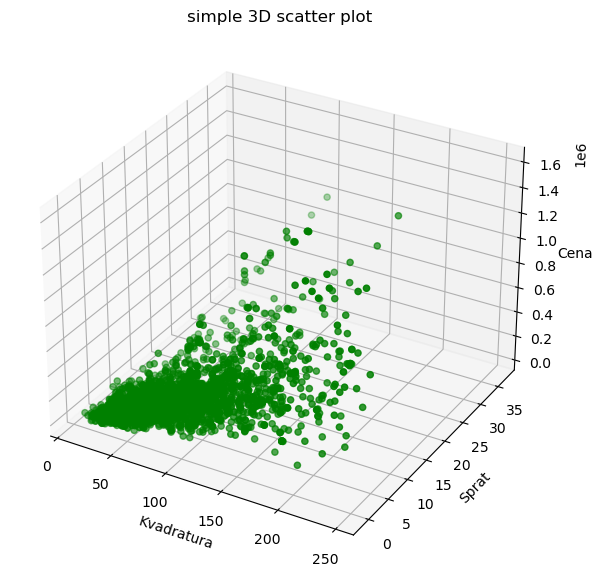

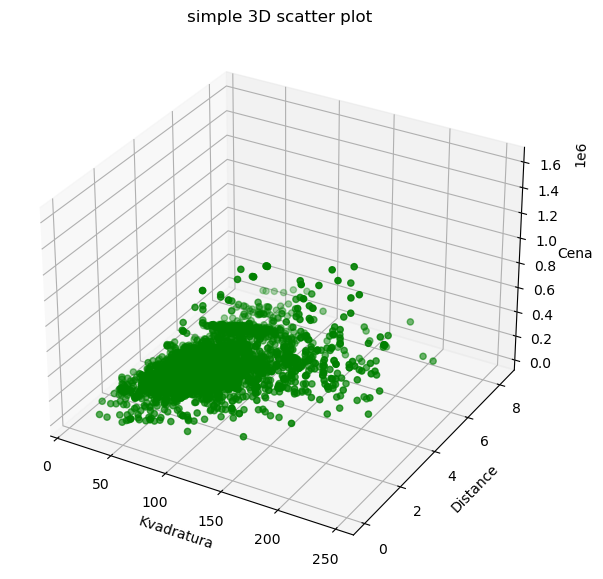

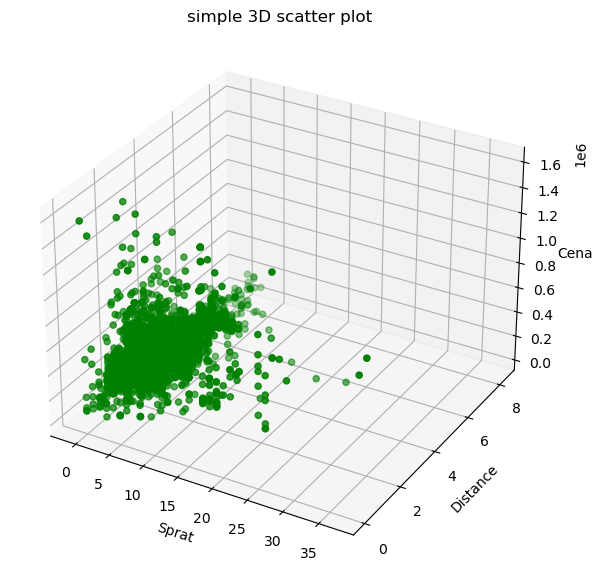

In [16]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 

ax.scatter3D(df['Kvadratura'], df['Sprat'], df['Cena'], color = "green")
plt.title("simple 3D scatter plot")

ax.set_xlabel('Kvadratura')
ax.set_ylabel('Sprat')
ax.set_zlabel('Cena')
 

plt.show()

fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 

ax.scatter3D(df['Kvadratura'], df['Distance'], df['Cena'], color = "green")
plt.title("simple 3D scatter plot")

ax.set_xlabel('Kvadratura')
ax.set_ylabel('Distance')
ax.set_zlabel('Cena')
 

plt.show()

fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 

ax.scatter3D(df['Sprat'], df['Distance'], df['Cena'], color = "green")
plt.title("simple 3D scatter plot")

ax.set_xlabel('Sprat')
ax.set_ylabel('Distance')
ax.set_zlabel('Cena')
 

plt.show()

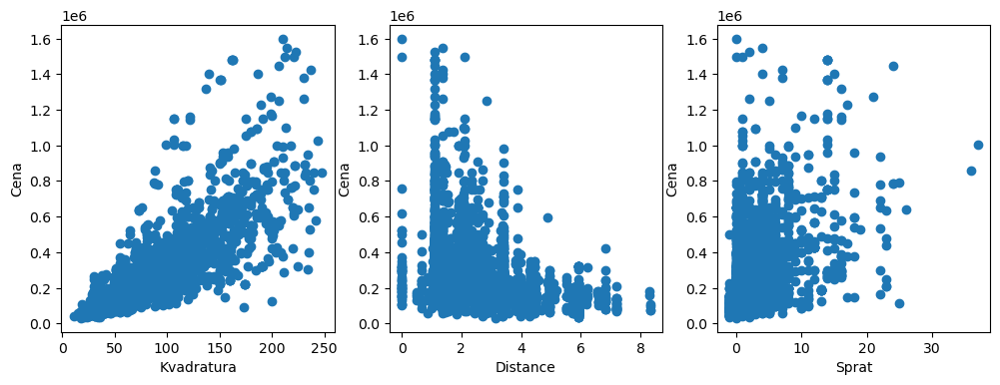

In [17]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12,4))
axes[0].scatter(df['Kvadratura'], df['Cena'])
axes[0].set_xlabel('Kvadratura')
axes[0].set_ylabel('Cena')
axes[1].scatter(df['Distance'], df['Cena'])
axes[1].set_xlabel('Distance')
axes[1].set_ylabel('Cena')
axes[2].scatter(df['Sprat'], df['Cena'])
axes[2].set_xlabel('Sprat')
axes[2].set_ylabel('Cena')

plt.show()

In [28]:
##LINEARNA REGRESIJA
import ipywidgets as widgets
from IPython.display import display



inputKvadratura = widgets.FloatText(description='Kvadratura:')
inputSprat = widgets.FloatText(description='Sprat:')
inputDistance = widgets.FloatText(description='Udaljenost od centra:')
outputResult2 = widgets.FloatText(description='Rezultat:', disabled=True)
# inputParking = widgets.Checkbox(description='Parking:')
# inputLift = widgets.Checkbox(description='Lift:')

button = widgets.Button(description='Run Regression')


def on_button_click(b):
  
    kvadratura = inputKvadratura.value
    sprat=inputSprat.value
    distance=inputDistance.value
    #boolParking = inputParking.value
    #parking=0
    #if boolParking:parking=1
    #boolLift=inputLift.value
    #lift=0
    #if boolLift:lift=1
   
  
  
    matricaAtributa=np.array([])
    matricaAtributa =np.append(matricaAtributa,[kvadratura,sprat,distance])
    matricaAtributa=matricaAtributa.reshape(1,-1)
    matricaAtributa=scaler.transform(matricaAtributa)
#     distance=matricaAtributa[0][2]
    x = np.array([1, matricaAtributa[0][0],matricaAtributa[0][1], matricaAtributa[0][2]])

    outputResult2.value=x@w
    


button.on_click(on_button_click)


display(inputKvadratura,inputDistance,inputSprat, button,outputResult2)

FloatText(value=0.0, description='Kvadratura:')

FloatText(value=0.0, description='Udaljenost od centra:')

FloatText(value=0.0, description='Sprat:')

Button(description='Run Regression', style=ButtonStyle())

FloatText(value=0.0, description='Rezultat:', disabled=True)

In [19]:
#KNN
dfKnn=pd.read_csv('KNN_regresija.csv')
dfKnn=dfKnn.dropna(subset=['Distance'])
dfKnn = dfKnn.reset_index()

# Set a new index starting from 1
dfKnn['index'] = range(1, len(dfKnn) + 1)
dfKnn = dfKnn.set_index('index')

bins = [-float('inf'),49999, 99999, 149999, 199999,2499999 ,float('inf')]
labels = ['do 50k', '50k-100k', '100k-150k', '150k-200k','200k-500k','od 500k']

# Add a new column with categorized values
dfKnn['Cenovni_rang'] = pd.cut(dfKnn['Cena'], bins=bins, labels=labels)


In [20]:
dfKnnFilter=dfKnn[['Cenovni_rang','Kvadratura','Sprat','Distance','Uknjizeno','Ukupan broj soba']]
dfKnnFilter.describe()

,Kvadratura,Sprat,Distance,Uknjizeno,Ukupan broj soba
count,3600.000000,3600.000000,3600.000000,3600.000000,3600.000000
mean,83.267500,3.116944,3.004881,0.731111,2.926667
std,40.208623,3.511968,1.714316,0.443444,1.076362
min,11.000000,-1.000000,0.000000,0.000000,1.000000
25%,55.000000,1.000000,1.548842,0.000000,2.000000
50%,74.000000,2.000000,2.534946,1.000000,3.000000
75%,103.000000,4.000000,3.993262,1.000000,4.000000
max,248.000000,37.000000,8.326576,1.000000,6.000000


In [21]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import math

def doKnn(n,Metric):
    
    X = dfKnnFilter.values[:, 1:]
    k=int(math.sqrt(X.shape[0]))
    if (n!=0):
        k=int(n)
    y = dfKnnFilter['Cenovni_rang'].values.reshape(-1, 1)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=45)


    knn = KNeighborsClassifier(n_neighbors=k,metric=Metric)
    # int(math.sqrt(X.shape[0])

    knn.fit(X_train, y_train)


    y_pred = knn.predict(X_test)


    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy:", accuracy)
    print(Metric)
    return knn


In [29]:
##KNN
import ipywidgets as widgets
from IPython.display import display



inputKvadratura = widgets.FloatText(description='Kvadratura:')
inputSprat = widgets.FloatText(description='Sprat:')
inputDistance = widgets.FloatText(description='Udaljenost od centra:')


inputBrojSoba = widgets.FloatText(description='Broj soba:')
inputUknjizen = widgets.Checkbox(description='Uknjizen:')
inputK = widgets.FloatText(description='K:')
inputMetrika = widgets.Checkbox(description='Euklidska/Menhetn:')
button = widgets.Button(description='Run Regression')
outputResult = widgets.Label(description='Rezultat:', disabled=True,value='Rezultat')


def on_button_click(b):
  
    kvadratura = inputKvadratura.value
    sprat=inputSprat.value
    distance=inputDistance.value
    boolUknjizen = inputUknjizen.value
    uknjizen=0
    if boolUknjizen:uknjizen=1
    broj_soba=inputBrojSoba.value
    k=inputK.value
    metrika=inputMetrika.value
  
#     print(str(kvadratura)+" "+str(distance)+" "+str(sprat)+" "+str(broj_soba)+" "+str(uknjizen))
#     matricaAtributa=np.array([])
#     matricaAtributa =np.append(matricaAtributa,[kvadratura,sprat,distance])
#     matricaAtributa=matricaAtributa.reshape(1,-1)
    x=np.append(np.array([]),[kvadratura,sprat,distance,uknjizen,broj_soba])
    x=x.reshape(1,-1)
#     distance=matricaAtributa[0][2]
#     x= np.append([1],[matricaAtributa[0][0],matricaAtributa[0][1]])
    Metrika='manhattan'
    if (metrika):
        Metrika='euclidean'
    result=doKnn(k,Metrika).predict(x)
    
    
    outputResult.value = str(result[0])
#     x=np.append(x,distance)
#     print(x)
#     print(x@w)


button.on_click(on_button_click)


display(inputKvadratura,inputDistance,inputSprat,inputBrojSoba,inputUknjizen,inputK,inputMetrika, button,outputResult)

FloatText(value=0.0, description='Kvadratura:')

FloatText(value=0.0, description='Udaljenost od centra:')

FloatText(value=0.0, description='Sprat:')

FloatText(value=0.0, description='Broj soba:')

Checkbox(value=False, description='Uknjizen:')

FloatText(value=0.0, description='K:')

Checkbox(value=False, description='Euklidska/Menhetn:')

Button(description='Run Regression', style=ButtonStyle())

Label(value='Rezultat', description='Rezultat:')

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

Accuracy: 0.7425925925925926
manhattan


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this b

,Kvadratura,Sprat,Distance
index,,,
1,131,2,2.435849
2,44,0,3.569525
3,47,2,5.929167
4,81,7,6.585050
5,58,2,1.913857
...,...,...,...
3596,67,1,2.620670
3597,75,6,2.320571
3598,80,4,2.326402


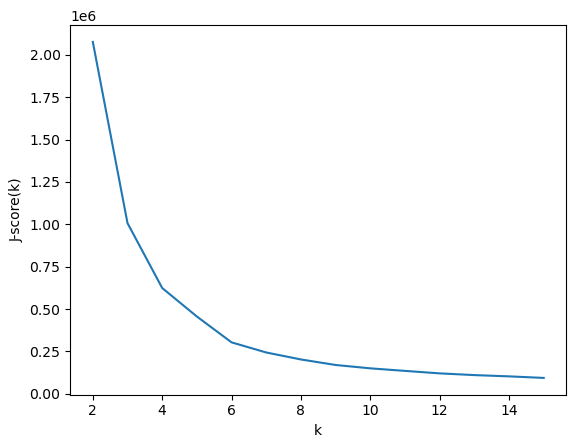

Cluster Labels:
[4 3 3 ... 0 0 0]

Cluster Centers:
[[ 83.46659708   3.22442589   2.5989408 ]
 [203.1119403    4.21641791   2.23306252]
 [154.32945736   4.5503876    2.26904117]
 [ 37.37954939   1.76083189   3.75627396]
 [113.33562823   4.10499139   2.30335271]
 [ 59.84615385   2.73992674   3.60579184]]


In [23]:
from sklearn.cluster import KMeans
import numpy as np
import plotly.express as px
dfKM=dfKnnFilter.copy()

dfKM.drop('Cenovni_rang',axis=1,inplace=True)
dfKM.drop('Uknjizeno',axis=1,inplace=True)
dfKM.drop('Ukupan broj soba',axis=1,inplace=True)
display(dfKM)
np.random.seed(0)

j_score = []
for i in range(2, 16):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(dfKM)
    j_score.append(kmeans.inertia_)

plt.plot(np.arange(len(j_score))+2, j_score)
plt.xlabel('k')
plt.ylabel('J-score(k)')
plt.savefig('slika.jpg')
plt.show()


kmeans = KMeans(n_clusters=6)
kmeans.fit(dfKM)
labels = kmeans.labels_

centers = kmeans.cluster_centers_

print("Cluster Labels:")
print(labels)
print("\nCluster Centers:")
print(centers)


dfKM['Cluster'] = labels


fig = px.scatter_3d(dfKM, x='Kvadratura', y='Sprat', z='Distance', color='Cluster')


fig.add_scatter3d(x=centers[:, 0], y=centers[:, 1], z=centers[:, 2], mode='markers', marker=dict(color='red', size=8), name='Cluster Centers')


fig.update_layout(title='K-means Clustering - 3D Scatter Plot')
fig.show()



